In [1]:
from bayes_opt import BayesianOptimization
from bayes_opt.util import UtilityFunction
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib import mlab
from matplotlib import gridspec
%matplotlib inline

In [2]:
#challenge import
from netsapi.challenge import *
 
from sys import exit, exc_info, argv
from multiprocessing import Pool, current_process
import random as rand
import json
import requests
import numpy as np
import pandas as pd


import statistics
from IPython.display import clear_output

from contextlib import contextmanager
import sys, os
@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:  
            yield
        finally:
            sys.stdout = old_stdout

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
print("done")

done


In [3]:
envSeqDec = ChallengeSeqDecEnvironment()
x_start = 0.0
x_end = 1.0

VAL_Max = 1.2 # fel heat map

def target1(x, y):
    x = np.asscalar(x)
    y = np.asscalar(y)
    envSeqDec.reset()
    action = [x , y]
    print("action",action)
    s,r,d,_ = envSeqDec.evaluateAction(action)
    return r/90.0    

def target(x,y):
    if type(x) is np.ndarray:
        result = []
        for a,b in zip(x,y):
            reward = target1(a,b)
            result.append( reward )
            print((len(result) % 30 ) )
            if ((len(result) % 30 ) > 25) : 
                global envSeqDec
                envSeqDec = ChallengeSeqDecEnvironment()
        return result
    else:
        return target1(x,y)


In [4]:
# for the training
n = 1e5
x = y = np.linspace(x_start, x_end, 300)# was 300
X, Y = np.meshgrid(x, y)
x = X.ravel()
y = Y.ravel()
X = np.vstack([x, y]).T[:, [1, 0]]
#z = target(x, y)




In [5]:


def posterior(bo, X):
    #ur = unique_rows(bo.X)
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    y_obs = np.array([res["target"] for res in bo.res])
    #print("x_obs",x_obs)
    #print("y_obs",y_obs)
    
    bo._gp.fit(x_obs, y_obs)
    #print(bo._gp)
    
    mu, sigma = bo._gp.predict(X, return_std=True)
    #mu, sigma2 = bo._gp.predict(X[:2,:])
    #print("X[:2,:]",X[:2,:])
    #print("x_obs",x_obs)
    #mu, sigma2 = bo._gp.predict(x_obs)
    #print("mu",mu)
    #print("sigma2",sigma2)
    ##mu, sigma2 = bo._gp.predict(X) # eval_MSE=True
    
    #uf = UtilityFunction(kind='ucb', kappa=10, xi=1.0) # xi=1.0 zetha ena w 3andha 7ata ma3na
    
    #print("sqrt",np.sqrt(sigma2))
    
    #return mu, np.sqrt(sigma2), uf.utility(X, bo._gp, y_obs.max())
    return mu, sigma

def plot_2d(name=None):

    #mu, s, ut = posterior(bo, X)
    mu, s = posterior(bo, X)

    fig, ax = plt.subplots(2, 2, figsize=(14, 10))
    gridsize=150

    # fig.suptitle('Bayesian Optimization in Action', fontdict={'size':30})
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    # GP regression output
    ax[0][0].set_title('Gausian Process Predicted Mean', fontdict={'size':15})
    im00 = ax[0][0].hexbin(x, y, C=mu, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][0].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][0].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k', label='Observations')
    ax[0][0].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k', label='Observations')

    ax[0][1].set_title('Target Function', fontdict={'size':15})
    """
    im10 = ax[0][1].hexbin(x, y, C=z, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][1].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][1].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k')
    ax[0][1].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k')
    """

    ax[1][0].set_title('Gausian Process Variance', fontdict={'size':15})
    im01 = ax[1][0].hexbin(x, y, C=s, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=1)
    ax[1][0].axis([x.min(), x.max(), y.min(), y.max()])

    ax[1][1].set_title('Acquisition Function', fontdict={'size':15})
    # acquisition func
    """
    im11 = ax[1][1].hexbin(x, y, C=ut, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=8)

    np.where(ut.reshape((300, 300)) == ut.max())[0]
    np.where(ut.reshape((300, 300)) == ut.max())[1]

    ax[1][1].plot([np.where(ut.reshape((300, 300)) == ut.max())[1]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[1]/50.], 
                  [0, 6], 
                  'k-', lw=2, color='k')

    ax[1][1].plot([0, 6],
                  [np.where(ut.reshape((300, 300)) == ut.max())[0]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[0]/50.], 
                  'k-', lw=2, color='k')

    ax[1][1].axis([x.min(), x.max(), y.min(), y.max()])
    """
    for im, axis in zip([im00, im01], ax.flatten()):#, im10, im11
        cb = fig.colorbar(im, ax=axis)
        # cb.set_label('Value')

    if name is None:
        name = '_'

    plt.tight_layout()

    # Save or show figure?
    # fig.savefig('bo_eg_' + name + '.png')
    plt.show()
    plt.close(fig)


|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8106489265144878, 0.6305125802703989]
105  Evaluations Remaining
|  1        |  0.02591  |  0.8106   |  0.6305   |
action [0.7331925634311224, 0.3133069442608163]
104  Evaluations Remaining
|  2        |  0.2158   |  0.7332   |  0.3133   |
action [0.8955261360141487, 0.7739771709802519]
103  Evaluations Remaining
|  3        | -0.9924   |  0.8955   |  0.774    |
action [0.4293458838452382, 0.9971488755912503]
102  Evaluations Remaining
|  4        |  0.3821   |  0.4293   |  0.9971   |
action [0.14719669192009488, 0.1675283120043951]
101  Evaluations Remaining
|  5        |  0.03087  |  0.1472   |  0.1675   |


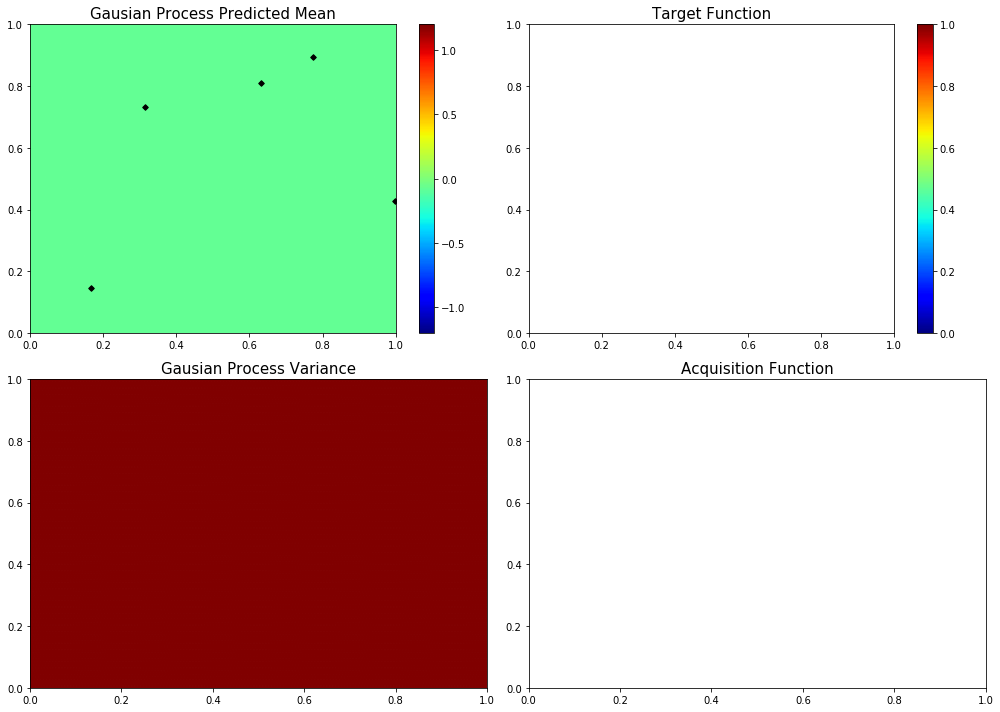

In [6]:


bo = BayesianOptimization(target, {'x': (x_start, x_end), 'y': (x_start, x_end)})

used_kappa = 5

#gp_params = {'corr': 'absolute_exponential', 'nugget': 1e-9}
bo.maximize(init_points=5, n_iter=0, acq='ucb', kappa=used_kappa, )

plot_2d()

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.12971050523513783, 0.6037509048810088]
100  Evaluations Remaining
|  6        |  0.2845   |  0.1297   |  0.6038   |
myplot:  006


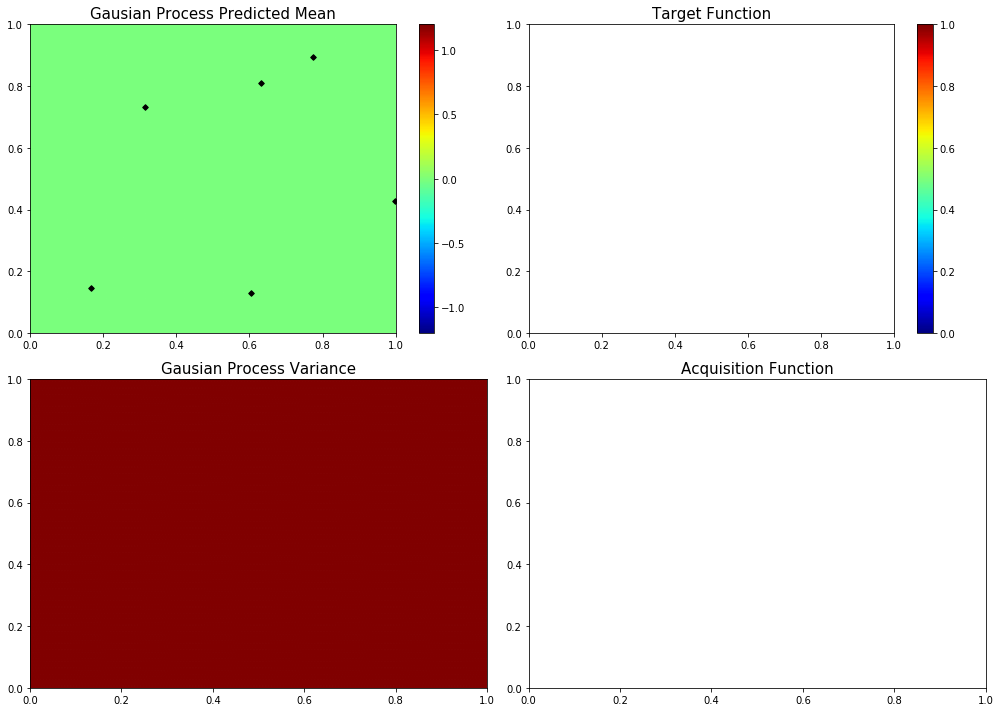

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5629502610578877, 0.2505756716962364]
99  Evaluations Remaining
|  7        |  0.1985   |  0.563    |  0.2506   |
myplot:  007


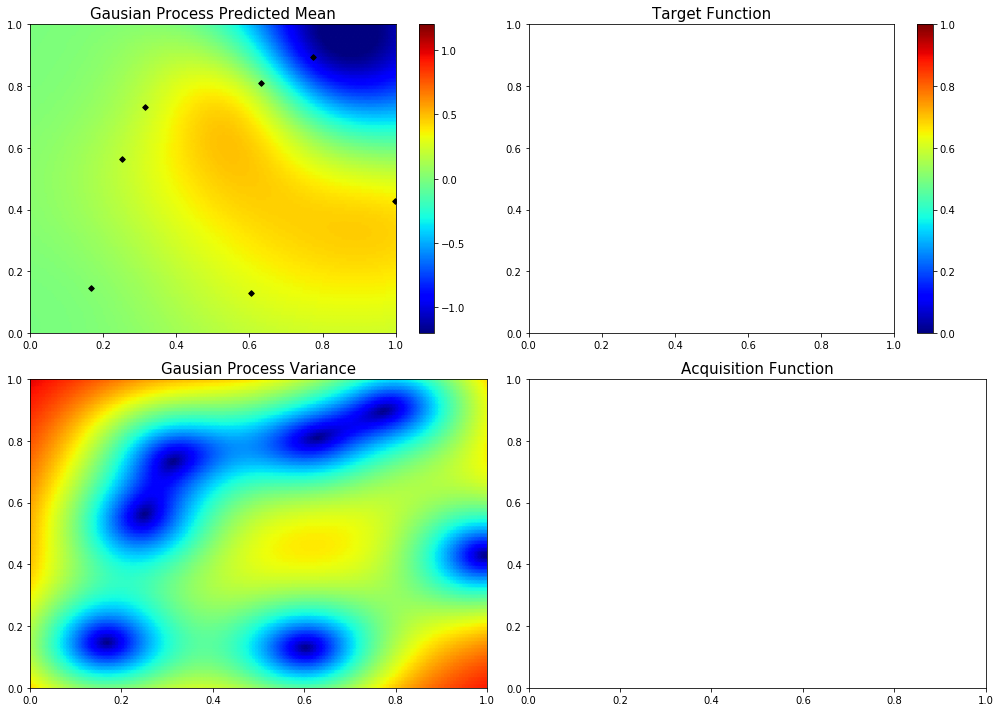

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 1.0]
98  Evaluations Remaining
|  8        |  1.23     |  0.0      |  1.0      |
myplot:  008


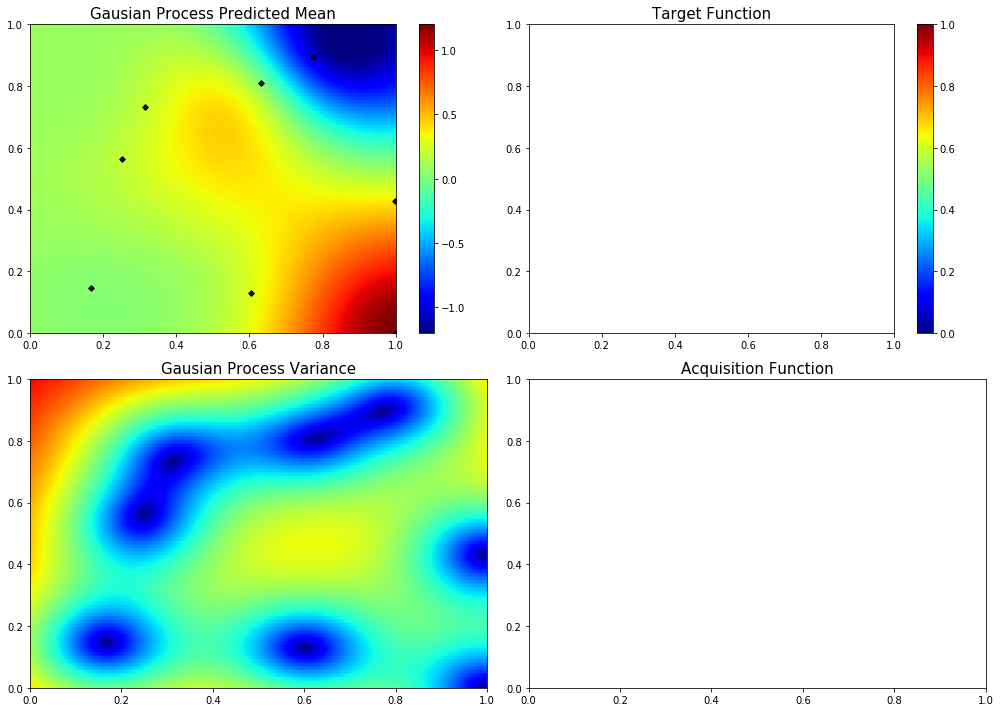

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.0]
97  Evaluations Remaining
|  9        |  1.044    |  1.0      |  0.0      |
myplot:  009


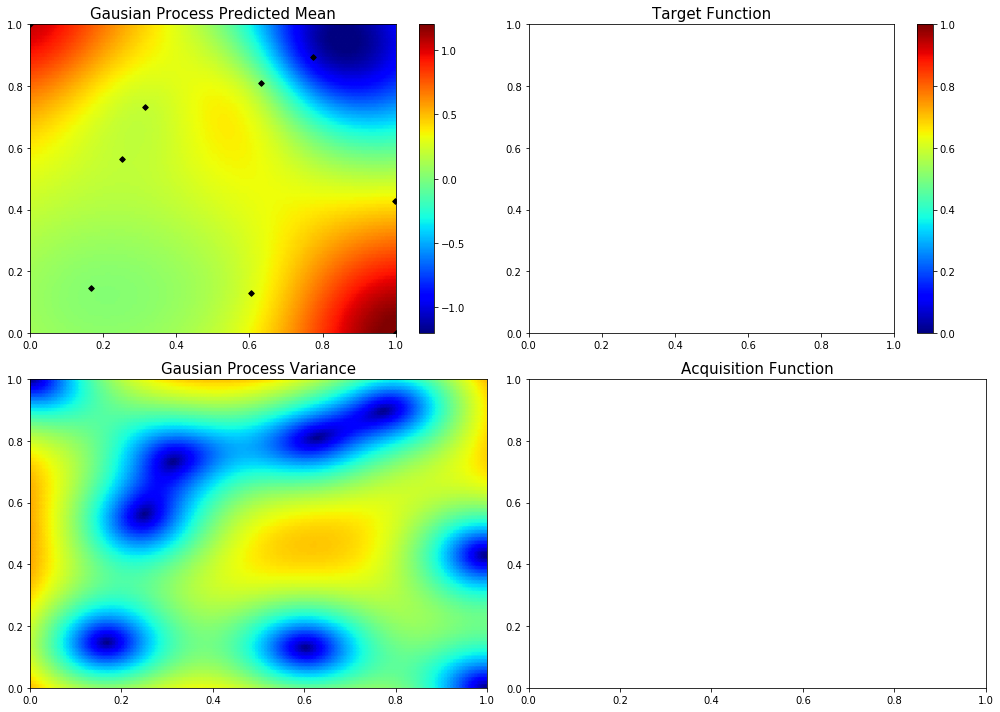

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6635523208746781, 0.0]
96  Evaluations Remaining
|  10       |  0.485    |  0.6636   |  0.0      |
myplot:  010


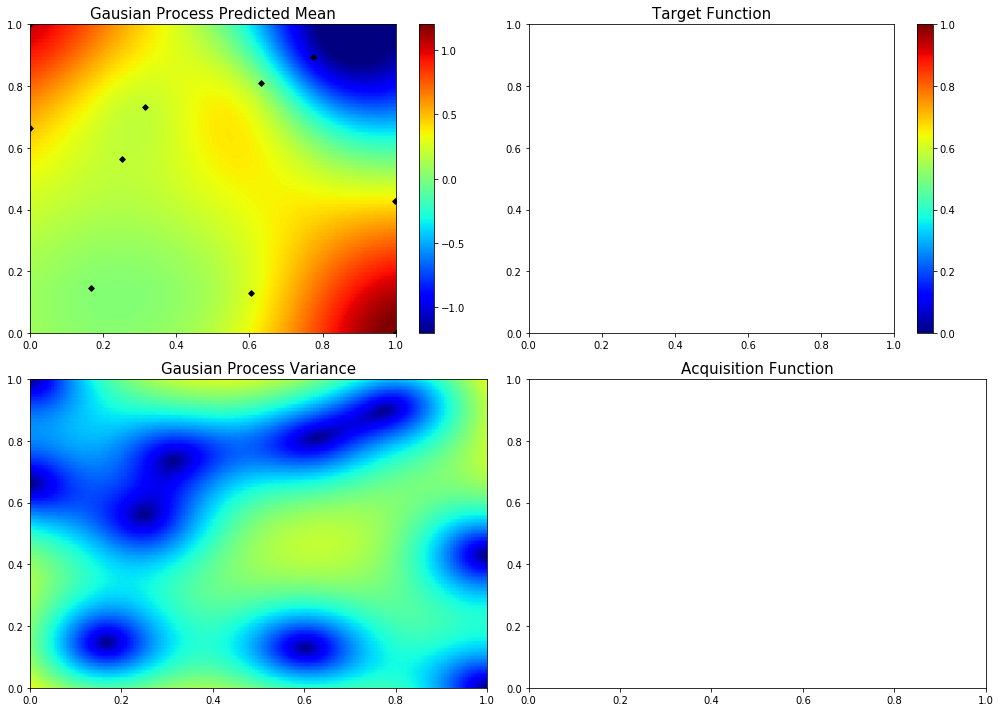

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.34925450440403366]
95  Evaluations Remaining
|  11       |  0.6124   |  1.0      |  0.3493   |
myplot:  011


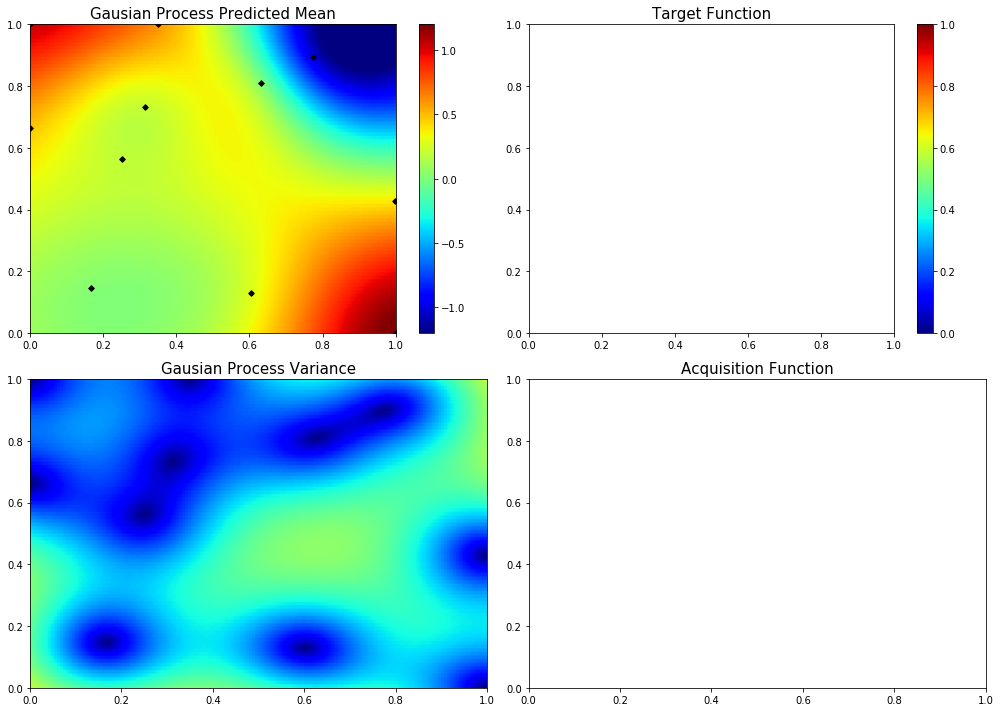

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.0]
94  Evaluations Remaining
|  12       |  0.03228  |  0.0      |  0.0      |
myplot:  012


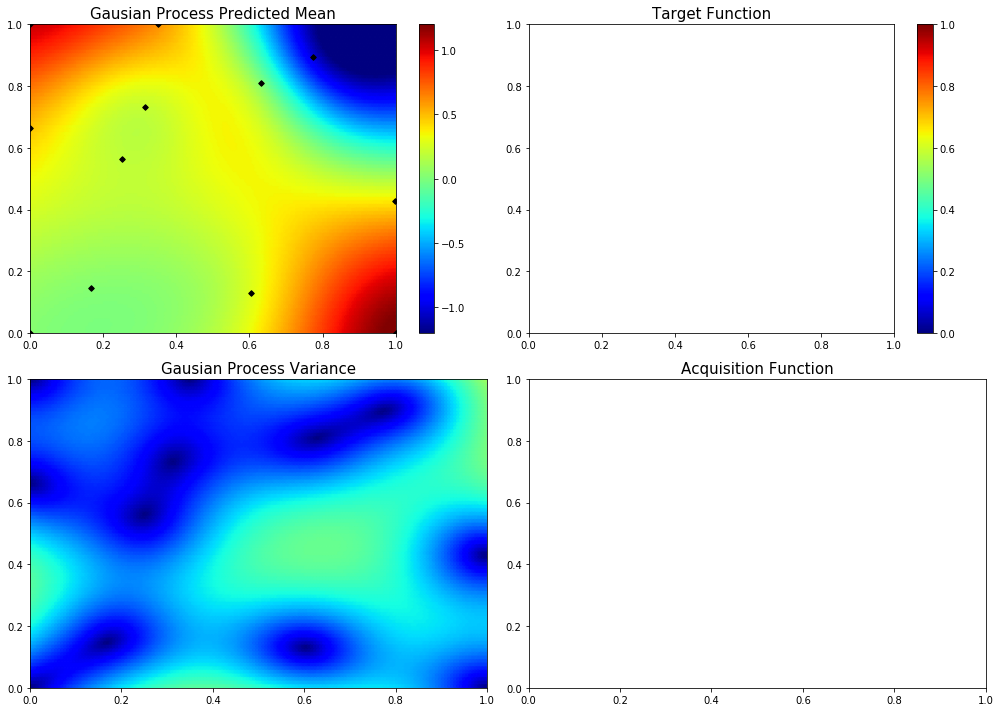

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.45222054665359174, 0.644826962834656]
93  Evaluations Remaining
|  13       |  0.02601  |  0.4522   |  0.6448   |
myplot:  013


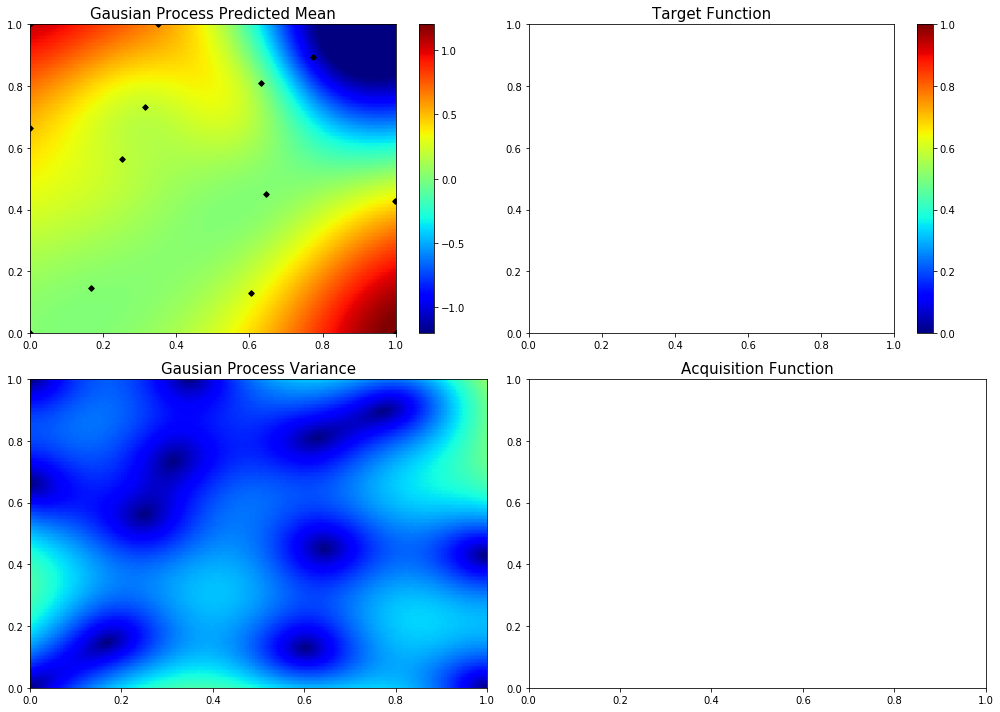

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.18653039244748137, 1.0]
92  Evaluations Remaining
|  14       |  0.7449   |  0.1865   |  1.0      |
myplot:  014


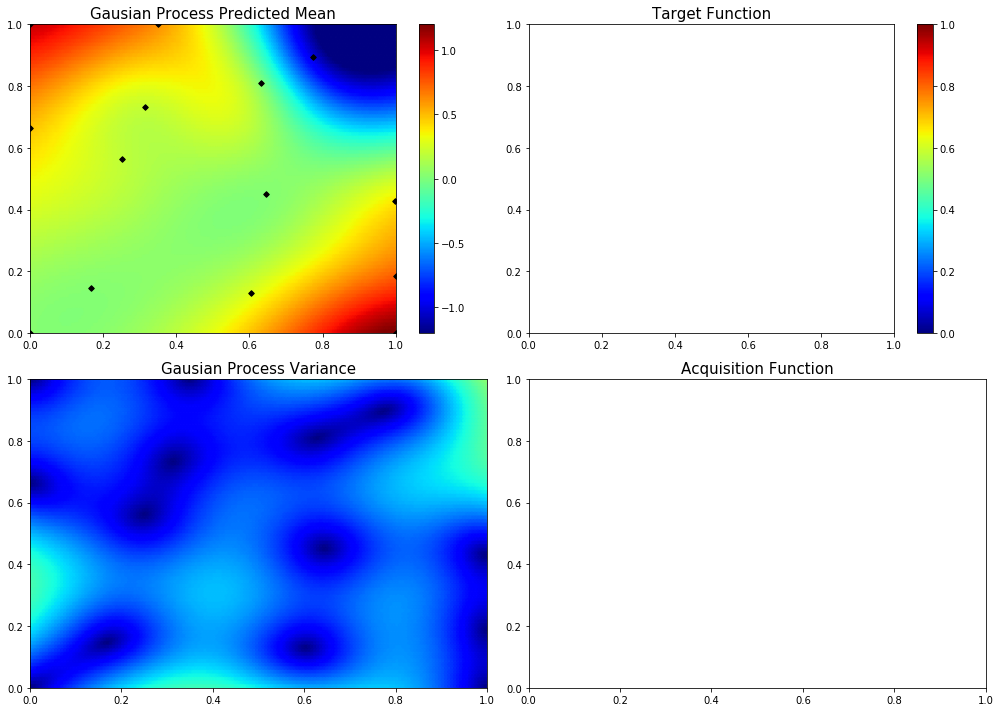

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.8025076848486828]
91  Evaluations Remaining
|  15       |  1.344    |  0.0      |  0.8025   |
myplot:  015


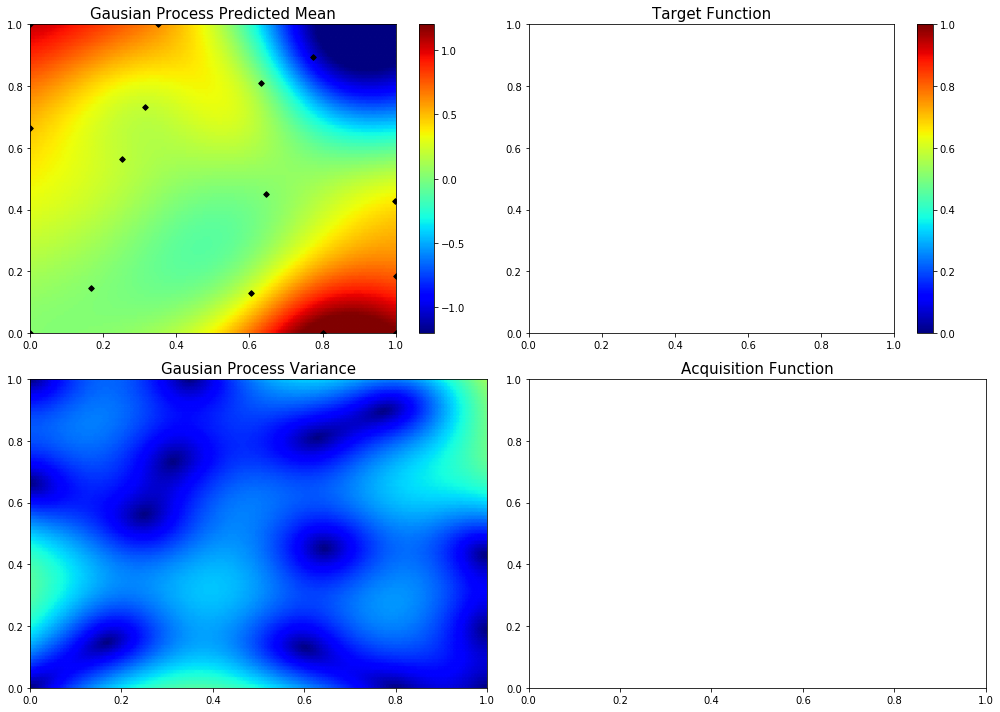

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3508703920027919, 0.0]
90  Evaluations Remaining
|  16       |  0.1024   |  0.3509   |  0.0      |
myplot:  016


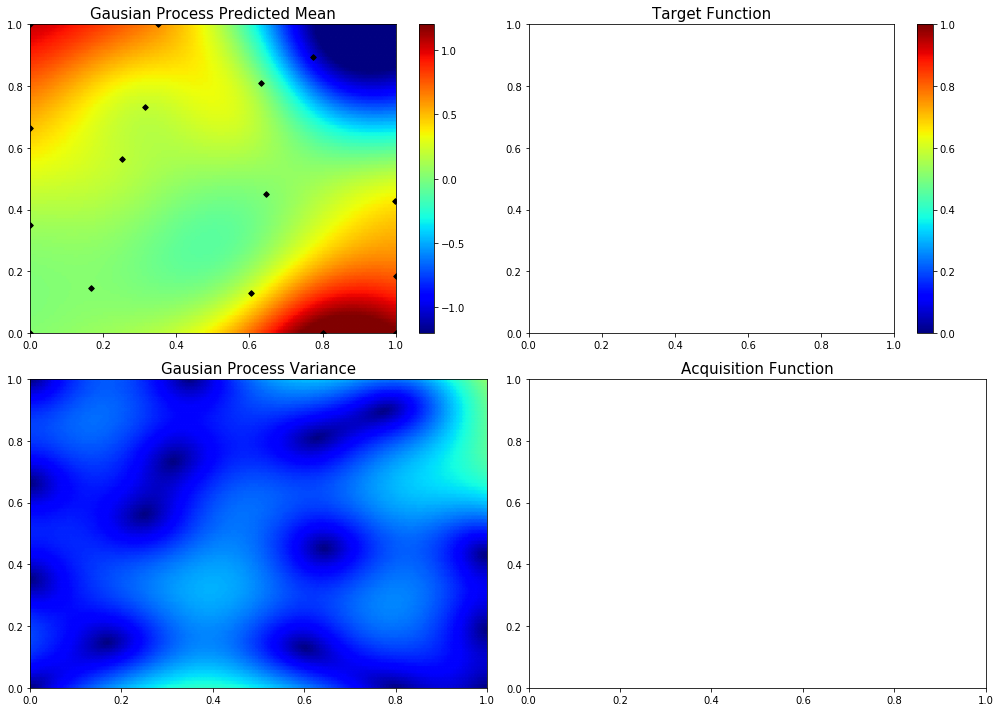

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.414368700525368]
89  Evaluations Remaining
|  17       |  0.2021   |  0.0      |  0.4144   |
myplot:  017


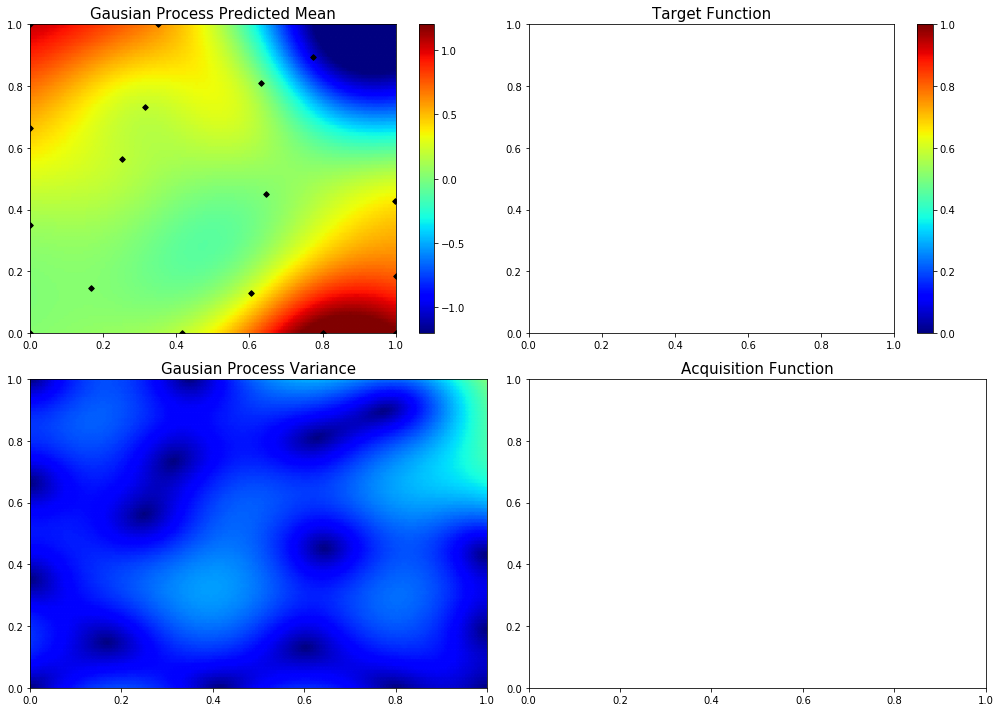

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.15142471445413005]
88  Evaluations Remaining
|  18       | -0.03229  |  1.0      |  0.1514   |
myplot:  018


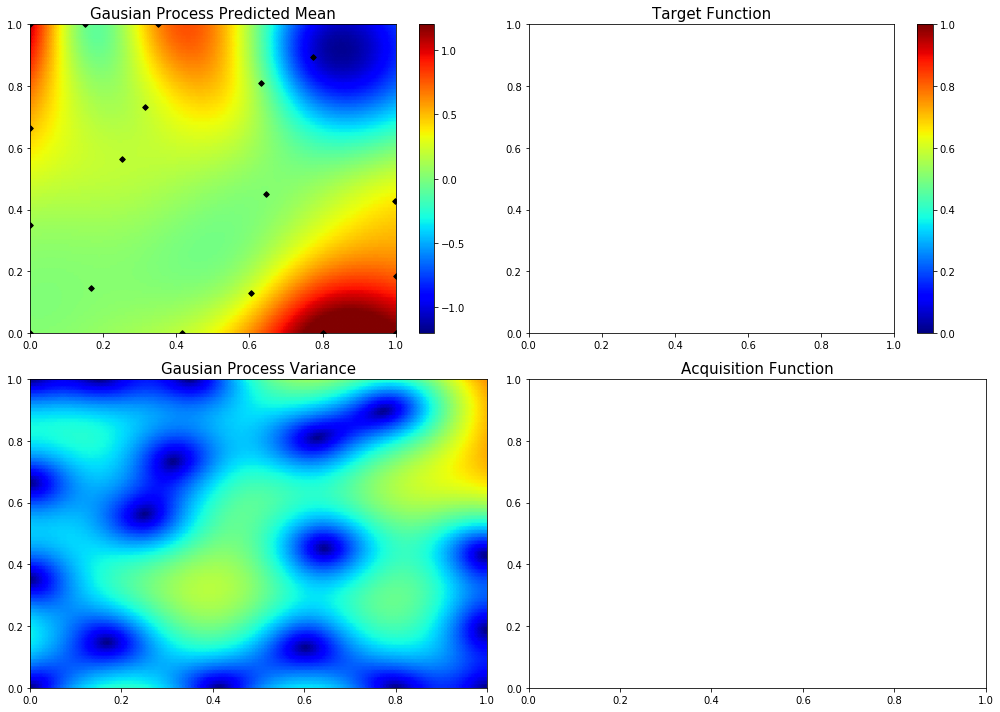

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7024041253904258, 1.0]
87  Evaluations Remaining
|  19       |  0.104    |  0.7024   |  1.0      |
myplot:  019


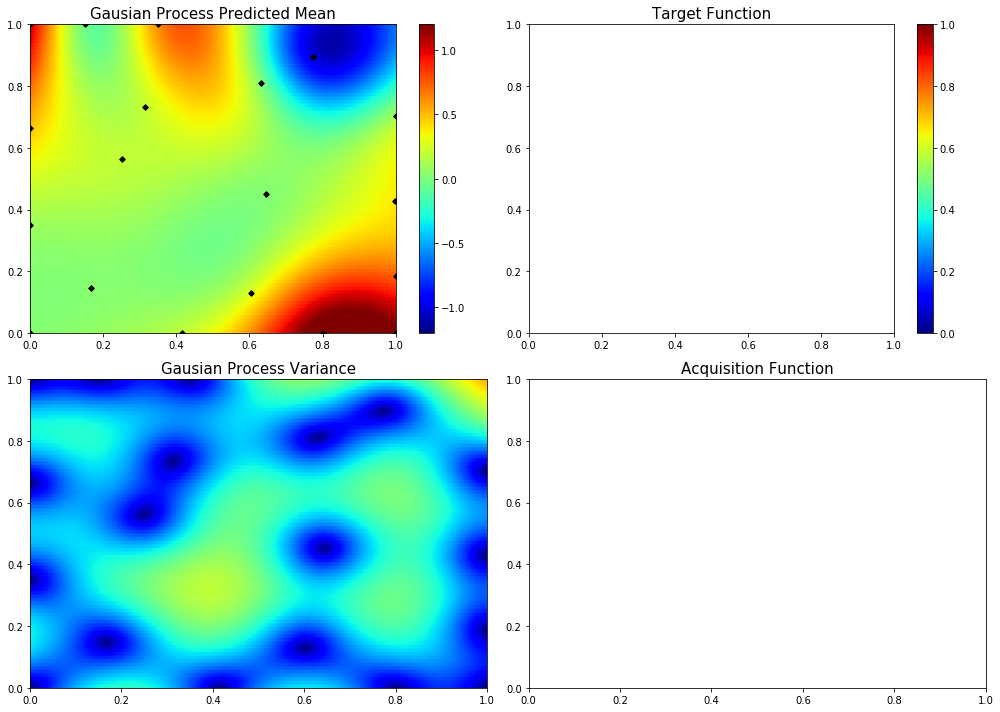

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 1.0]
86  Evaluations Remaining
|  20       |  0.1697   |  1.0      |  1.0      |
myplot:  020


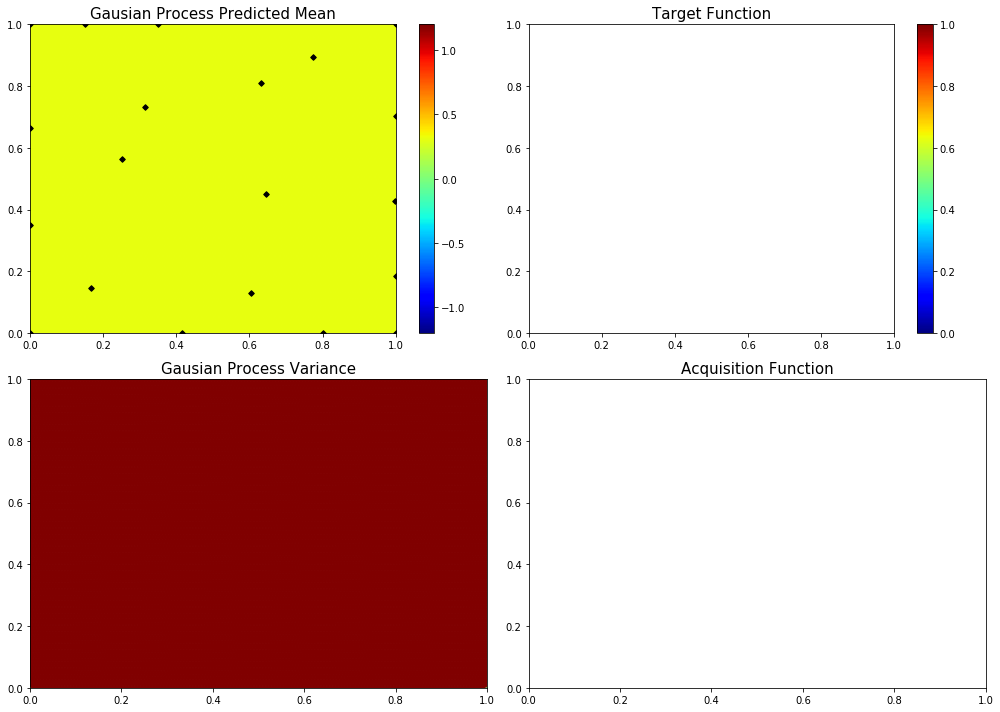

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3284249099371248, 0.3868101742120382]
85  Evaluations Remaining
|  21       |  0.3525   |  0.3284   |  0.3868   |
myplot:  021


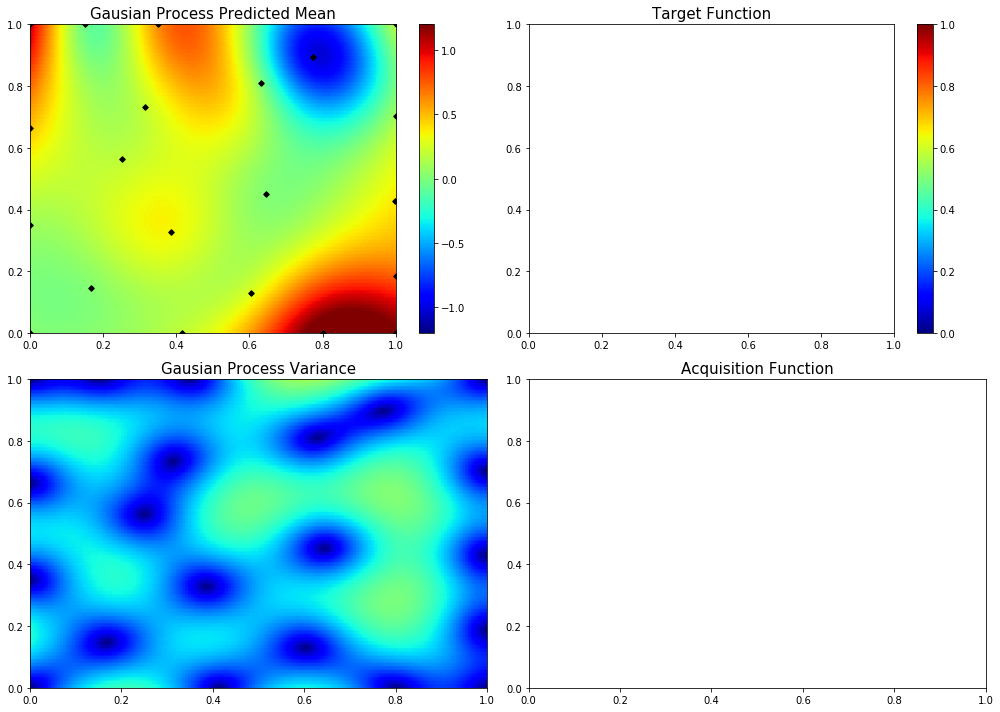

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.5424665876564886]
84  Evaluations Remaining
|  22       |  0.5051   |  1.0      |  0.5425   |
myplot:  022


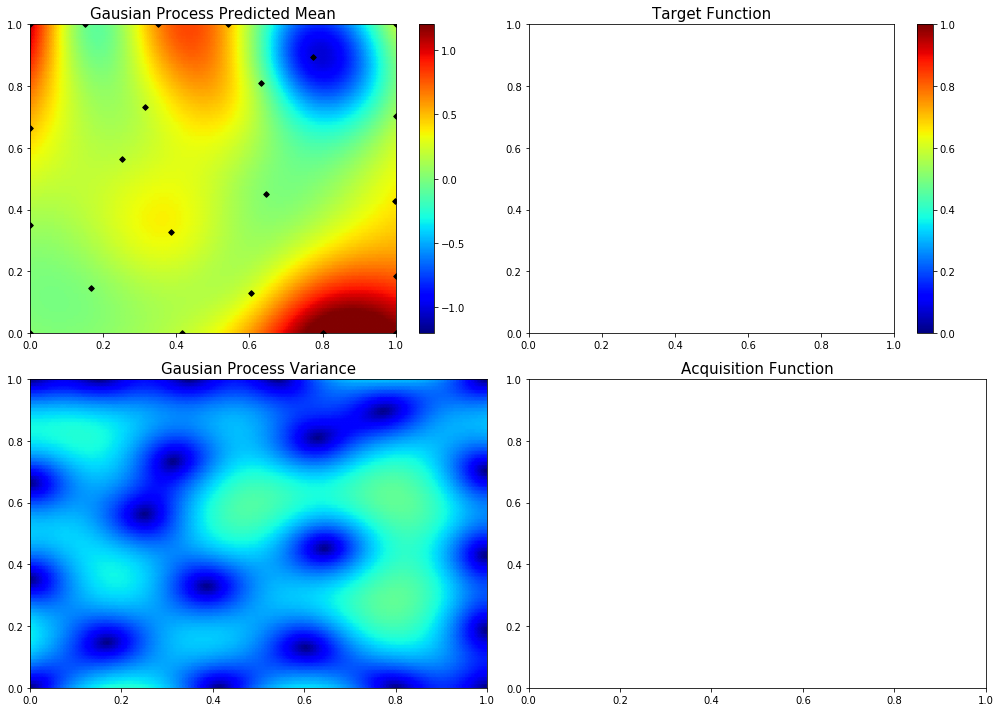

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.21462892286979726, 0.8143692938486379]
83  Evaluations Remaining
|  23       |  0.004369 |  0.2146   |  0.8144   |
myplot:  023


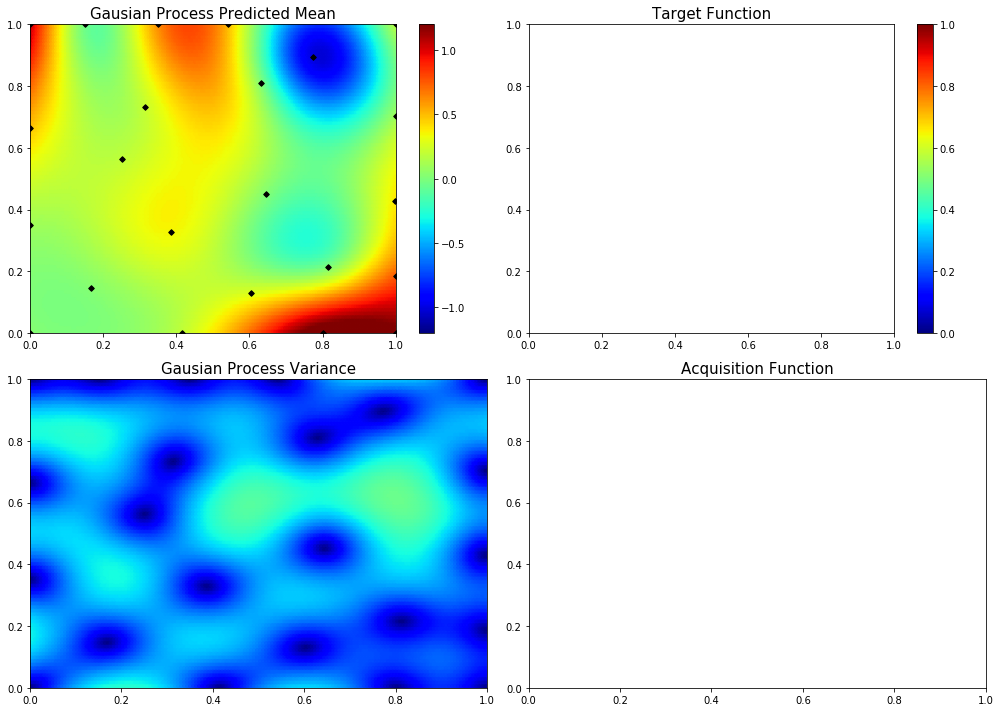

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8486992563323793, 0.0]
82  Evaluations Remaining
|  24       |  0.8063   |  0.8487   |  0.0      |
myplot:  024


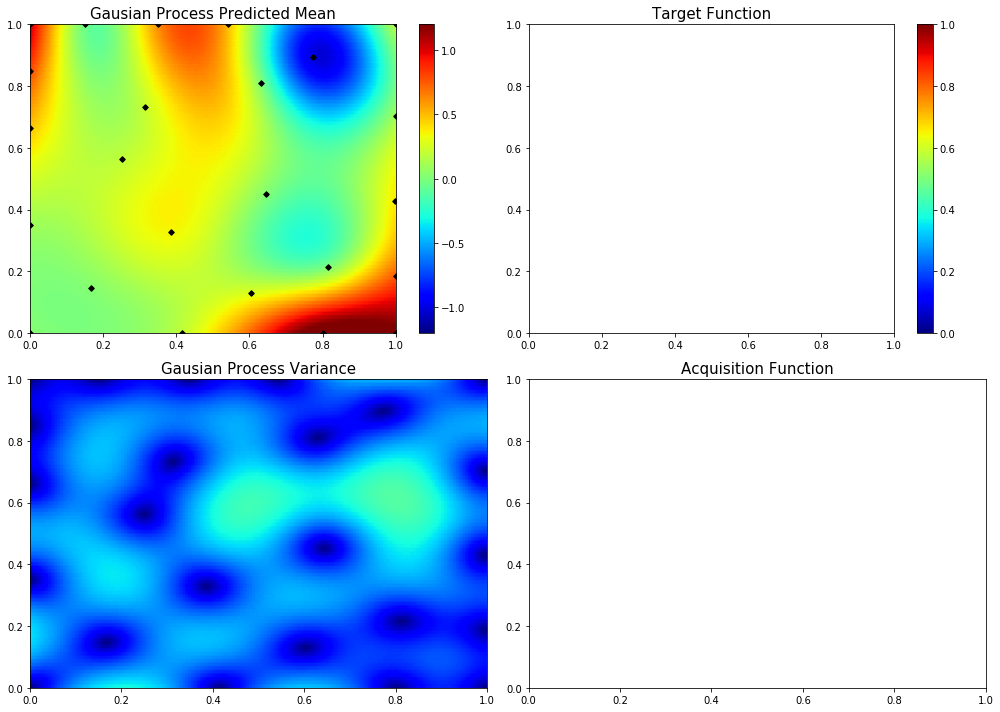

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6024561966033146, 0.4835485177437805]
81  Evaluations Remaining
|  25       |  0.0363   |  0.6025   |  0.4835   |
myplot:  025


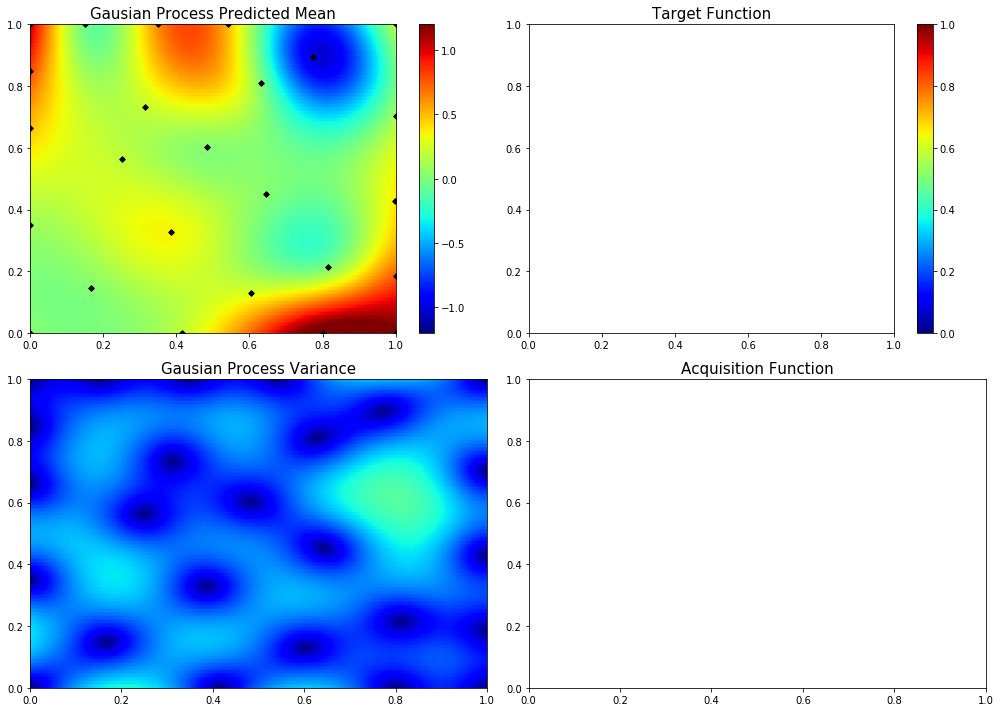

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.6499627744284325]
80  Evaluations Remaining
|  26       |  0.506    |  0.0      |  0.65     |
myplot:  026


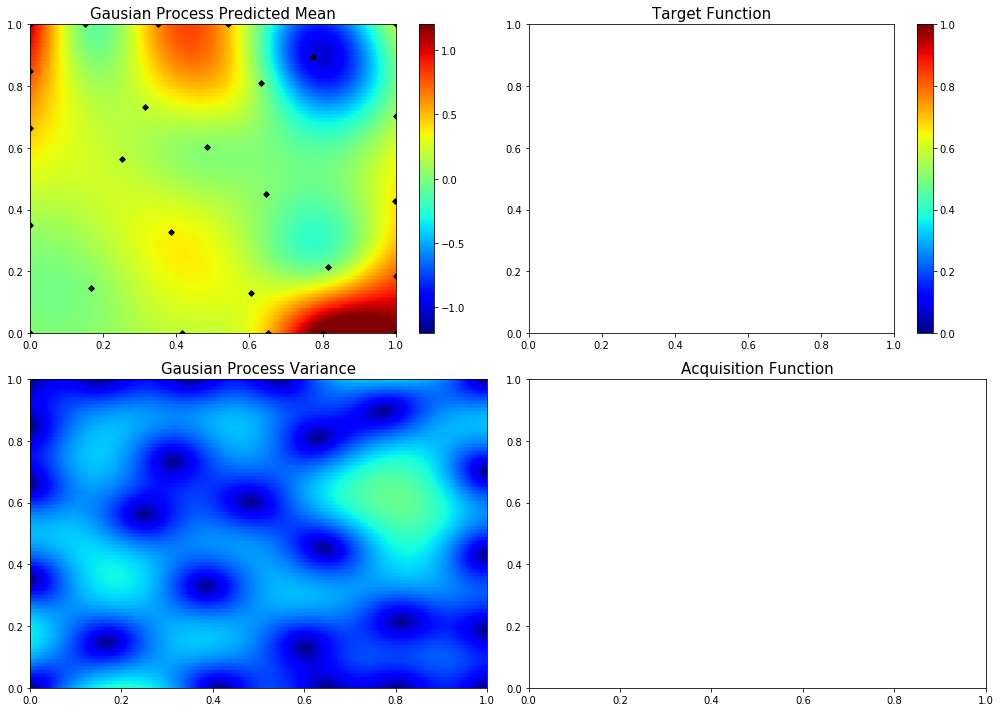

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5853946216850289, 0.8146513298921871]
79  Evaluations Remaining
|  27       |  0.4966   |  0.5854   |  0.8147   |
myplot:  027


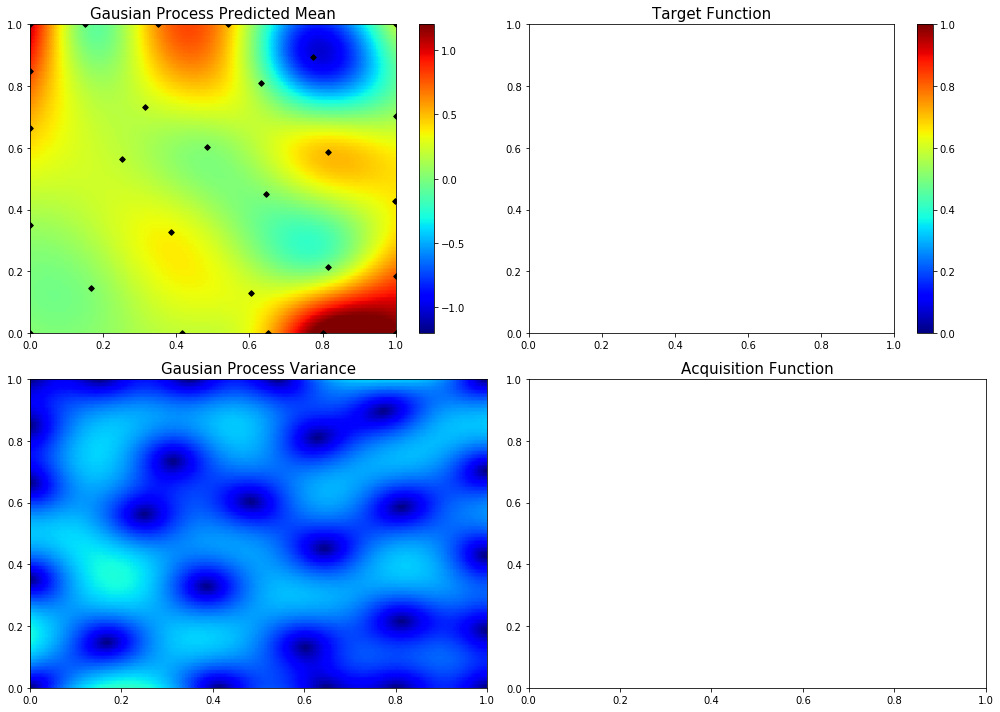

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.9013817304957359]
78  Evaluations Remaining
|  28       |  1.052    |  0.0      |  0.9014   |
myplot:  028


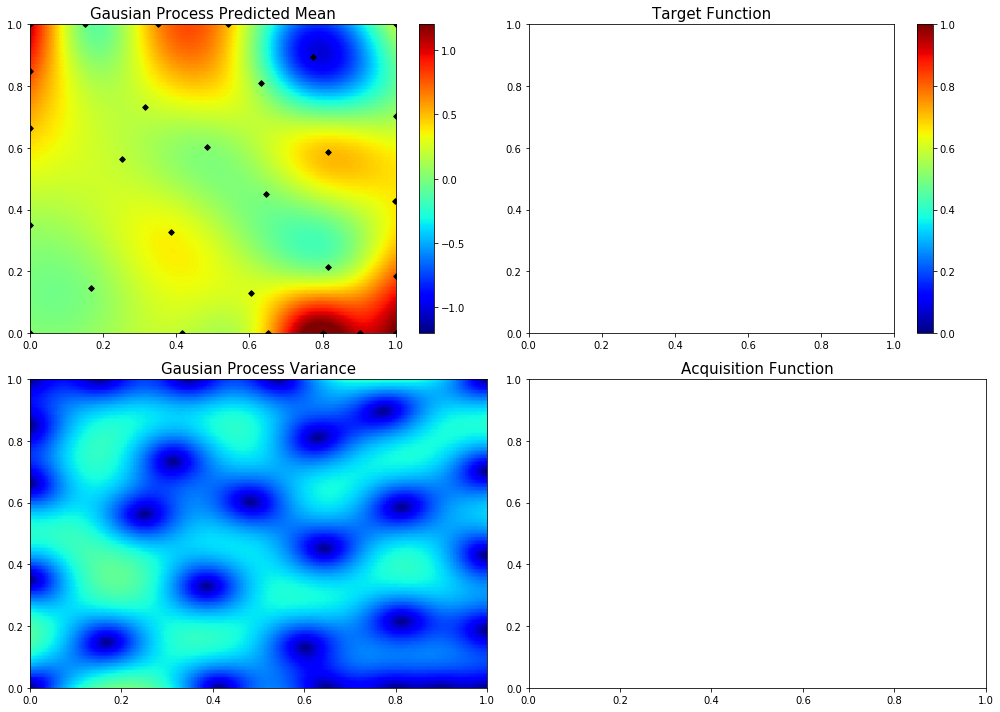

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8623796004284402, 0.44659656510626]
77  Evaluations Remaining
|  29       |  0.371    |  0.8624   |  0.4466   |
myplot:  029


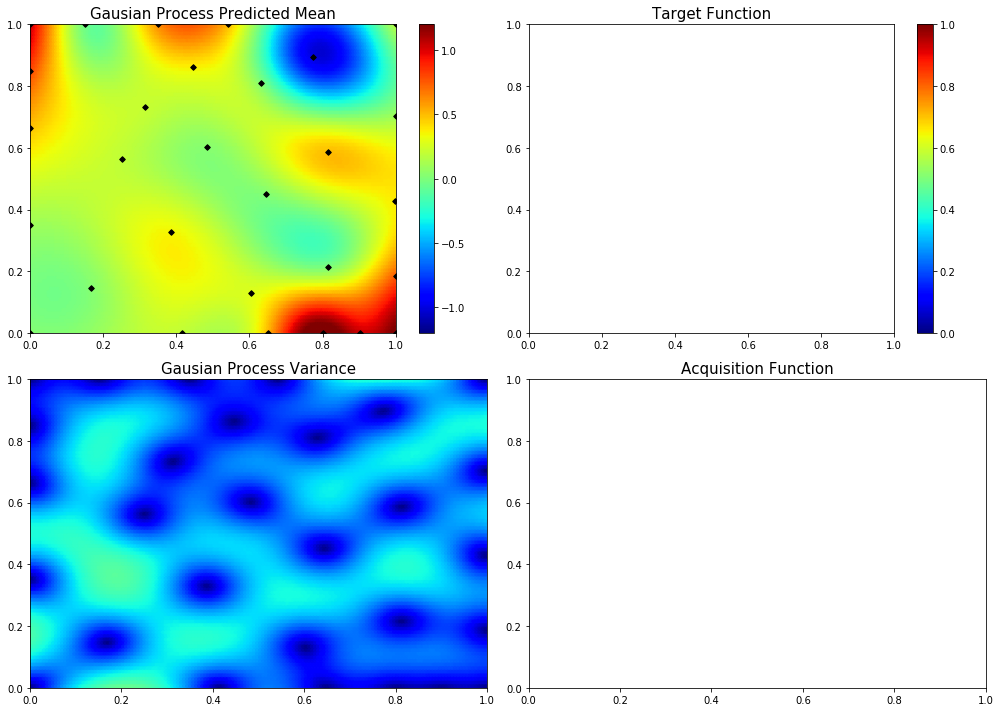

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.21869869628852967]
76  Evaluations Remaining
|  30       |  0.3342   |  0.0      |  0.2187   |
myplot:  030


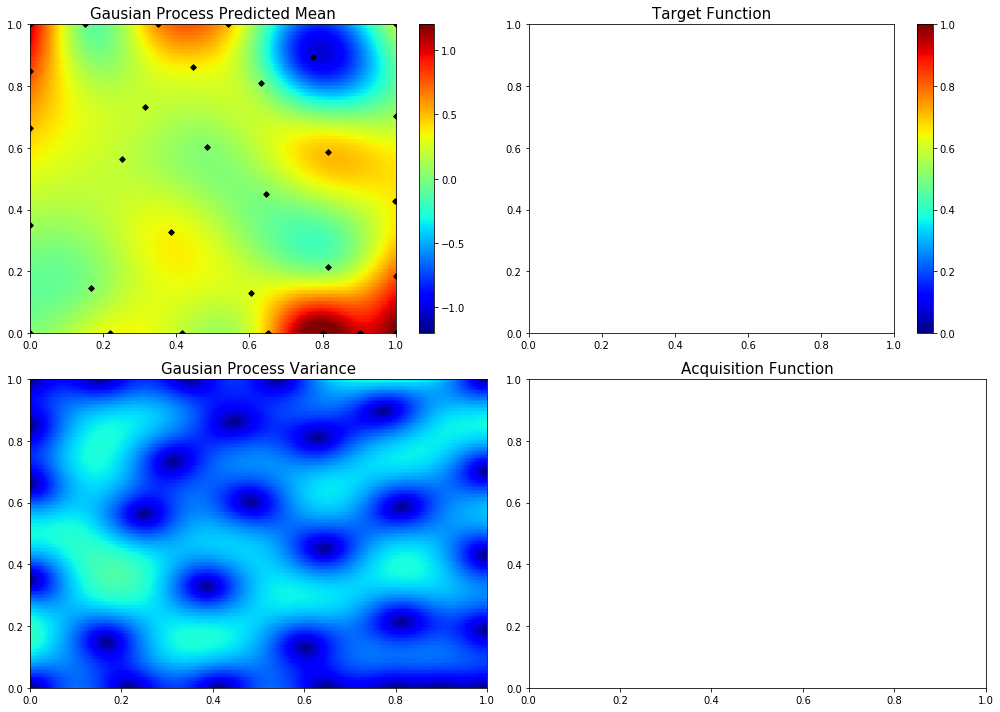

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.8266578634455367]
75  Evaluations Remaining
|  31       |  1.169    |  0.0      |  0.8267   |
myplot:  031


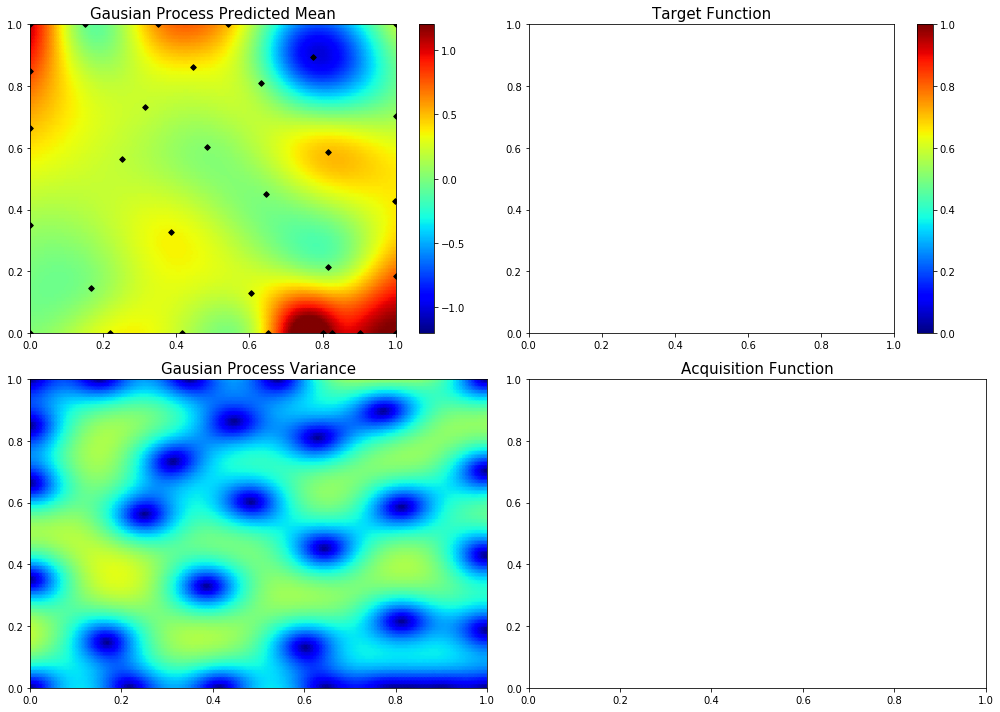

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3713451335725543, 0.19443044976661314]
74  Evaluations Remaining
|  32       | -0.6771   |  0.3713   |  0.1944   |
myplot:  032


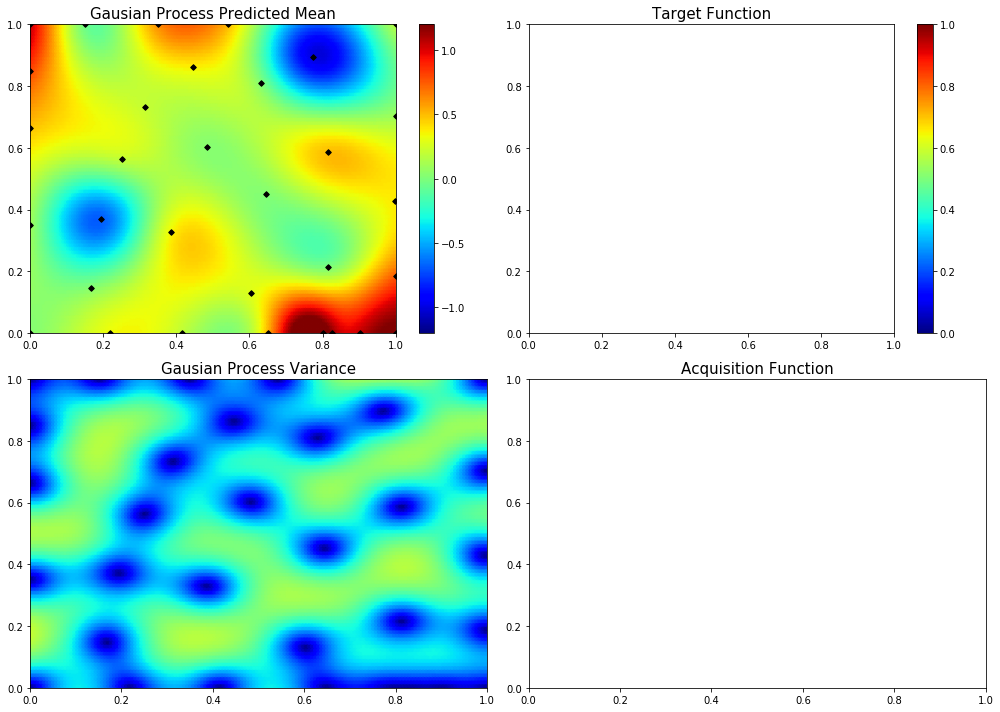

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1640577443040085, 0.38102321857309795]
73  Evaluations Remaining
|  33       |  0.07607  |  0.1641   |  0.381    |
myplot:  033


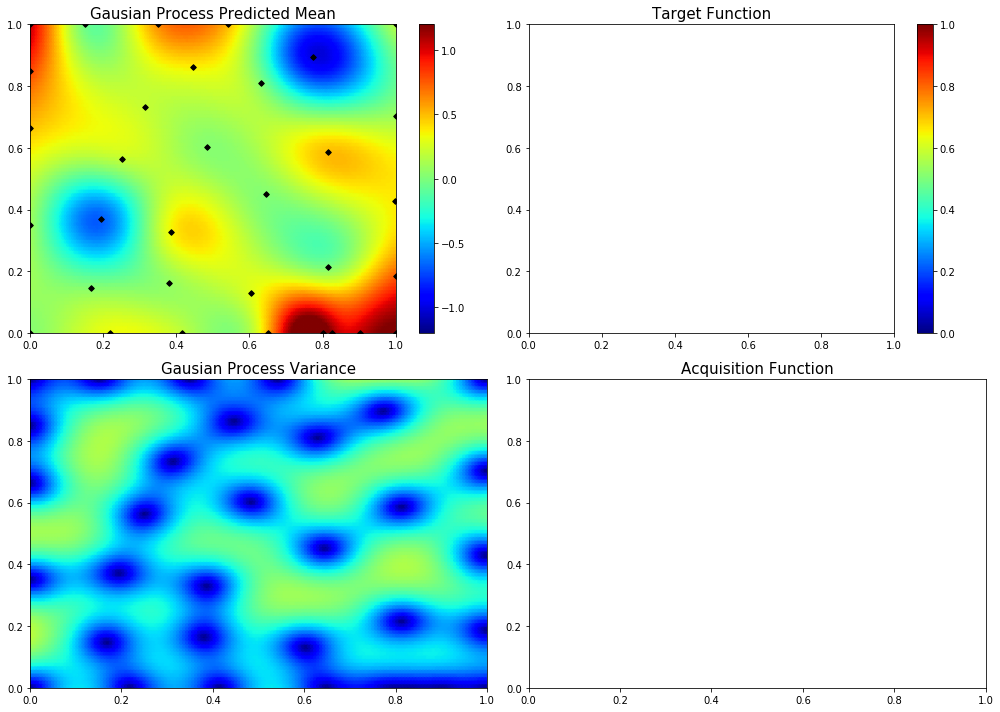

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7576600968832838, 0.14242846070402895]
72  Evaluations Remaining
|  34       |  0.5514   |  0.7577   |  0.1424   |
myplot:  034


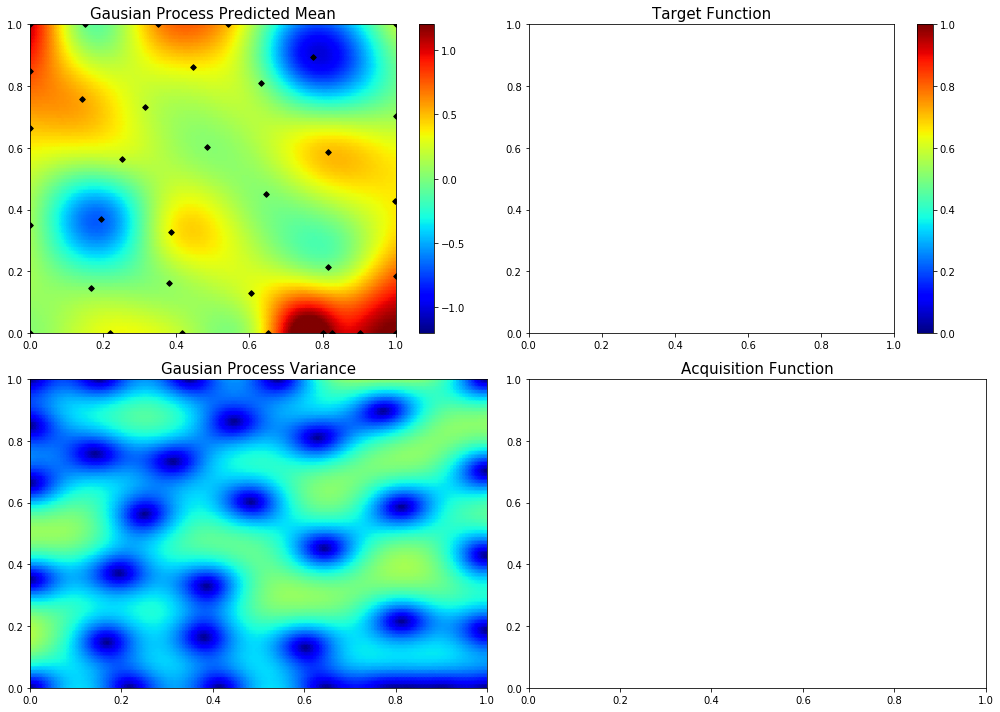

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1782701584340067, 0.0]
71  Evaluations Remaining
|  35       |  0.0272   |  0.1783   |  0.0      |
myplot:  035


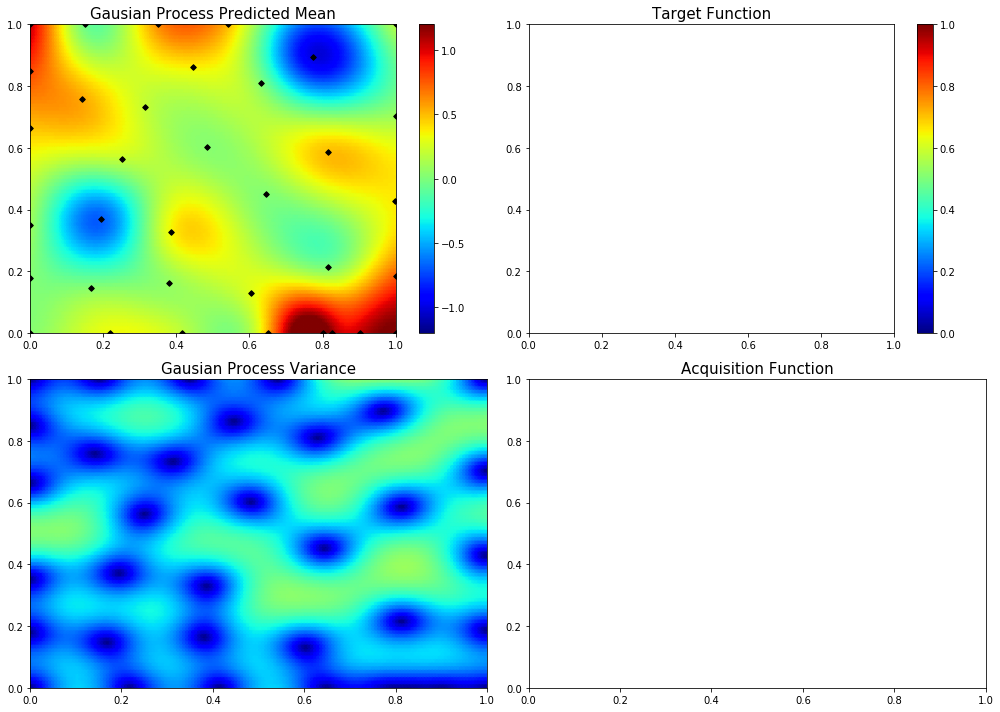

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3004455006911724, 0.5488678973739824]
70  Evaluations Remaining
|  36       |  0.4862   |  0.3004   |  0.5489   |
myplot:  036


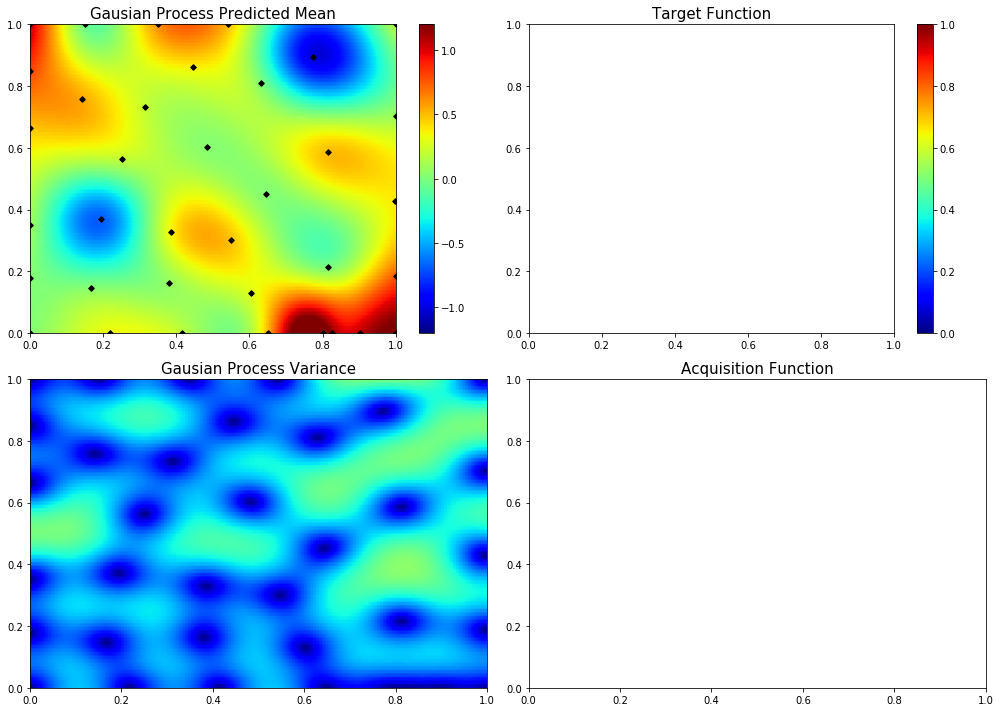

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4170825506450425, 0.8340319904076376]
69  Evaluations Remaining
|  37       | -0.09805  |  0.4171   |  0.834    |
myplot:  037


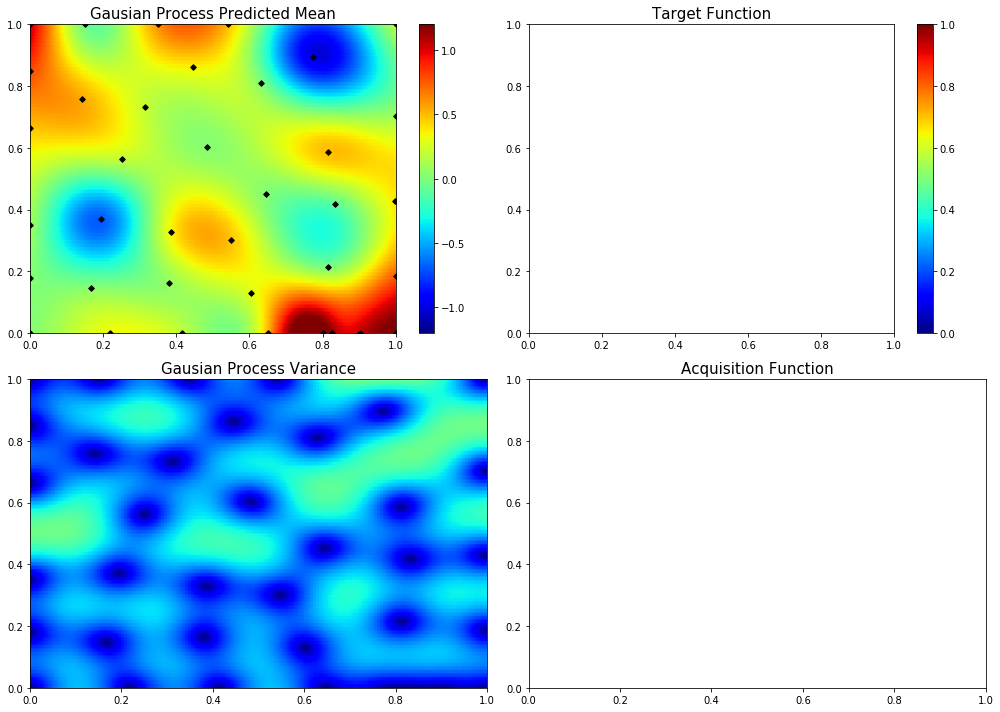

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.513039607088177, 0.0]
68  Evaluations Remaining
|  38       |  0.3267   |  0.513    |  0.0      |
myplot:  038


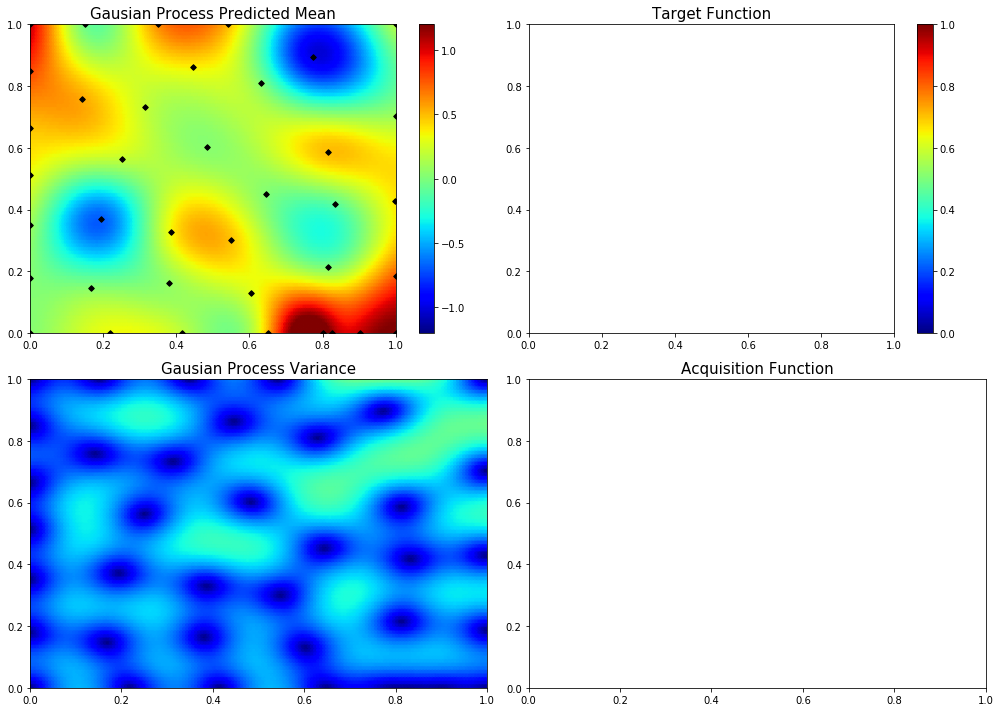

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6443084996038895, 0.6684521327381061]
67  Evaluations Remaining
|  39       |  0.06605  |  0.6443   |  0.6685   |
myplot:  039


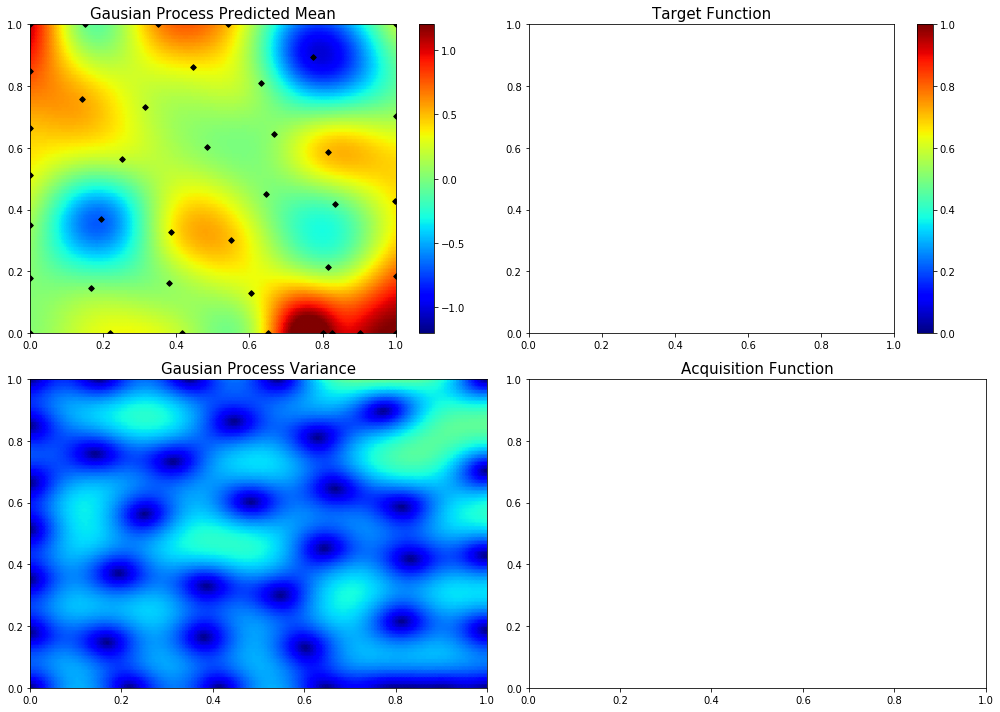

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.562952923414069, 1.0]
66  Evaluations Remaining
|  40       |  0.2266   |  0.563    |  1.0      |
myplot:  040


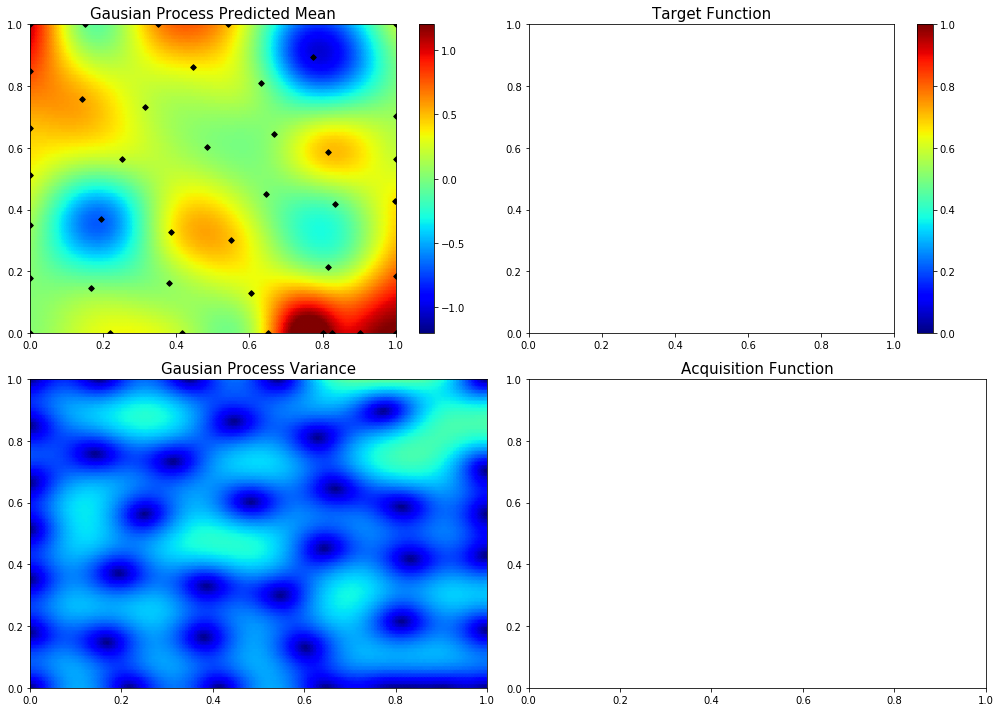

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.07775554667802438, 0.7573410223930238]
65  Evaluations Remaining
|  41       |  0.8371   |  0.07776  |  0.7573   |
myplot:  041


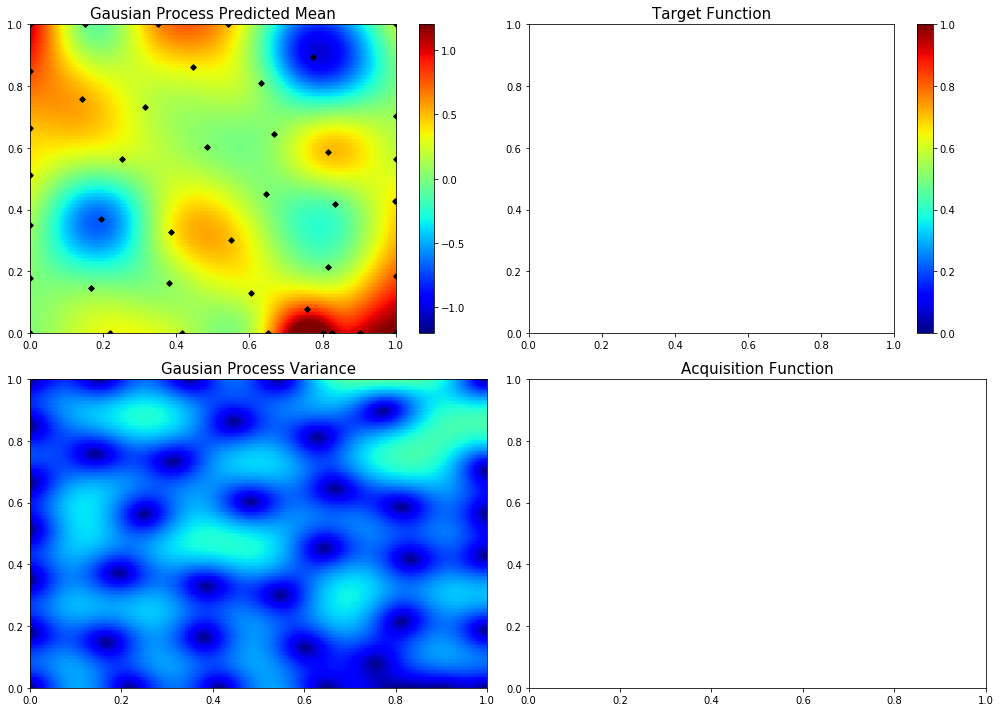

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4487189259921882, 0.4545991076984391]
64  Evaluations Remaining
|  42       |  0.04646  |  0.4487   |  0.4546   |
myplot:  042


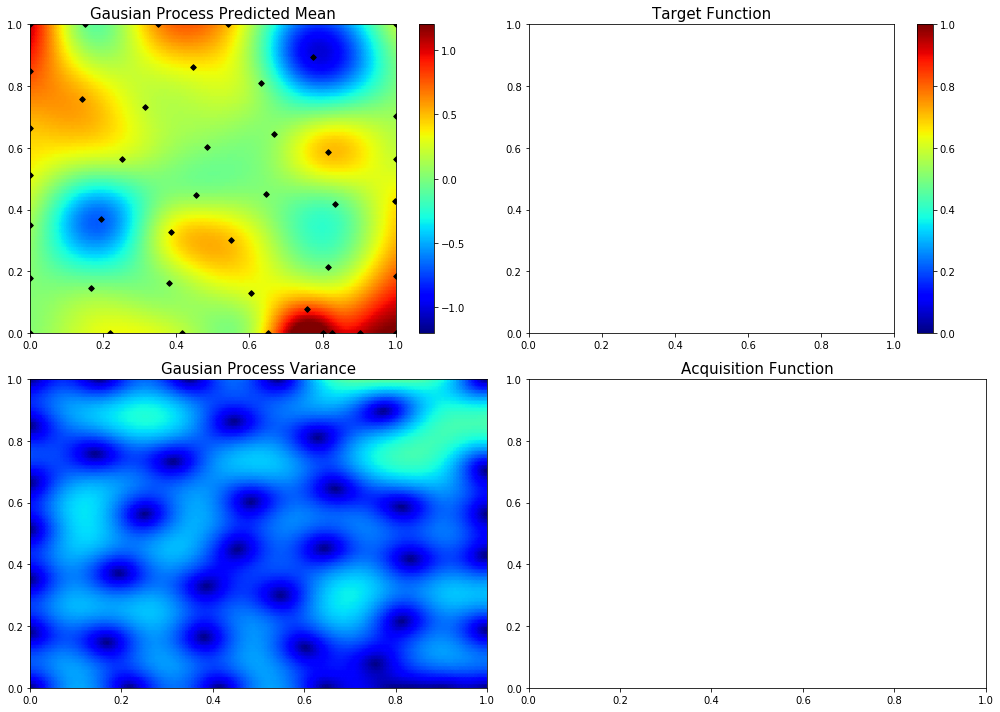

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.08187831387049493, 1.0]
63  Evaluations Remaining
|  43       |  0.9363   |  0.08188  |  1.0      |
myplot:  043


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\gaussian_process\gpr.py:480: ConvergenceWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([1.16357791e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 56, 'nit': 6, 'warnflag': 2}
  ConvergenceWarning)


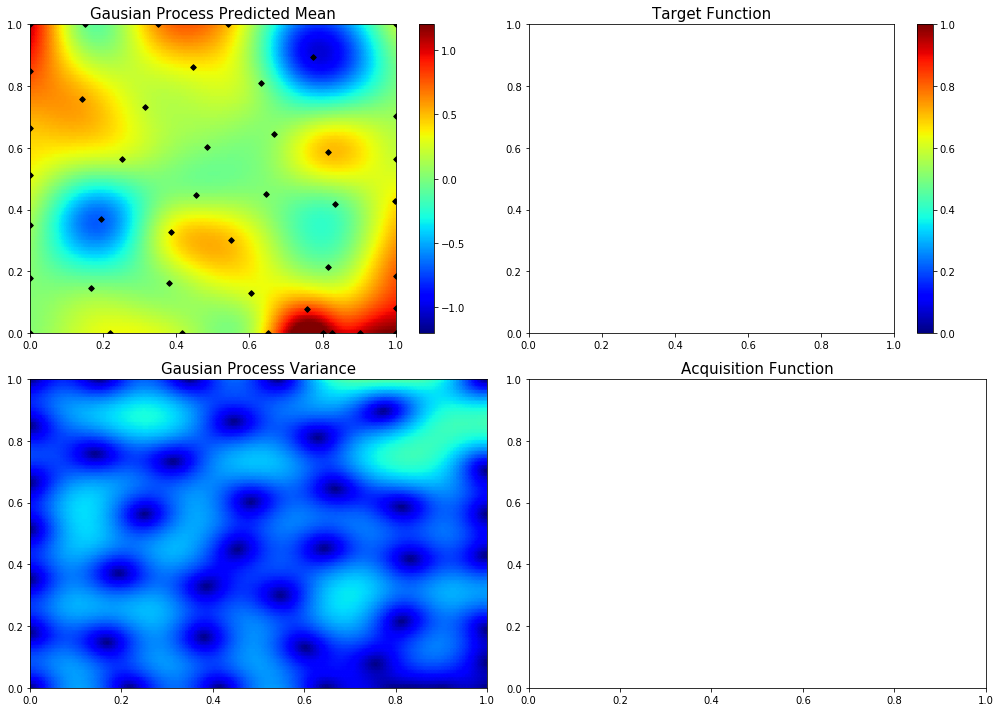

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8605471452603327, 1.0]
62  Evaluations Remaining
|  44       |  0.1197   |  0.8605   |  1.0      |
myplot:  044


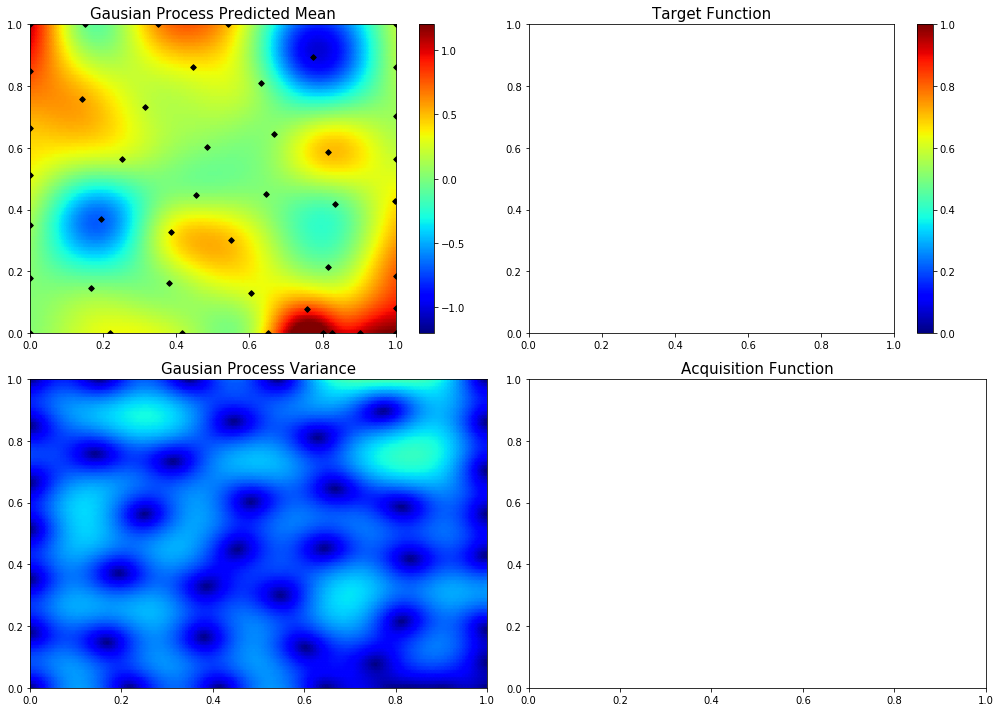

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6144986418575398, 0.12194657622230237]
61  Evaluations Remaining
|  45       |  0.7601   |  0.6145   |  0.1219   |
myplot:  045


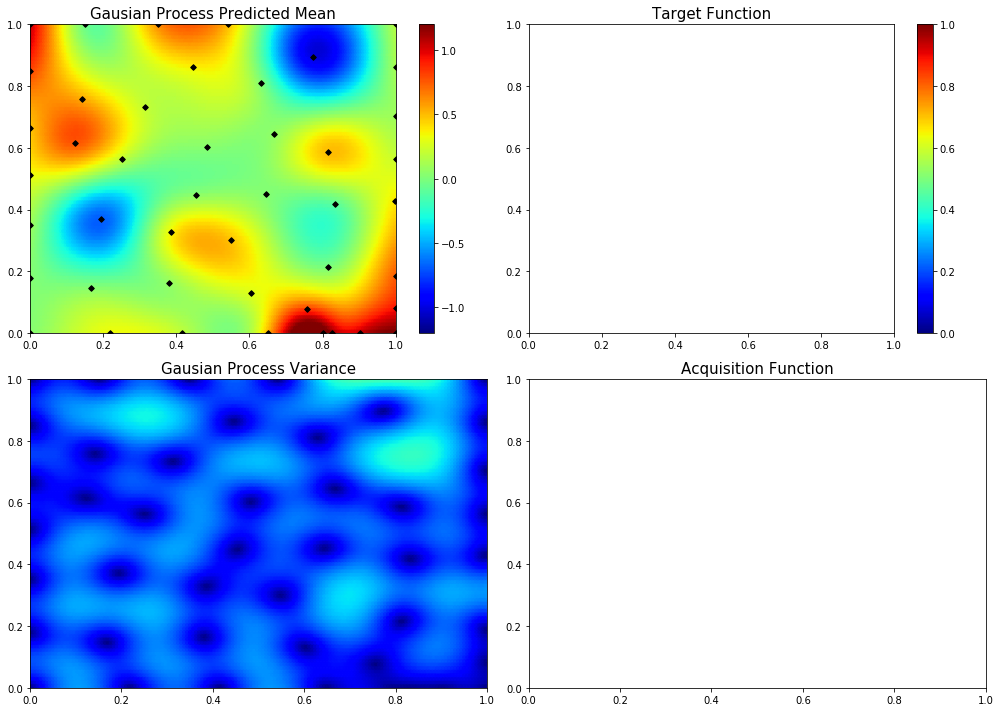

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8793971795170354, 0.27171969557762854]
60  Evaluations Remaining
|  46       |  0.233    |  0.8794   |  0.2717   |
myplot:  046


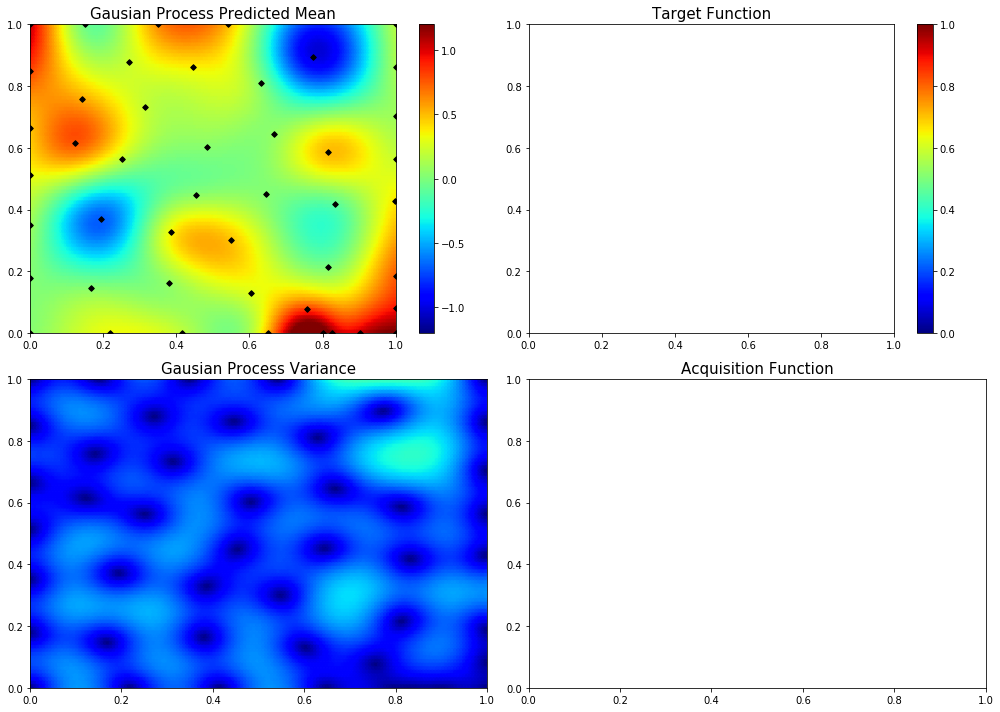

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7138188965710527, 0.8443904371152802]
59  Evaluations Remaining
|  47       |  0.2322   |  0.7138   |  0.8444   |
myplot:  047


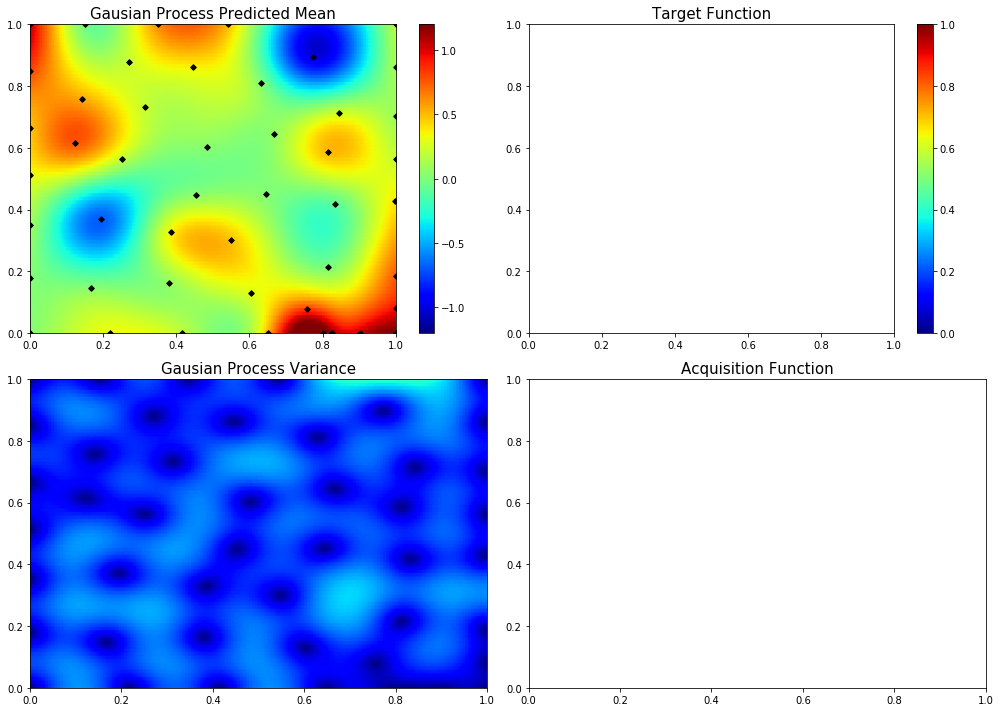

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.30381678492445696, 1.0]
58  Evaluations Remaining
|  48       |  0.8455   |  0.3038   |  1.0      |
myplot:  048


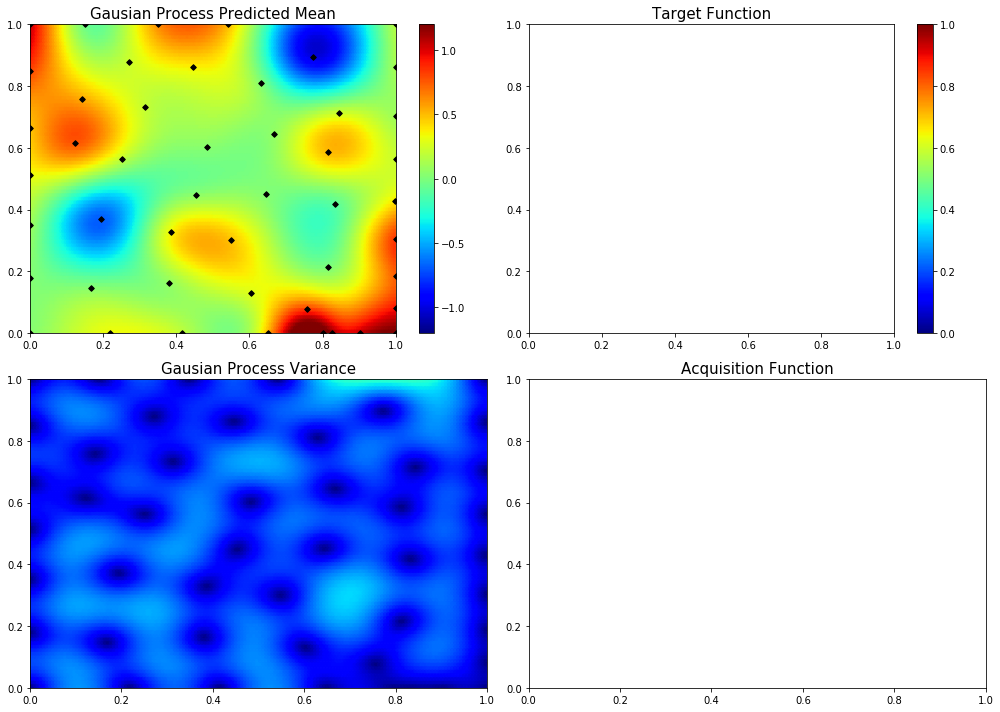

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.7400896305066575]
57  Evaluations Remaining
|  49       |  0.9228   |  0.0      |  0.7401   |
myplot:  049


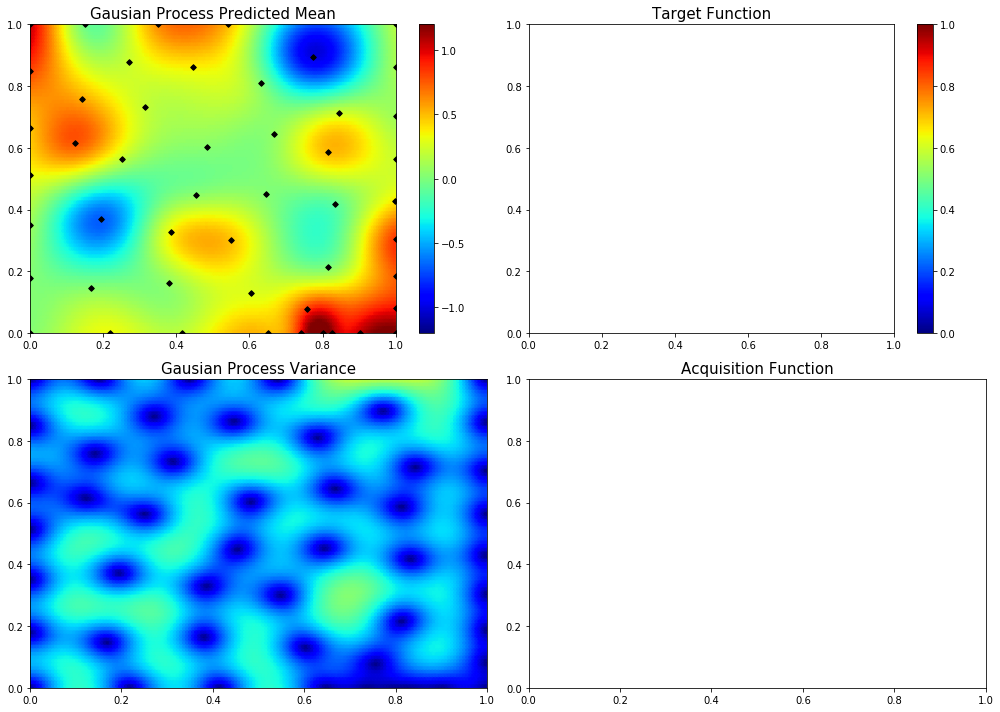

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2849636774922463, 0.6804550392051438]
56  Evaluations Remaining
|  50       | -0.1956   |  0.285    |  0.6805   |
myplot:  050


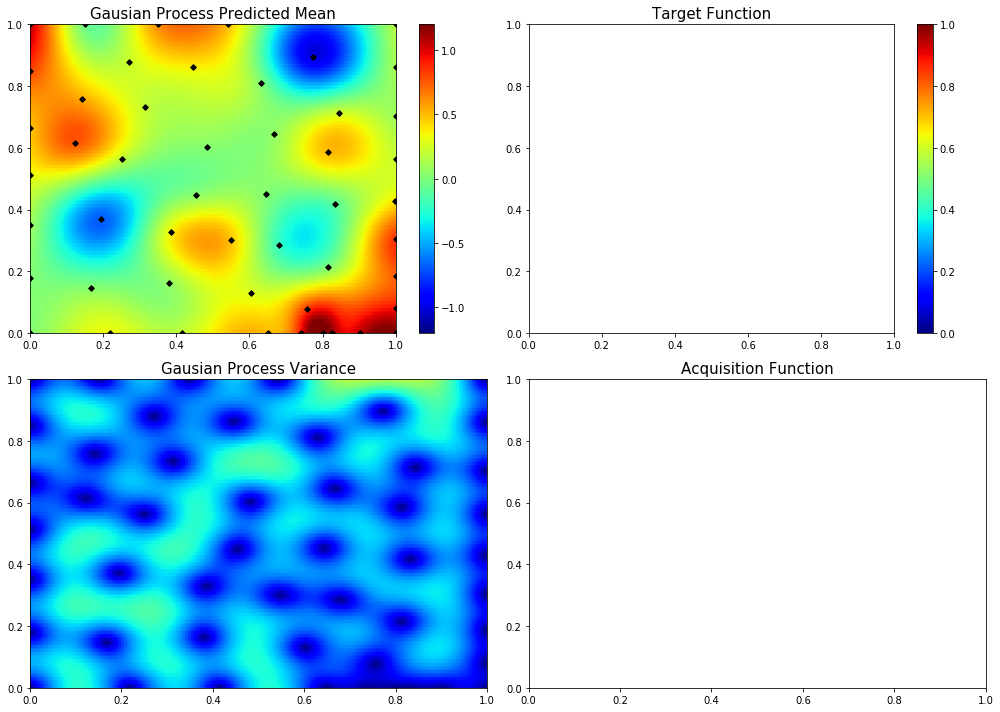

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.6745044230636165]
55  Evaluations Remaining
|  51       | -0.09466  |  1.0      |  0.6745   |
myplot:  051


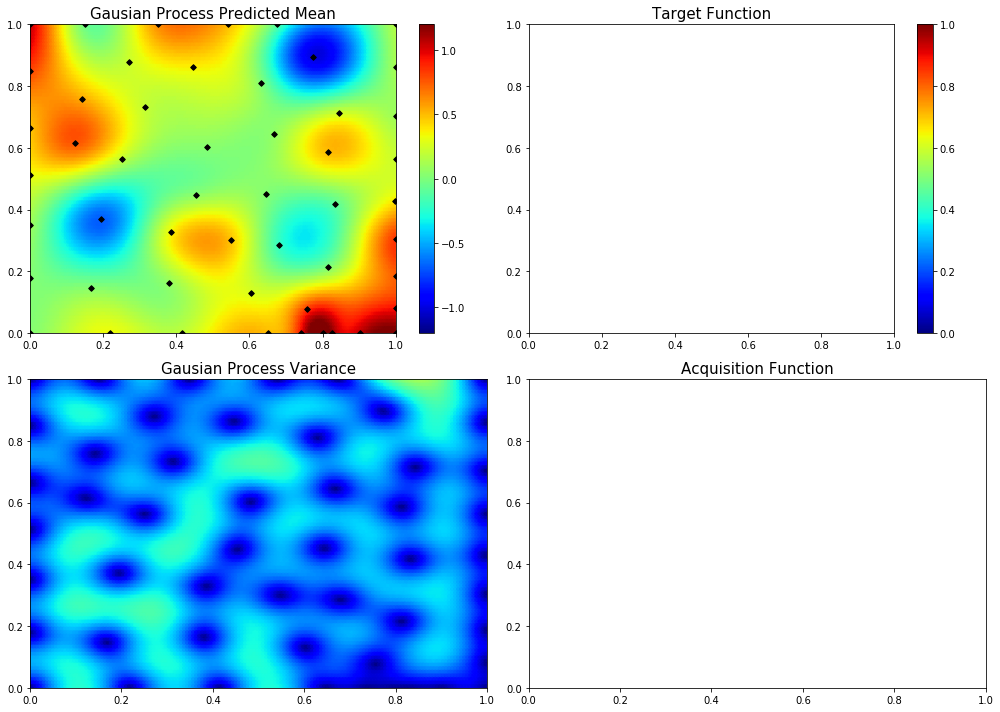

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.738691721084954, 0.5031655570384229]
54  Evaluations Remaining
|  52       |  0.07551  |  0.7387   |  0.5032   |
myplot:  052


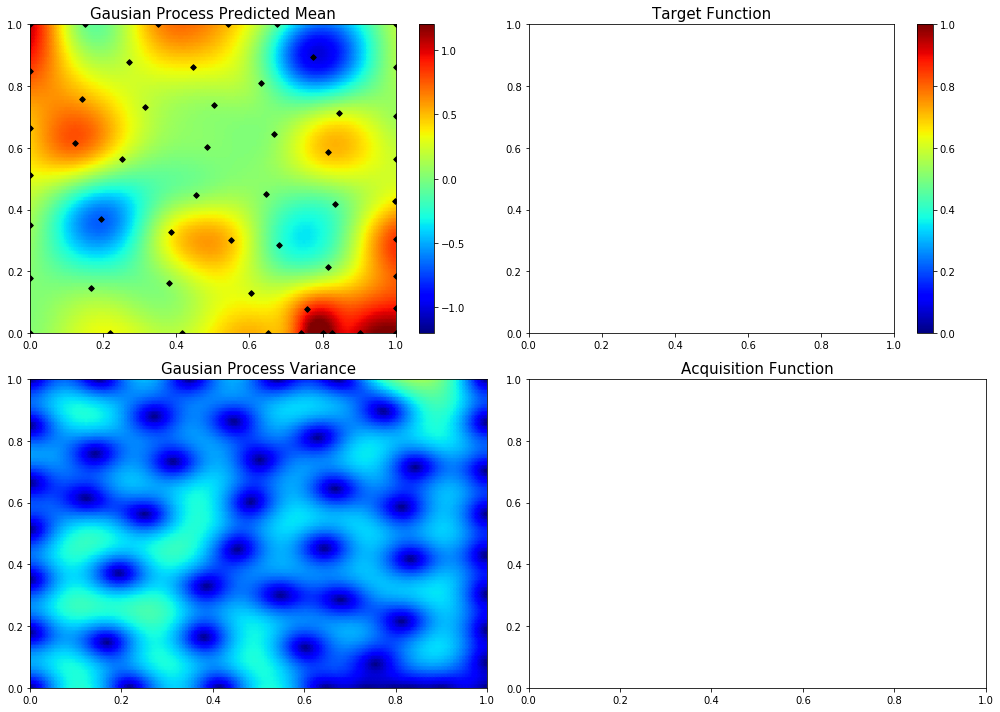

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.5307929537559487]
53  Evaluations Remaining
|  53       |  0.3193   |  0.0      |  0.5308   |
myplot:  053


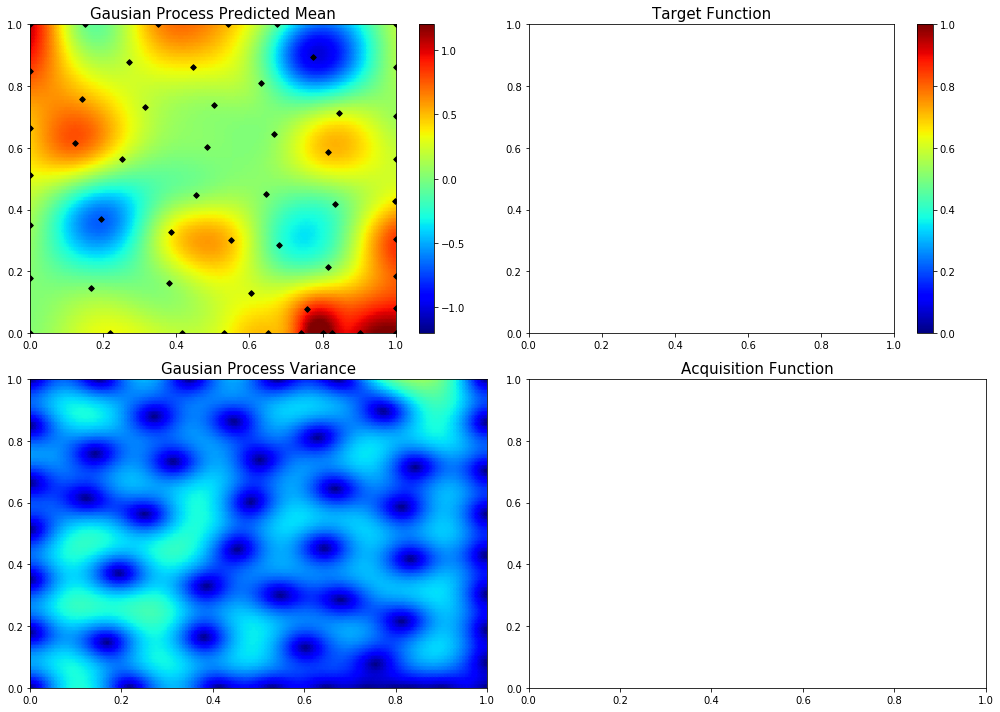

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.10738568284201346, 0.8918520566195264]
52  Evaluations Remaining
|  54       |  0.7621   |  0.1074   |  0.8919   |
myplot:  054


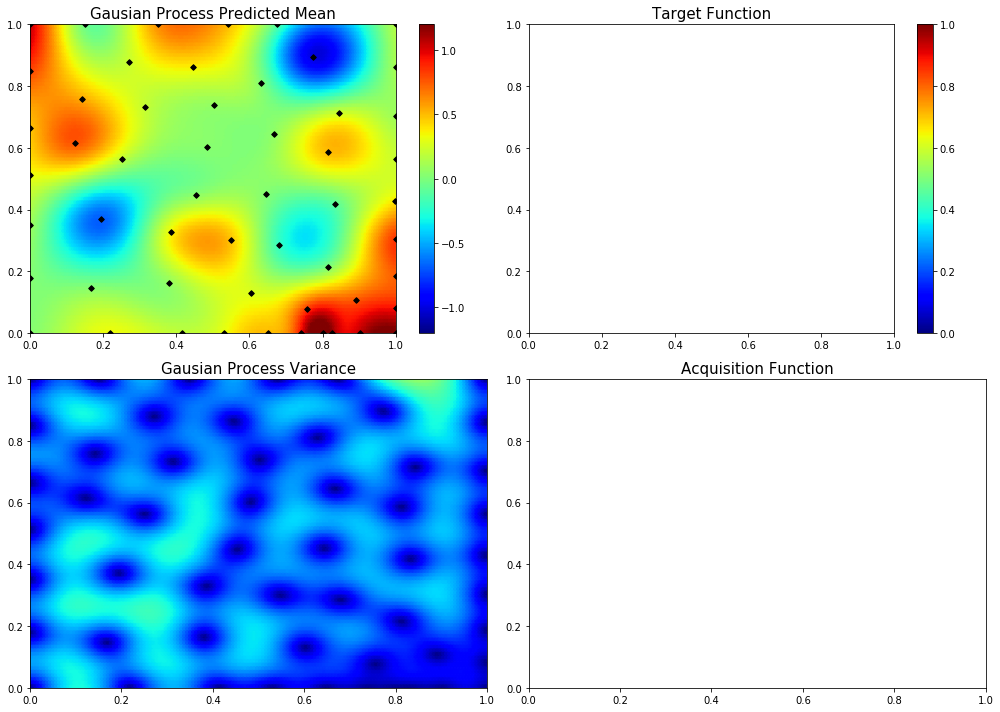

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8979718258318422, 0.08201851862128984]
51  Evaluations Remaining
|  55       |  0.2337   |  0.898    |  0.08202  |
myplot:  055


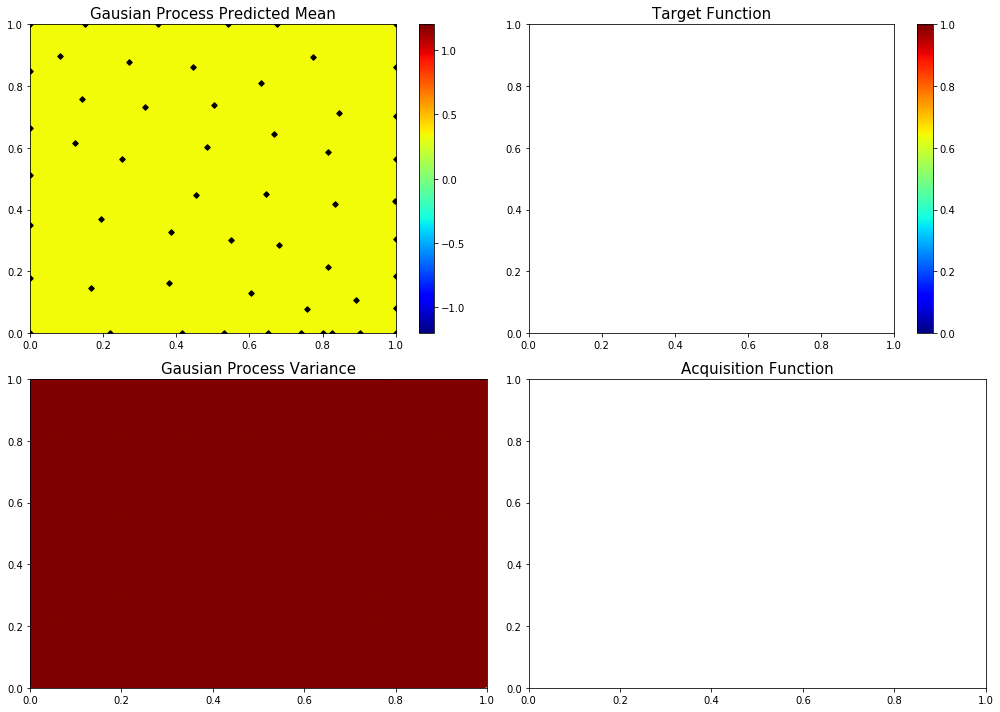

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.8748639130533605]
50  Evaluations Remaining
|  56       | -0.3127   |  1.0      |  0.8749   |
myplot:  056


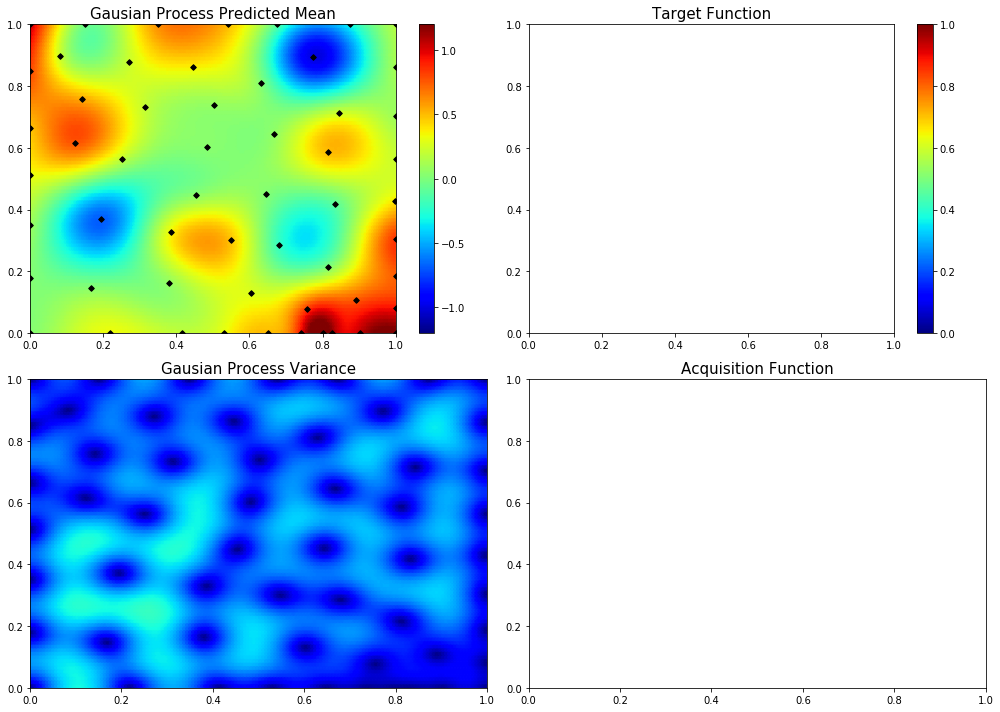

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.20711485938149643, 0.49006616905843225]
49  Evaluations Remaining
|  57       |  0.1636   |  0.2071   |  0.4901   |
myplot:  057


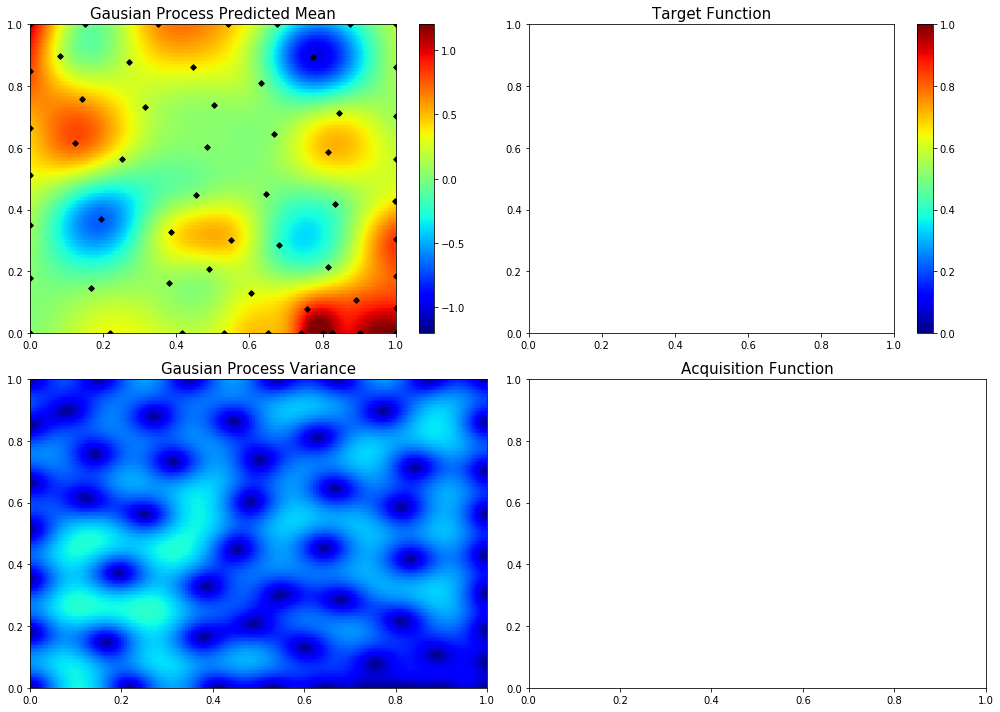

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.4422594900061537]
48  Evaluations Remaining
|  58       |  0.7006   |  1.0      |  0.4423   |
myplot:  058


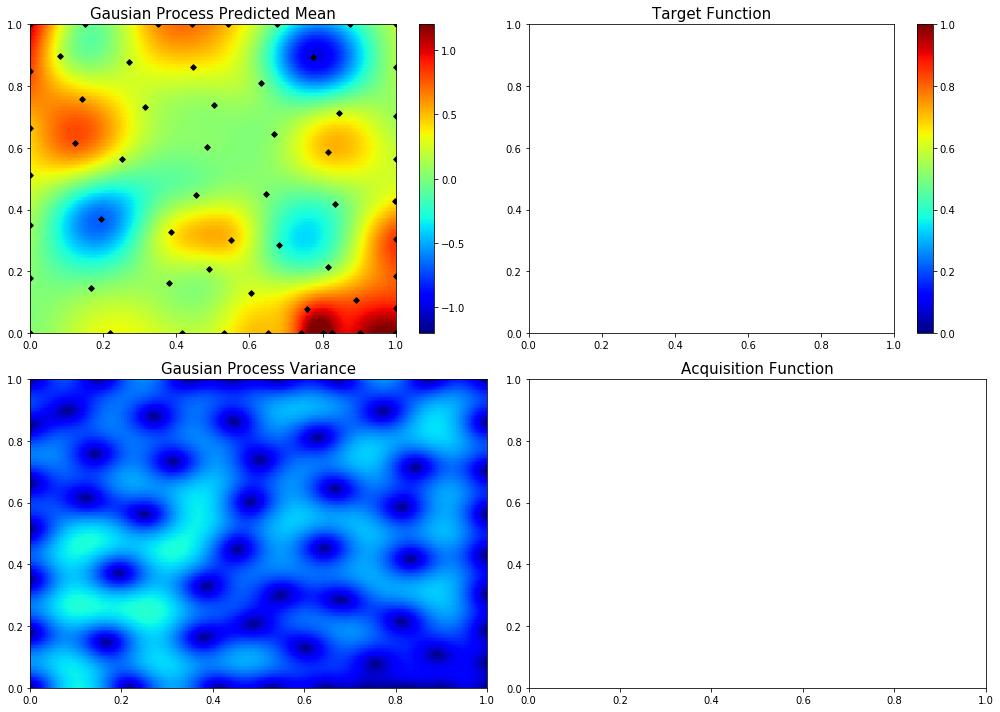

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.11151143064400937]
47  Evaluations Remaining
|  59       |  0.3887   |  0.0      |  0.1115   |
myplot:  059


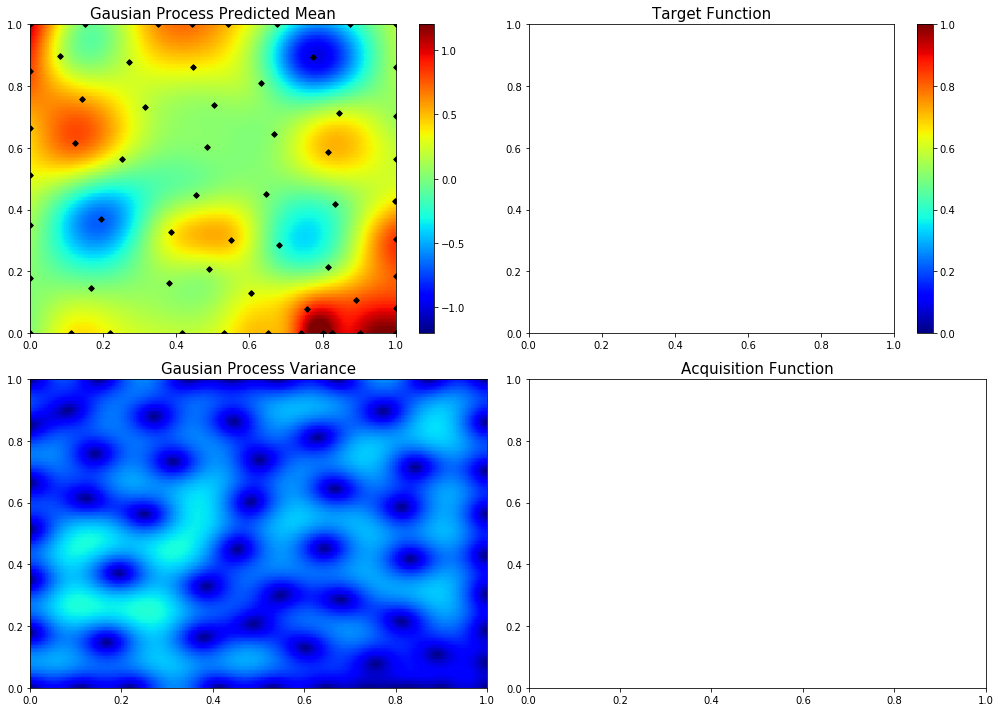

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6708170984345923, 0.20653969296310534]
46  Evaluations Remaining
|  60       |  0.5908   |  0.6708   |  0.2065   |
myplot:  060


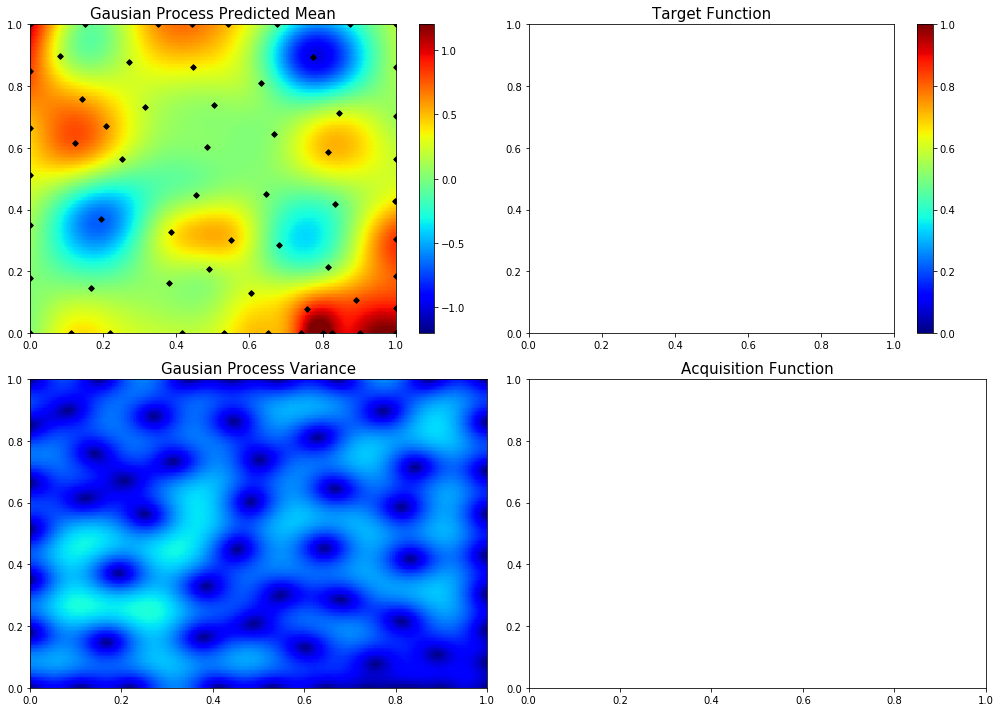

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2840749208749849, 0.9218949597760615]
45  Evaluations Remaining
|  61       |  0.3004   |  0.2841   |  0.9219   |
myplot:  061


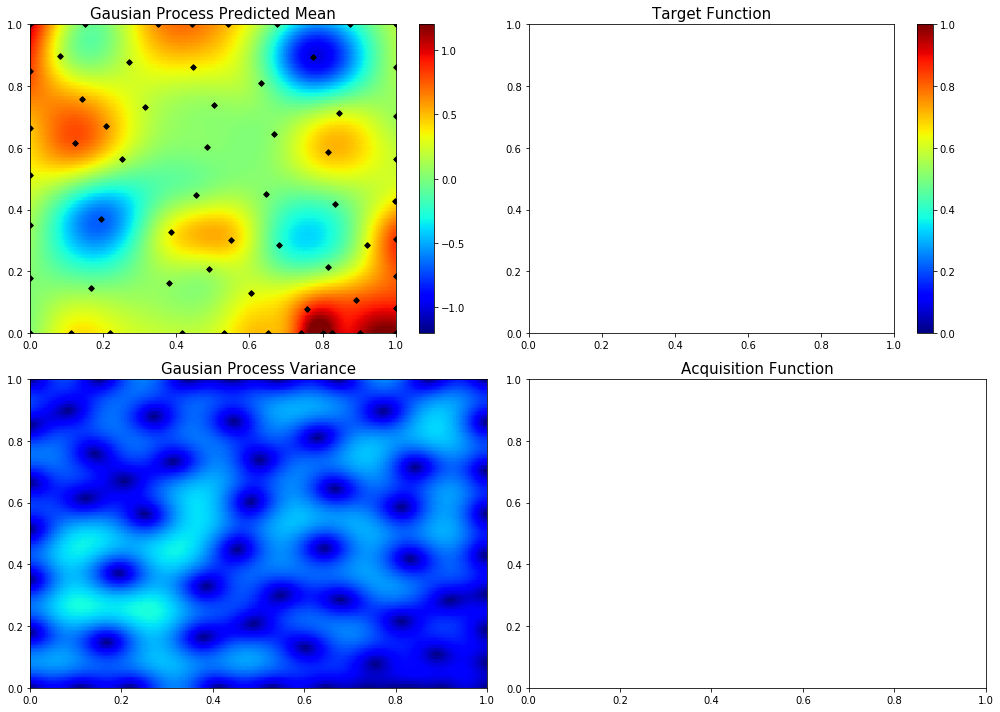

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.500709534646388, 0.1140745213948122]
44  Evaluations Remaining
|  62       |  0.2696   |  0.5007   |  0.1141   |
myplot:  062


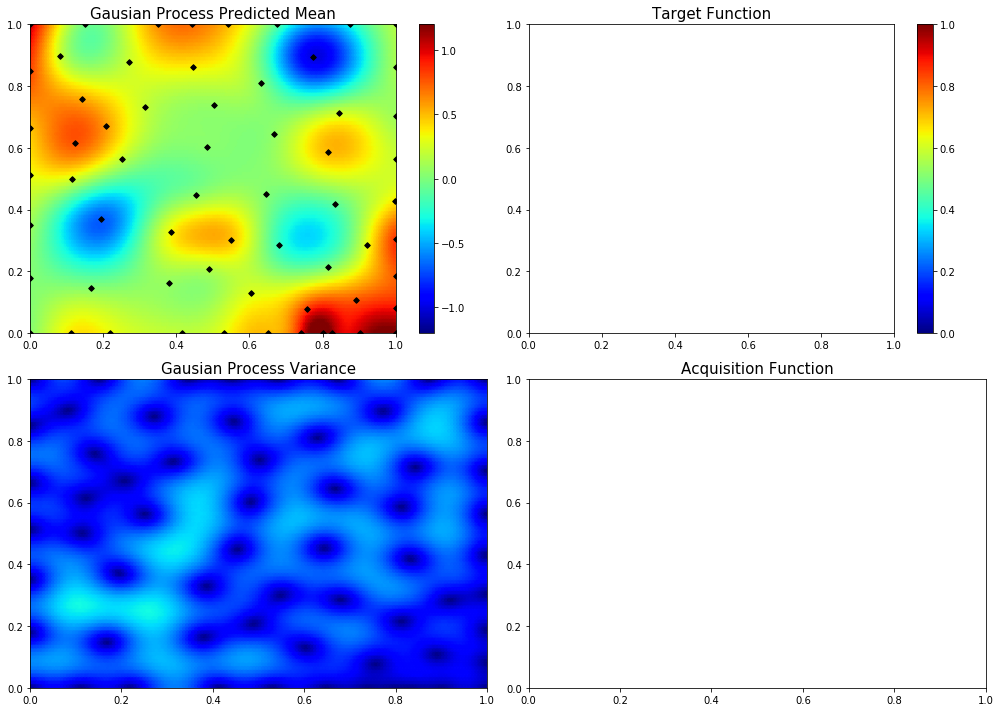

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9293756362030682, 0.0003942920572170827]
43  Evaluations Remaining
|  63       |  0.9959   |  0.9294   |  0.000394 |
myplot:  063


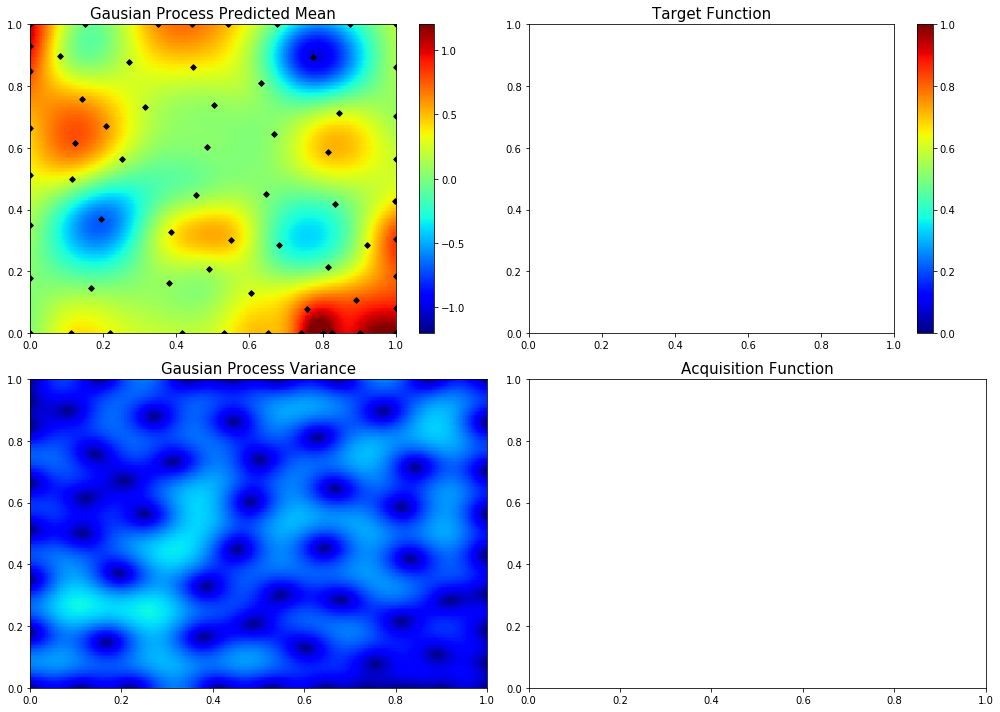

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6101634156068444, 0.9066333431238127]
42  Evaluations Remaining
|  64       |  0.1482   |  0.6102   |  0.9066   |
myplot:  064


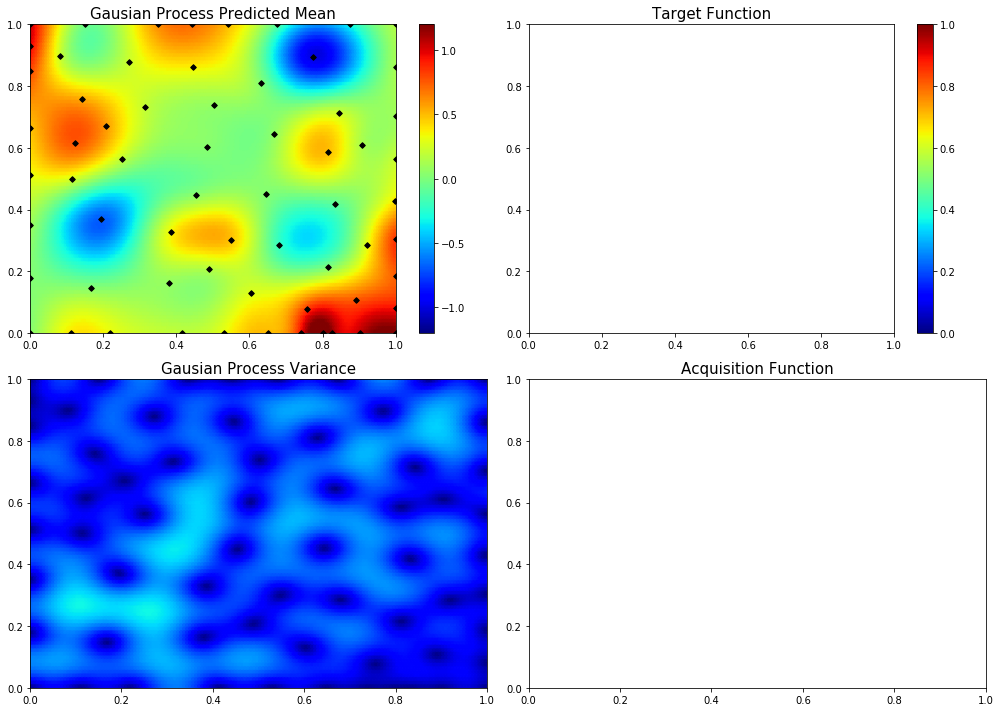

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9019957314933716, 0.5499156671806417]
41  Evaluations Remaining
|  65       |  0.4005   |  0.902    |  0.5499   |
myplot:  065


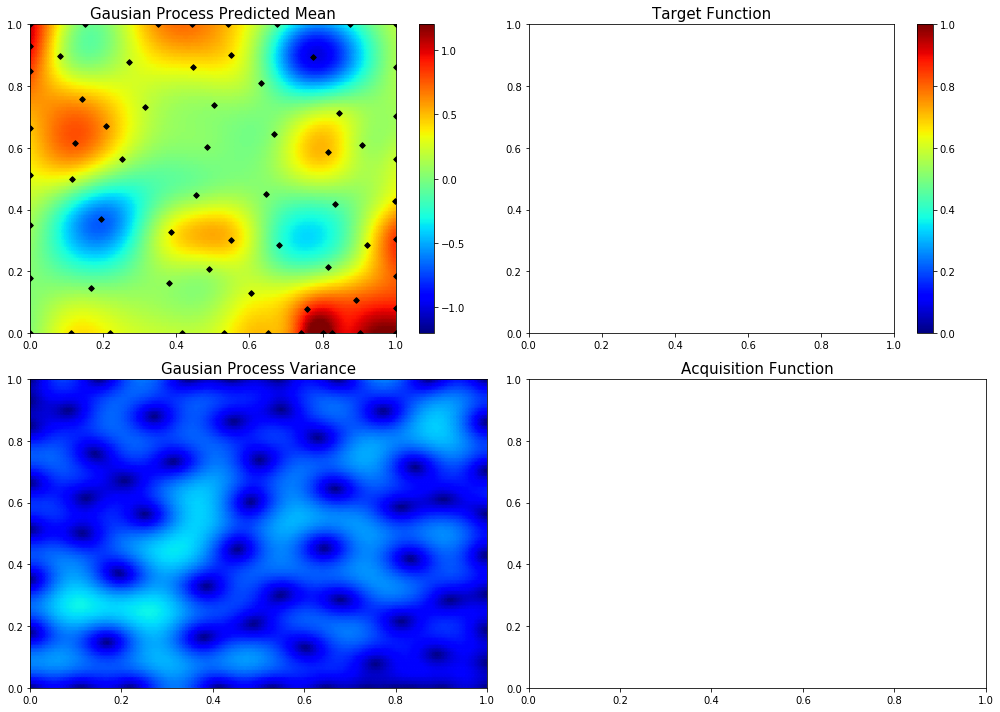

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7413495195604924, 0.04831936689014633]
40  Evaluations Remaining
|  66       |  0.6161   |  0.7413   |  0.04832  |
myplot:  066


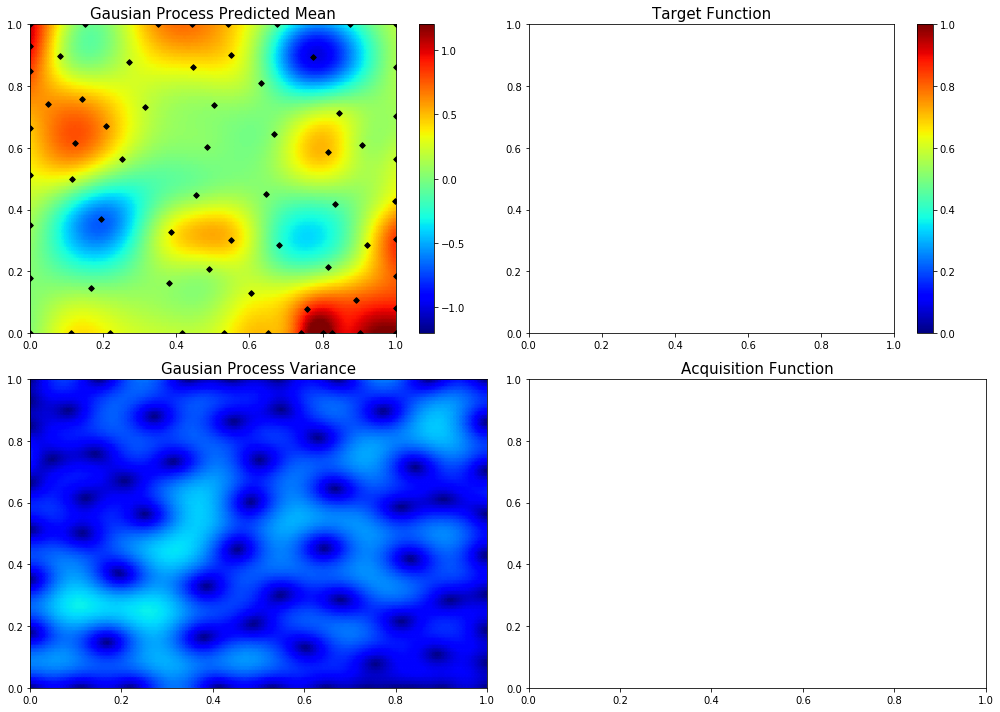

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6117848735665518, 0.36428758292434643]
39  Evaluations Remaining
|  67       |  0.08142  |  0.6118   |  0.3643   |
myplot:  067


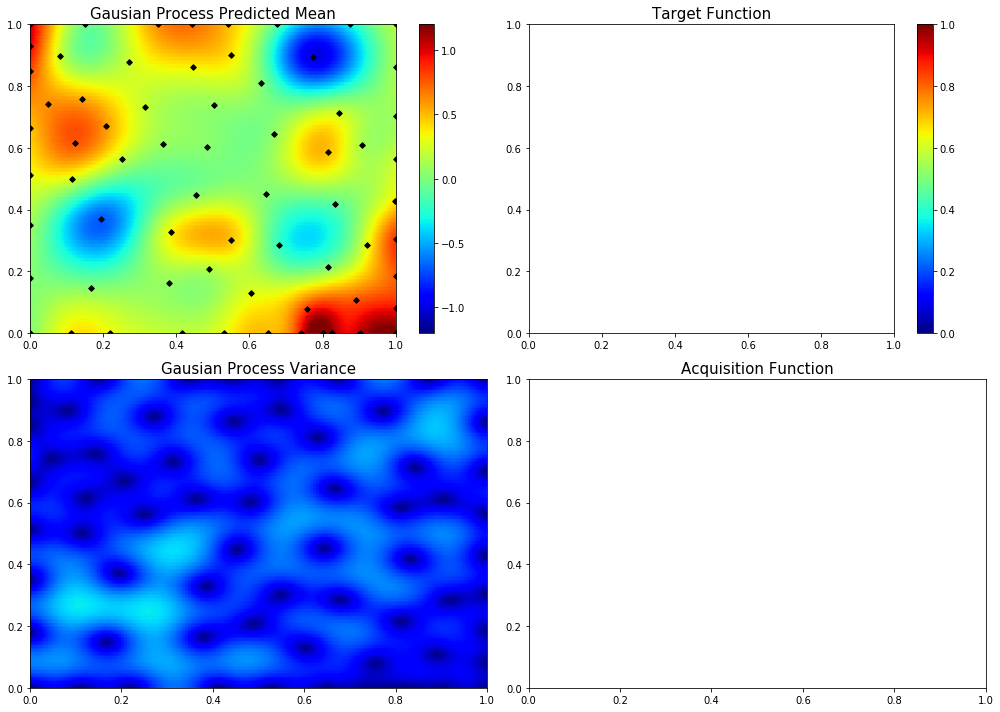

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.041343543161203845, 0.8062431930372426]
38  Evaluations Remaining
|  68       |  1.04     |  0.04134  |  0.8062   |
myplot:  068


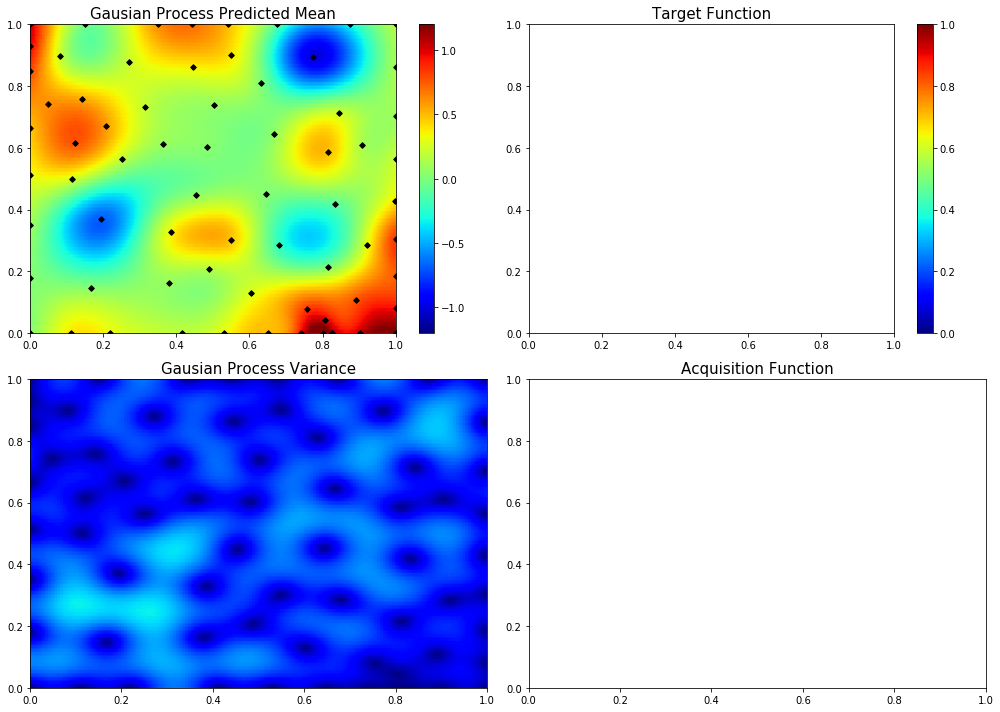

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.23583255564891878, 0.2820288784558708]
37  Evaluations Remaining
|  69       | -0.1125   |  0.2358   |  0.282    |
myplot:  069


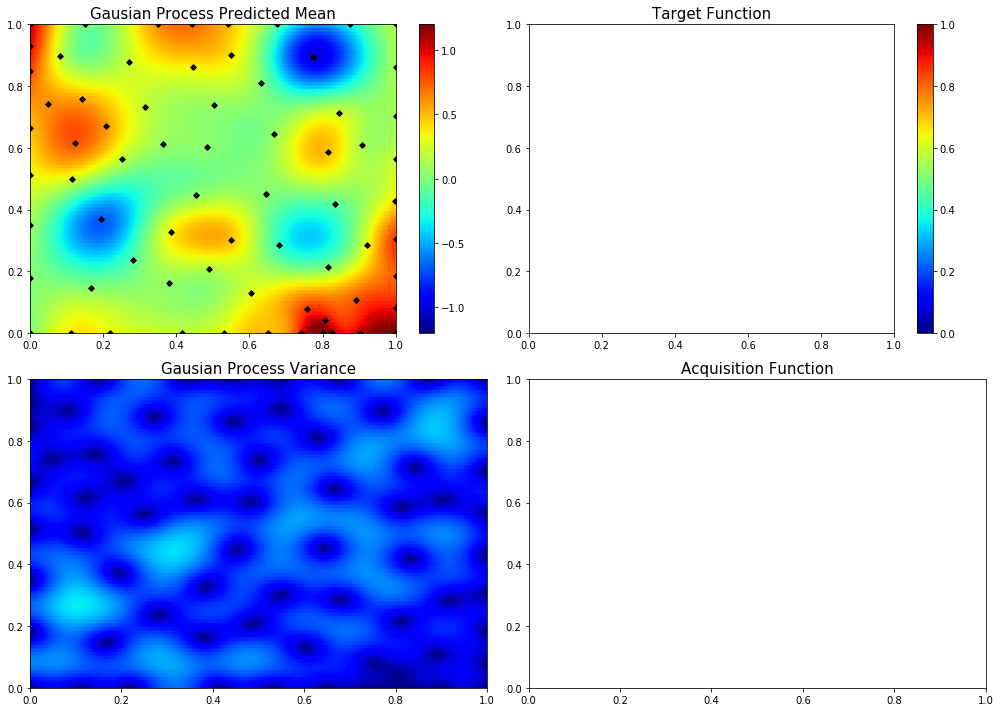

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.030271995855917187, 0.9577540277288061]
36  Evaluations Remaining
|  70       |  0.9702   |  0.03027  |  0.9578   |
myplot:  070


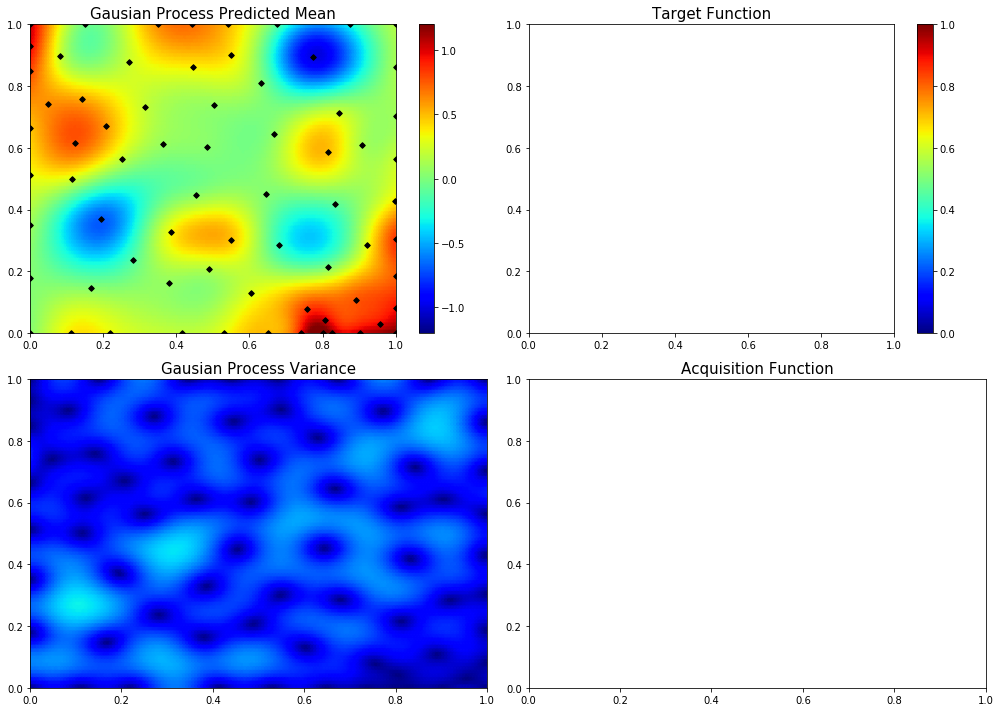

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.08111739830416885, 0.29070246041025666]
35  Evaluations Remaining
|  71       |  0.08272  |  0.08112  |  0.2907   |
myplot:  071


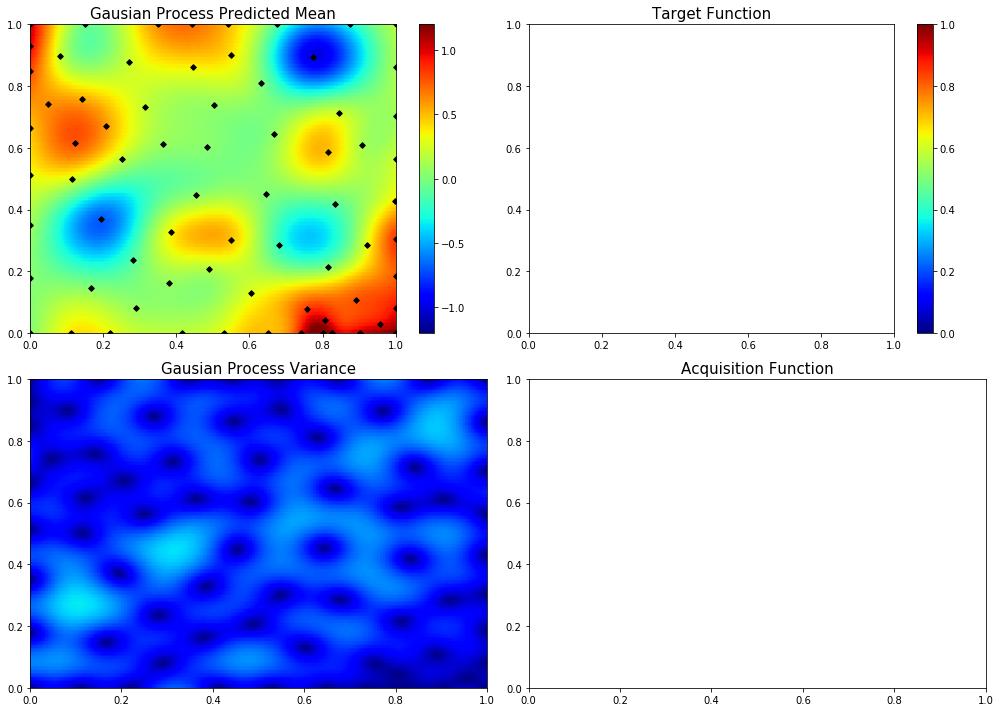

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5280436488844531, 0.7333518422171084]
34  Evaluations Remaining
|  72       |  0.212    |  0.528    |  0.7334   |
myplot:  072


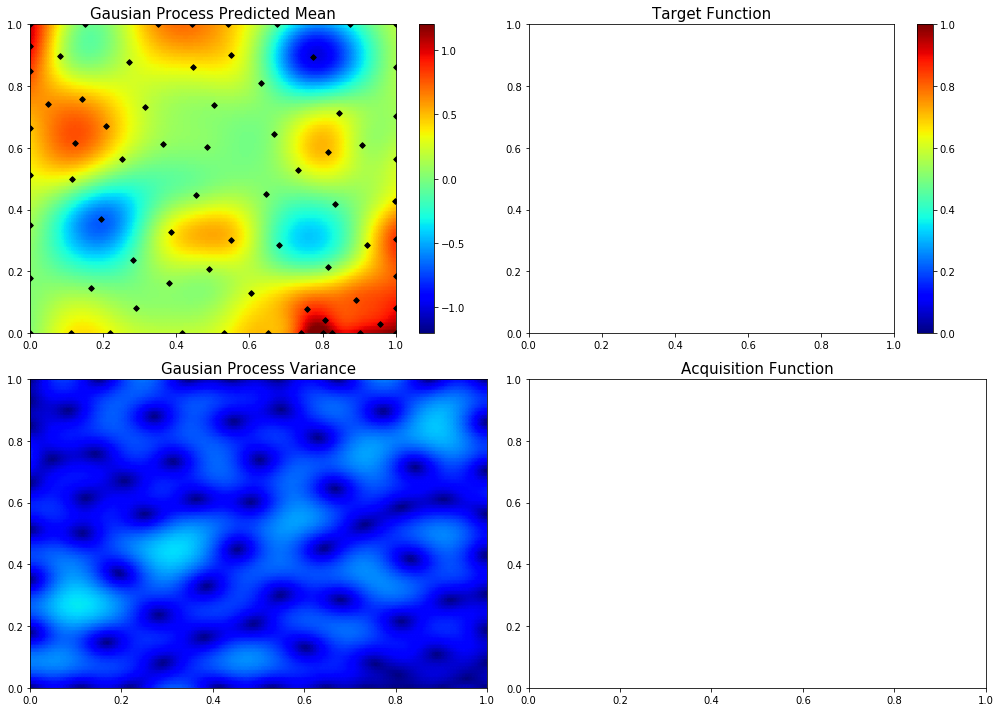

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.92870119472589, 0.3790270820494245]
33  Evaluations Remaining
|  73       |  0.7002   |  0.9287   |  0.379    |
myplot:  073


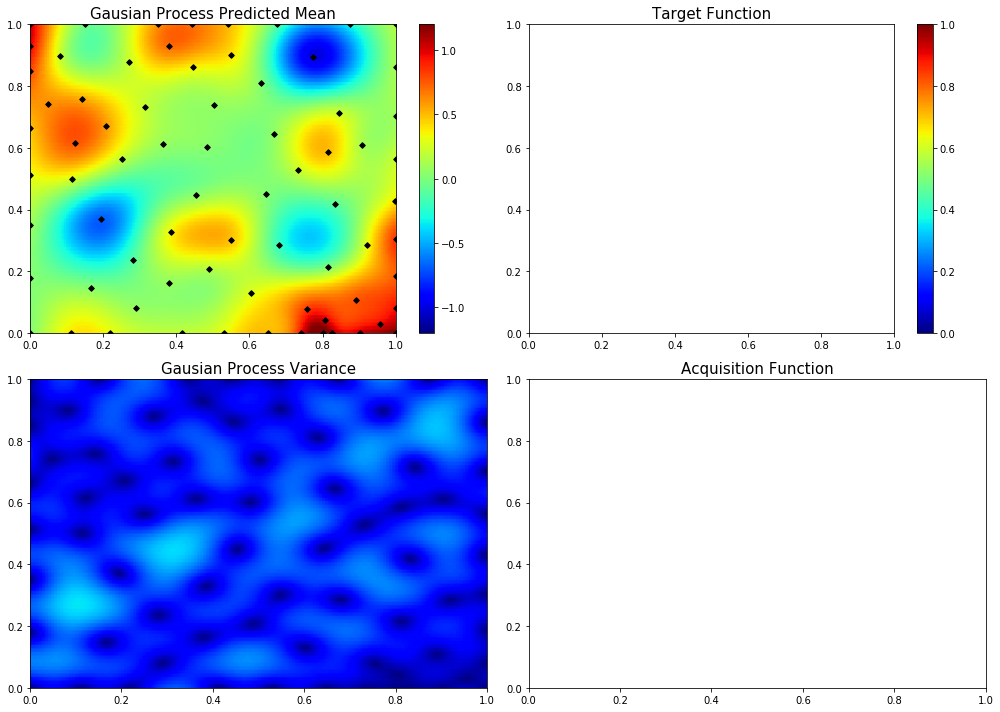

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4488103451247945, 0.3310457441268046]
32  Evaluations Remaining
|  74       |  0.01978  |  0.4488   |  0.331    |
myplot:  074


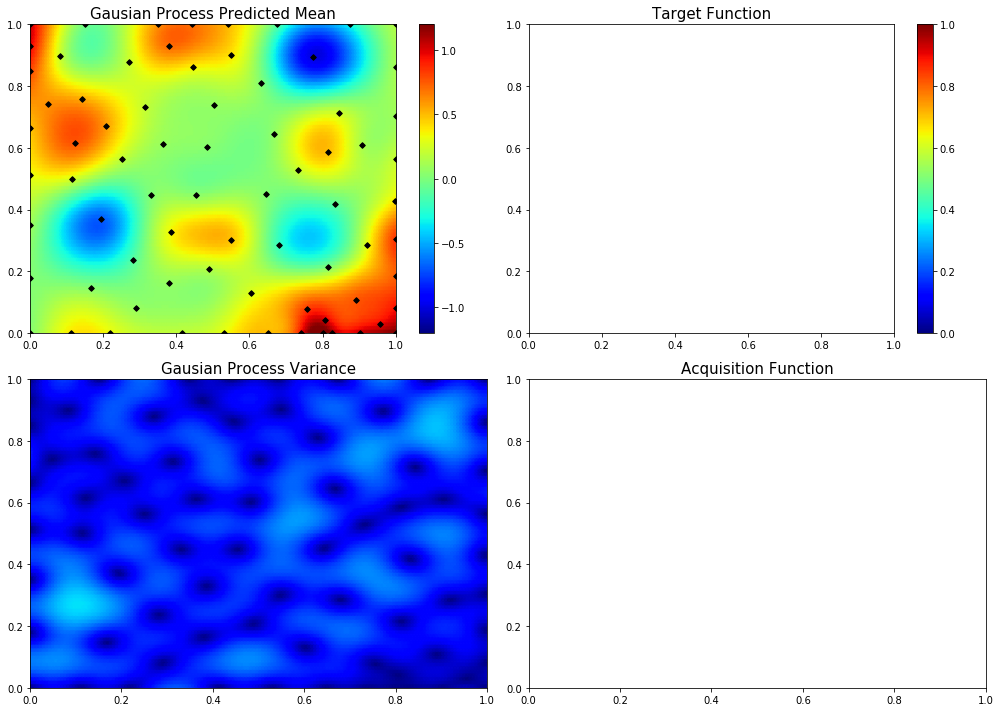

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.08518894910518411, 0.06825936799281698]
31  Evaluations Remaining
|  75       |  0.09098  |  0.08519  |  0.06826  |
myplot:  075


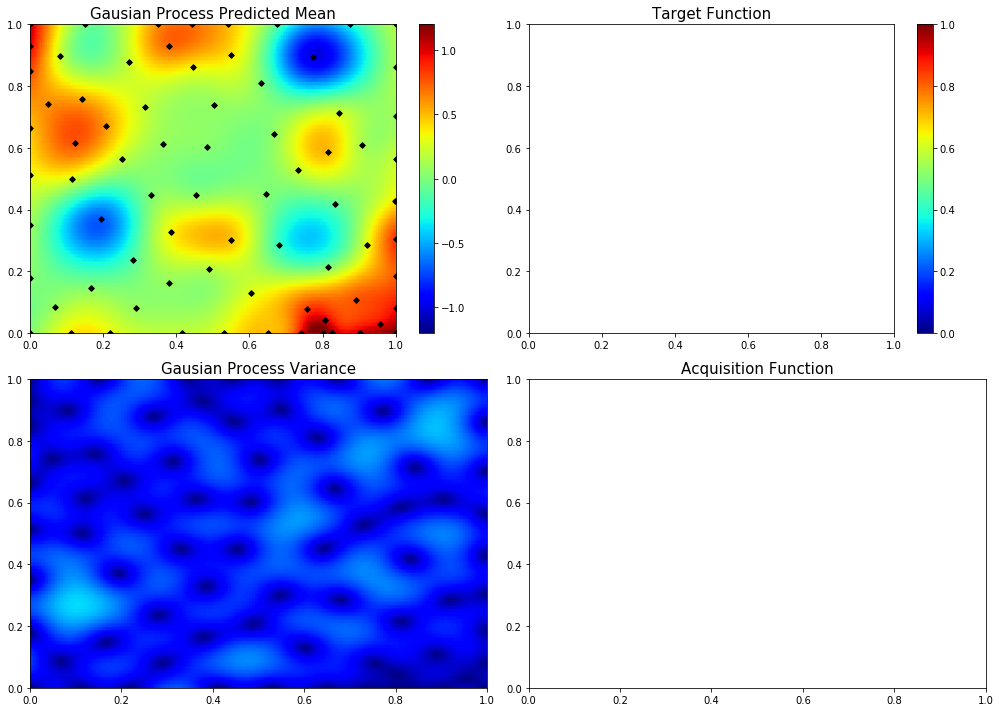

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6816597386609025, 0.10557782280842035]
30  Evaluations Remaining
|  76       |  0.6429   |  0.6817   |  0.1056   |
myplot:  076


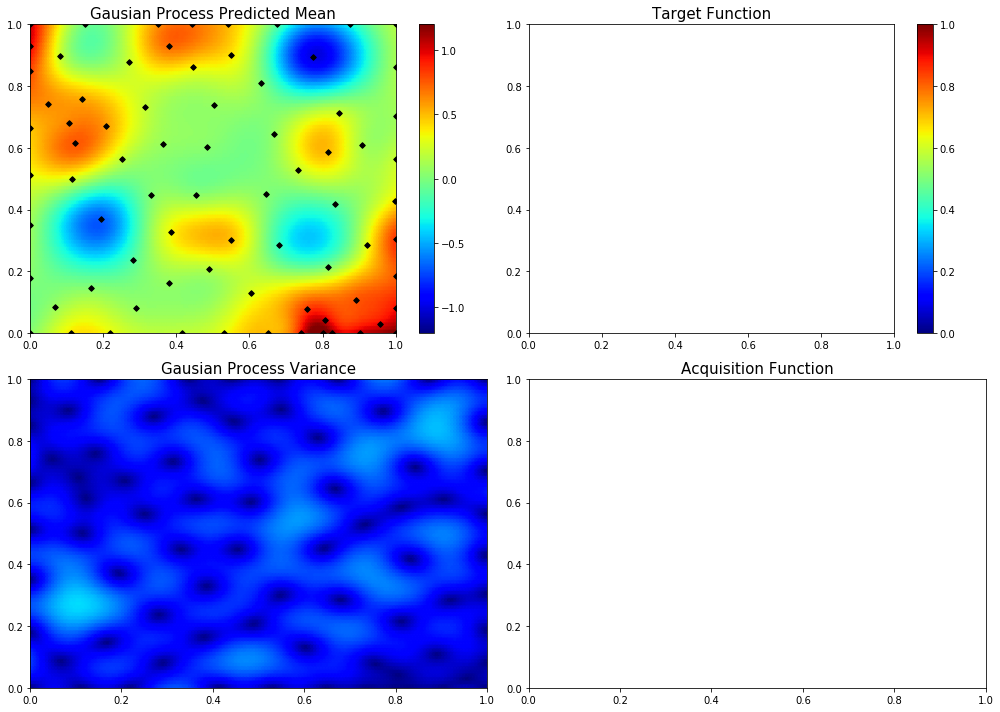

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2553140557699509, 0.08461140297946661]
29  Evaluations Remaining
|  77       | -0.4208   |  0.2553   |  0.08461  |
myplot:  077


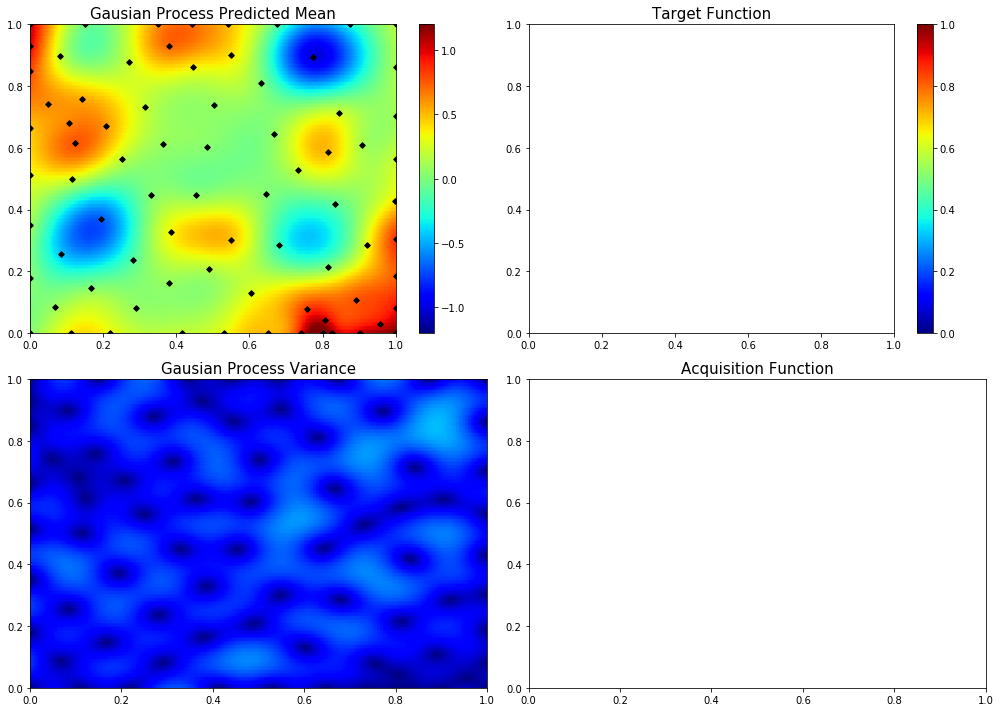

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6820719709363114, 0.7587057571390903]
28  Evaluations Remaining
|  78       |  0.467    |  0.6821   |  0.7587   |
myplot:  078


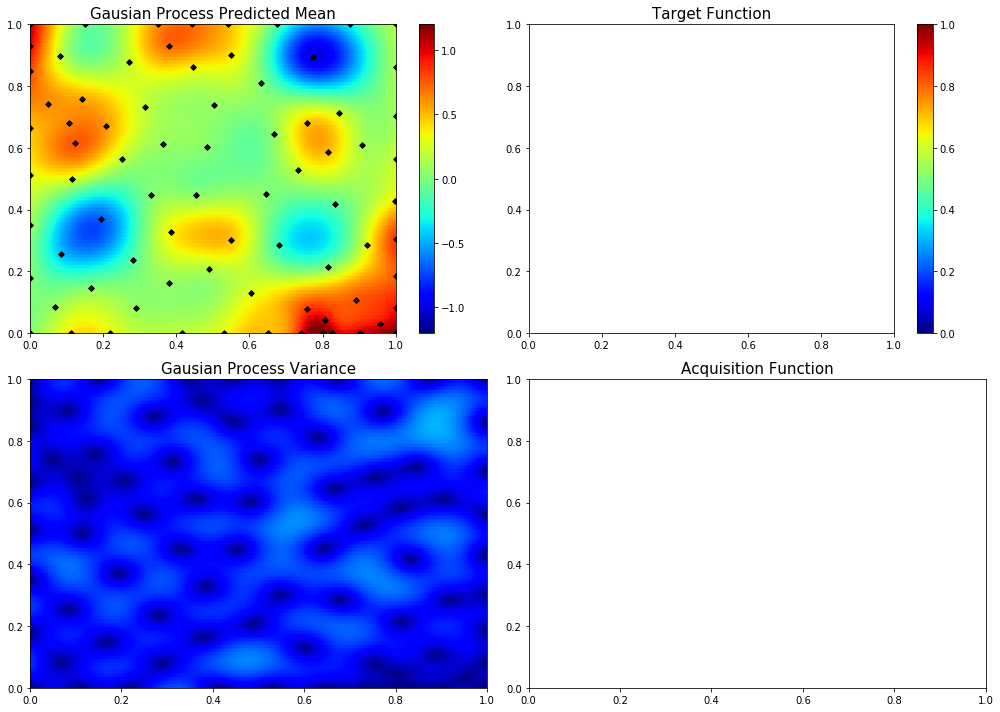

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.7841638262539168]
27  Evaluations Remaining
|  79       |  1.307    |  0.0      |  0.7842   |
myplot:  079


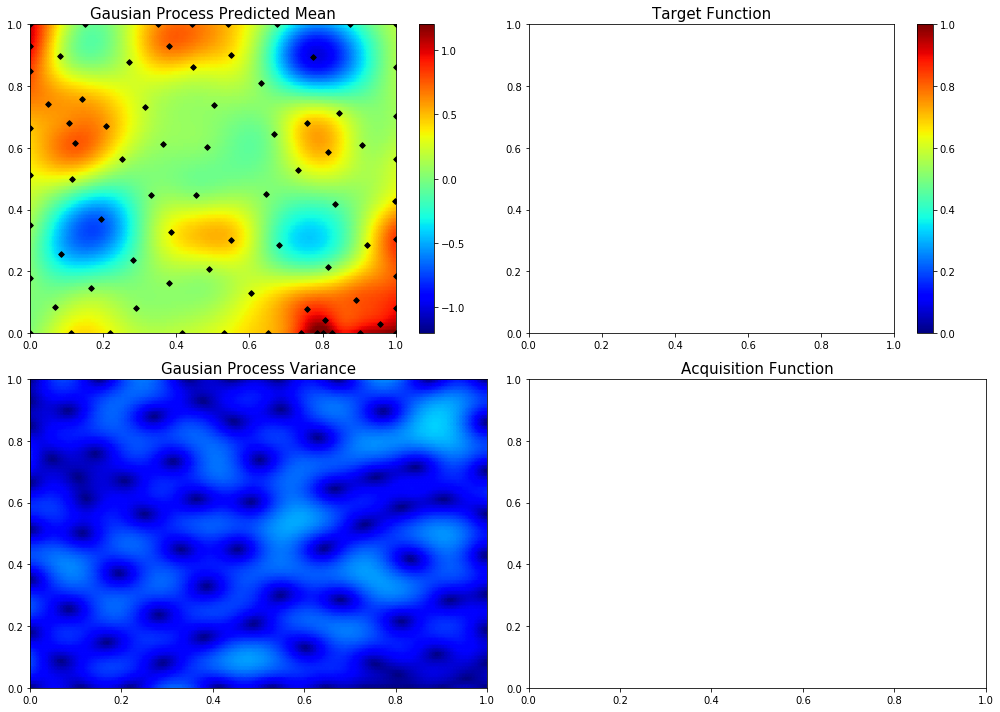

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0865573716611086, 0.48293512931318194]
26  Evaluations Remaining
|  80       |  0.1766   |  0.08656  |  0.4829   |
myplot:  080


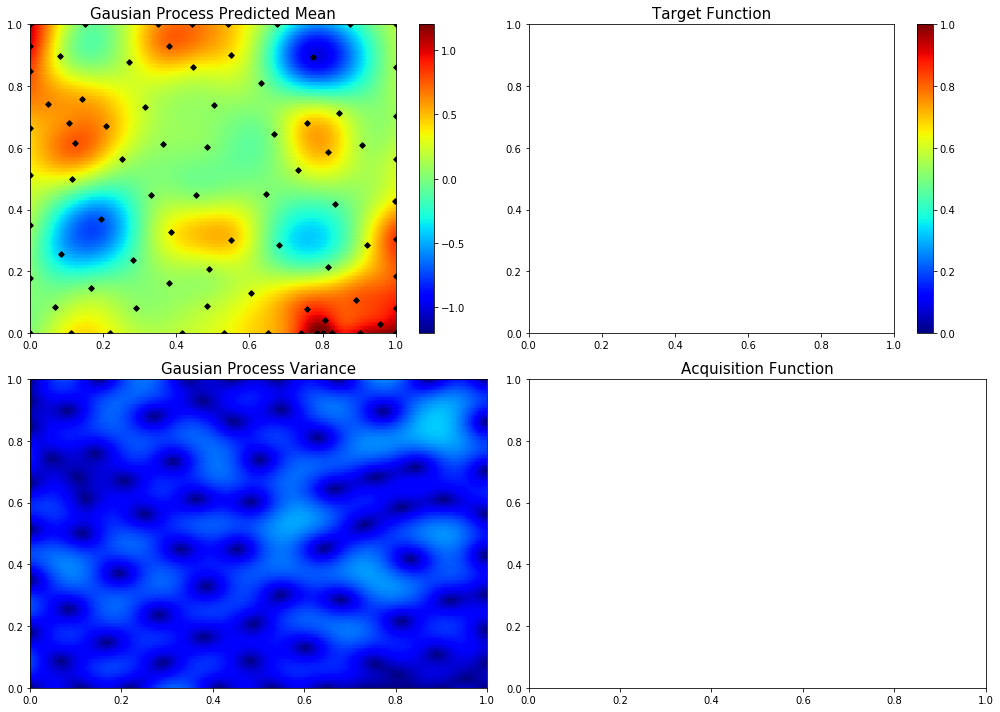

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3430996641489162, 0.4810881952078354]
25  Evaluations Remaining
|  81       |  0.525    |  0.3431   |  0.4811   |
myplot:  081


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\gaussian_process\gpr.py:480: ConvergenceWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([-6.27388604e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 54, 'nit': 4, 'warnflag': 2}
  ConvergenceWarning)


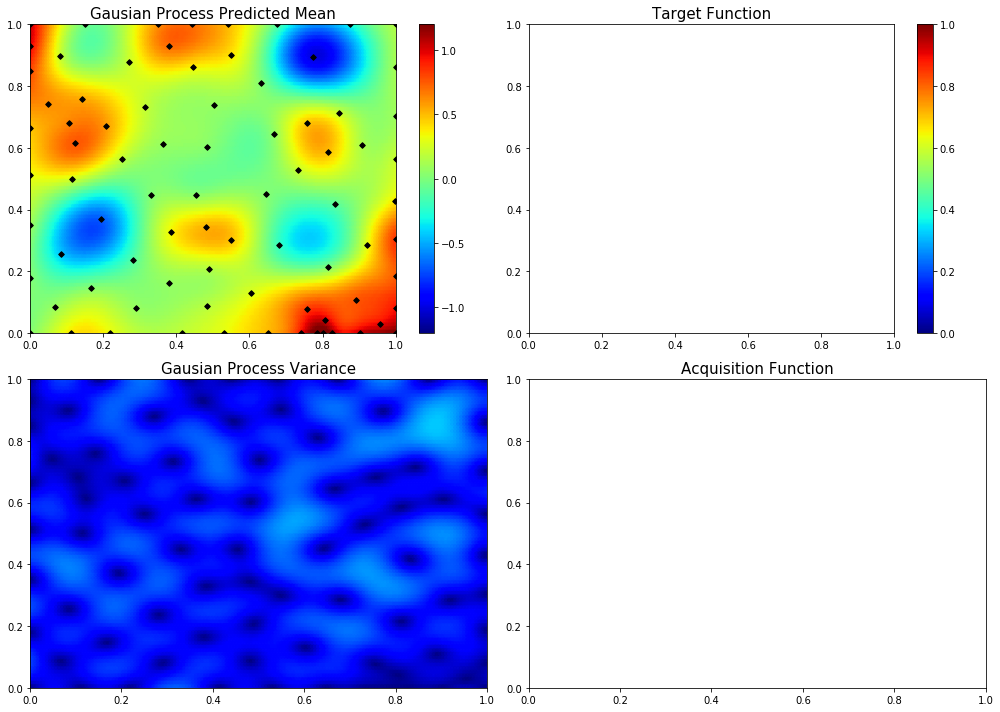

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.04865668212103765]
24  Evaluations Remaining
|  82       |  0.7772   |  1.0      |  0.04866  |
myplot:  082


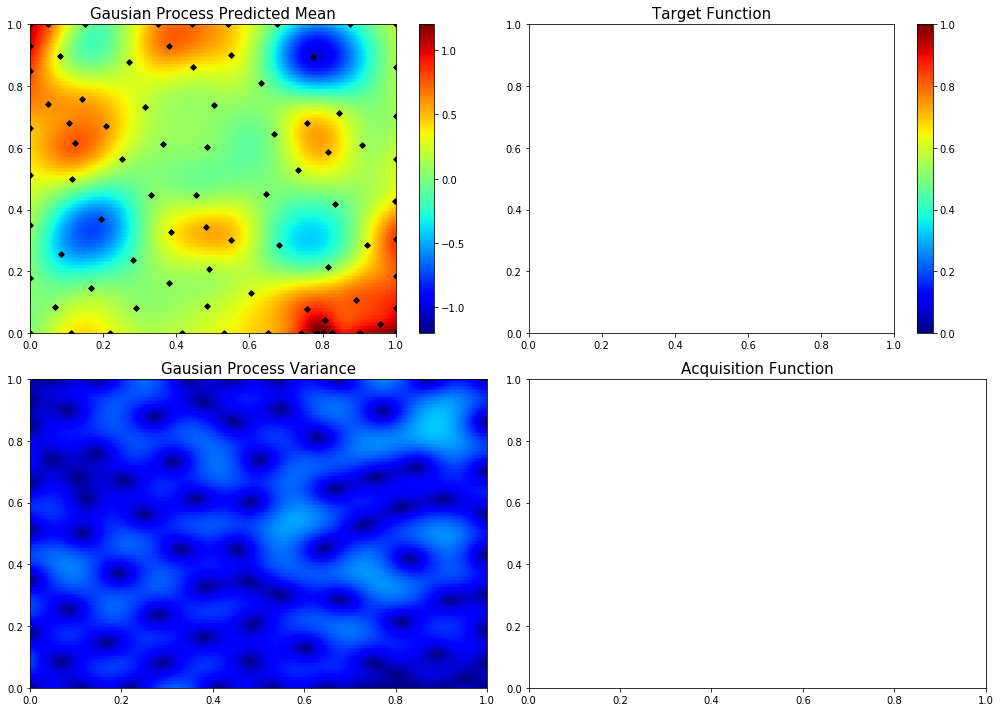

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.49987130382365474, 0.90357628846232]
23  Evaluations Remaining
|  83       |  0.1872   |  0.4999   |  0.9036   |
myplot:  083


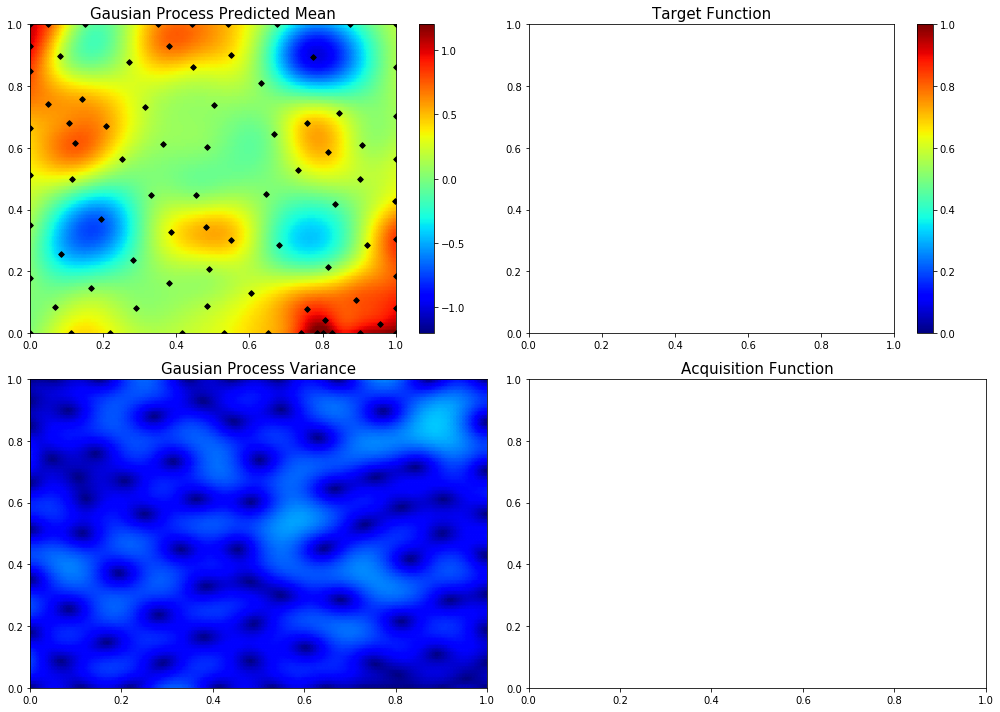

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.9602847452553881]
22  Evaluations Remaining
|  84       |  1.135    |  0.0      |  0.9603   |
myplot:  084


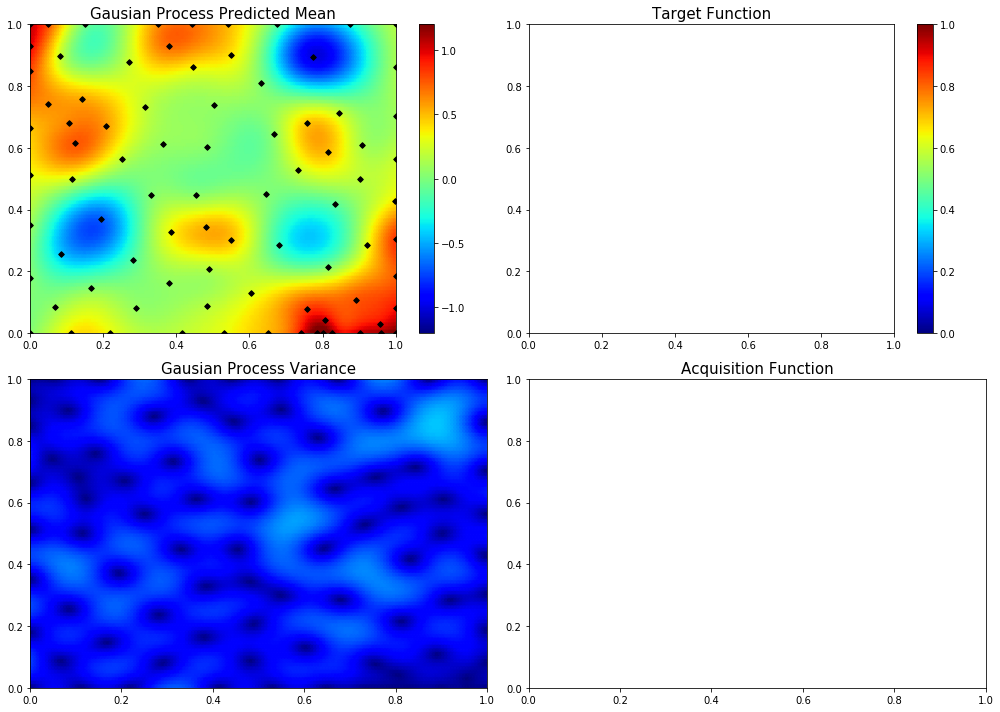

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5868767490576045, 0.05338904165390928]
21  Evaluations Remaining
|  85       |  0.4184   |  0.5869   |  0.05339  |
myplot:  085


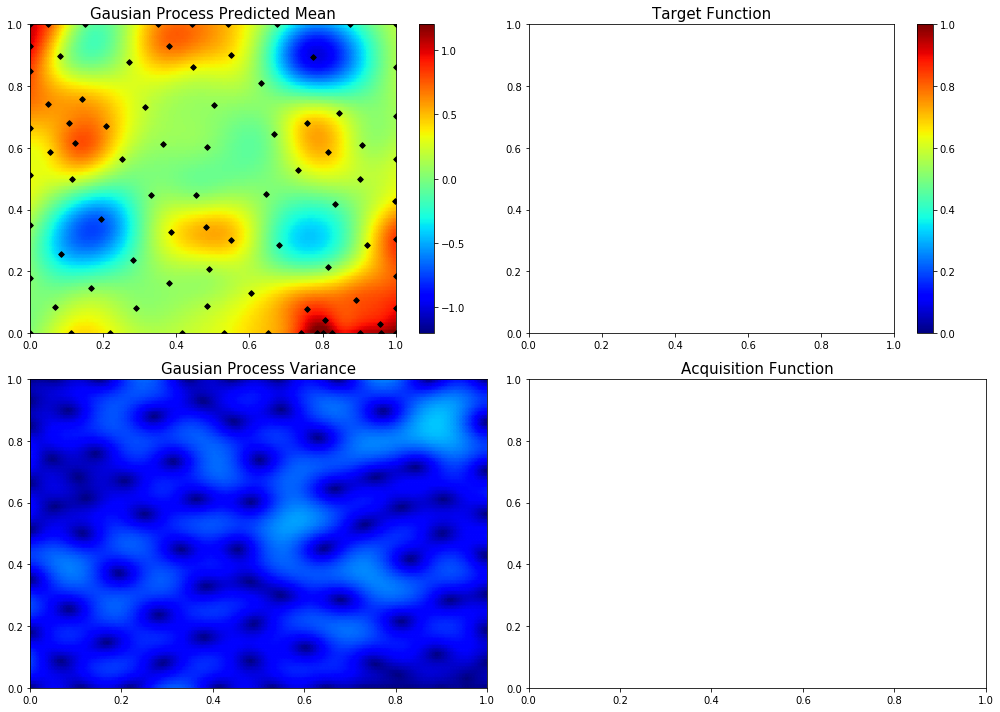

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7666276692812906, 0.0]
20  Evaluations Remaining
|  86       |  0.6436   |  0.7666   |  0.0      |
myplot:  086


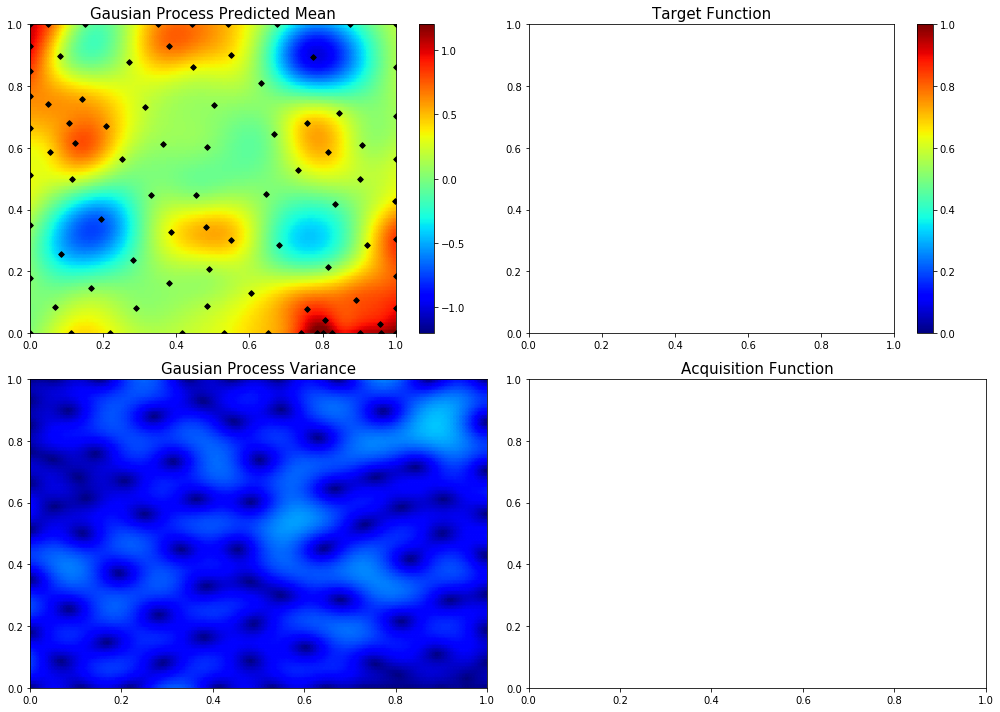

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.15482209656497967, 0.7050800028744348]
19  Evaluations Remaining
|  87       |  0.3301   |  0.1548   |  0.7051   |
myplot:  087


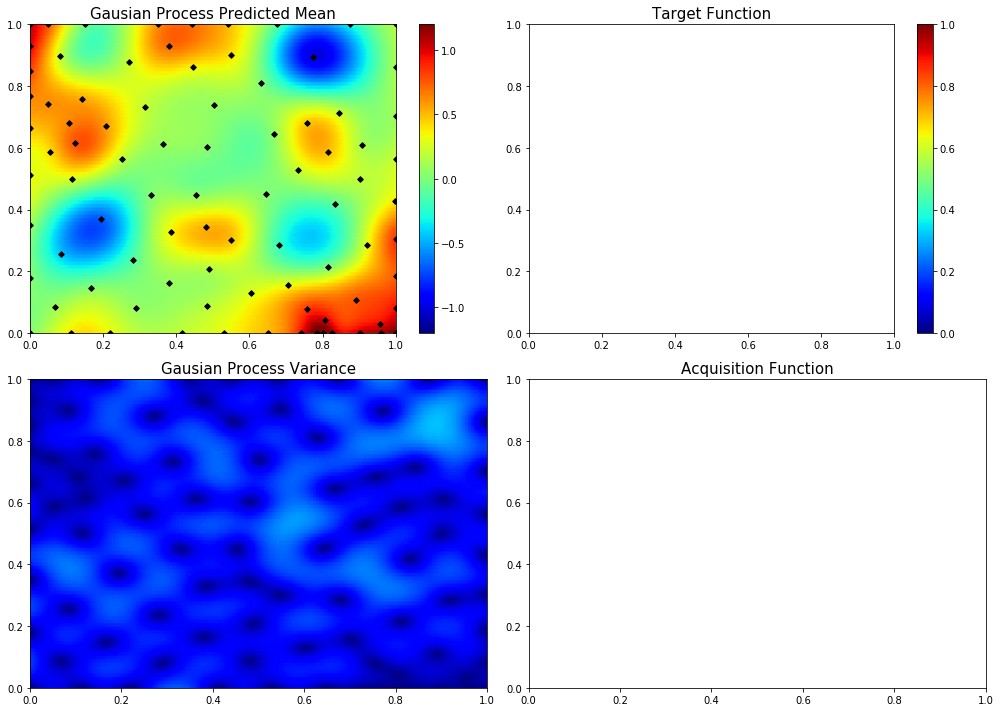

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1706165079266238, 0.932489997618711]
18  Evaluations Remaining
|  88       |  0.6156   |  0.1706   |  0.9325   |
myplot:  088


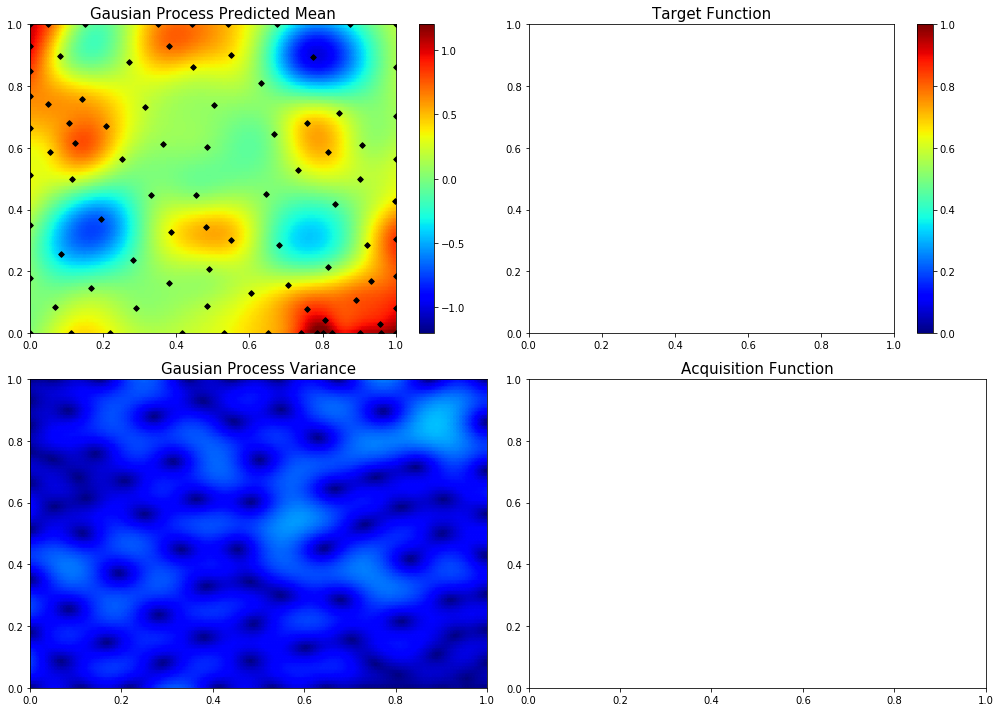

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0072846563690834275, 0.7955116111429418]
17  Evaluations Remaining
|  89       |  1.302    |  0.007285 |  0.7955   |
myplot:  089


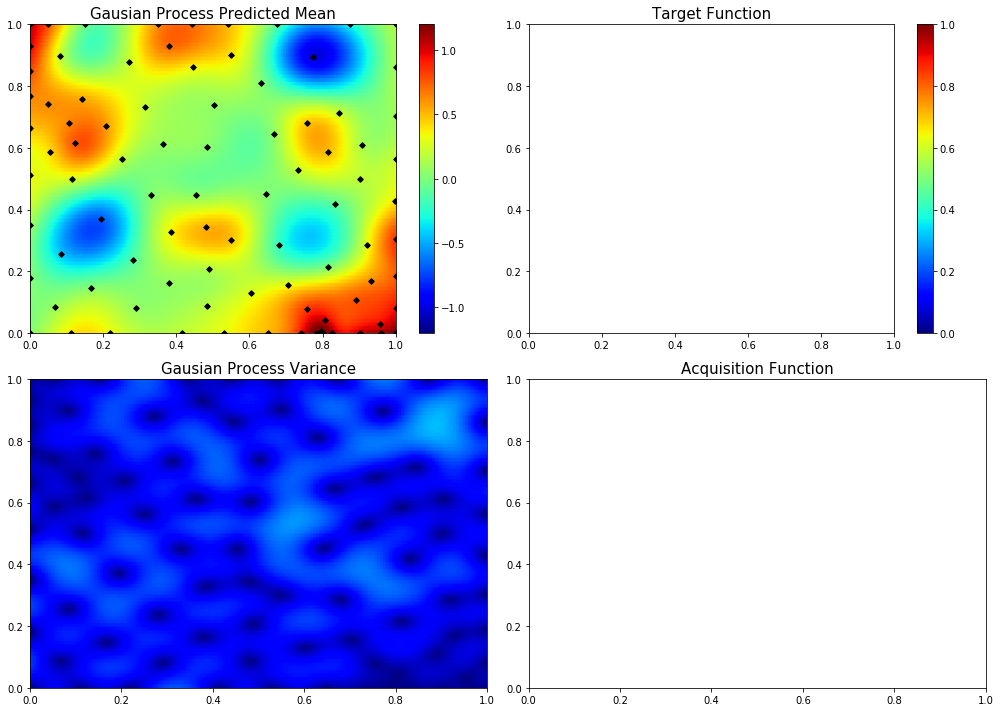

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.7964522494814581]
16  Evaluations Remaining
|  90       |  1.177    |  0.0      |  0.7965   |
myplot:  090


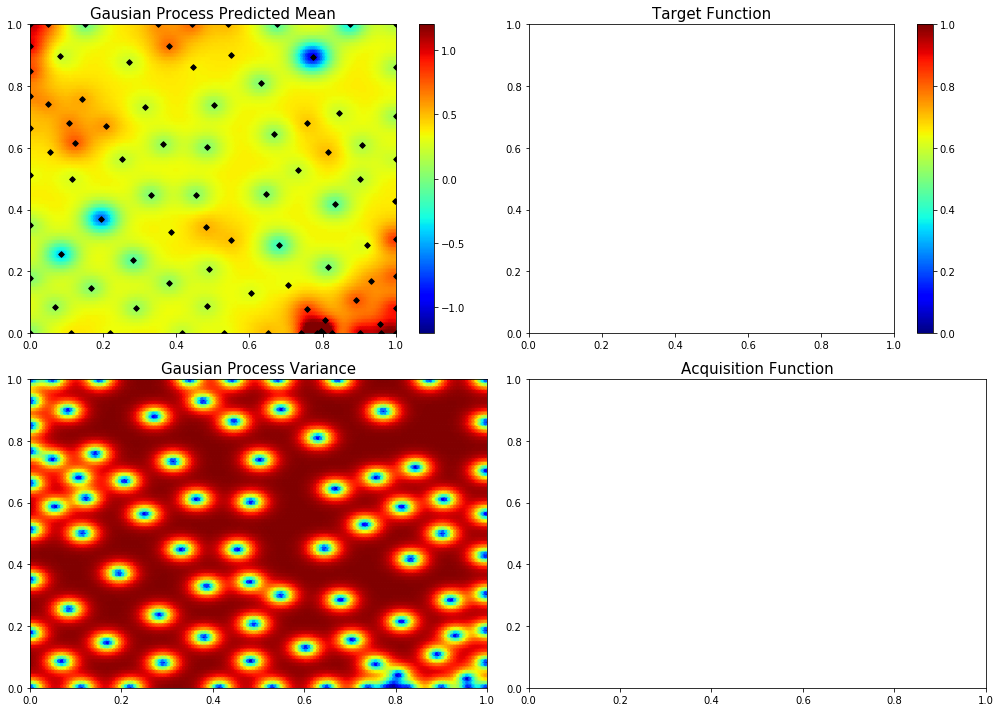

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.2630138560819204]
15  Evaluations Remaining
|  91       |  0.327    |  1.0      |  0.263    |
myplot:  091


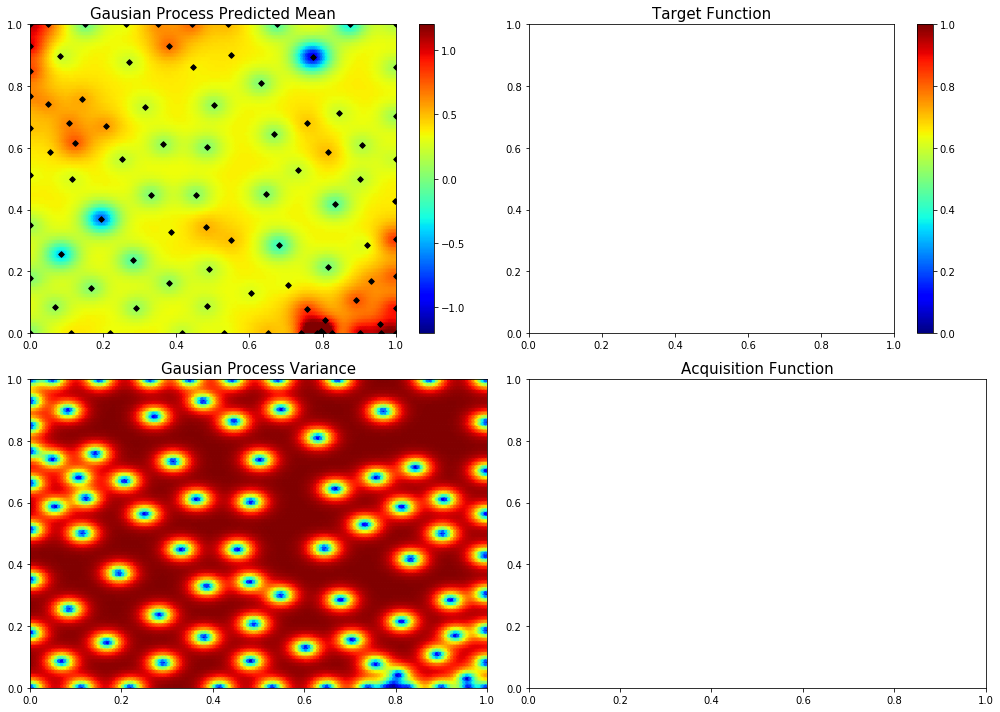

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8416597466754785, 0.17587525574772134]
14  Evaluations Remaining
|  92       |  0.07877  |  0.8417   |  0.1759   |
myplot:  092


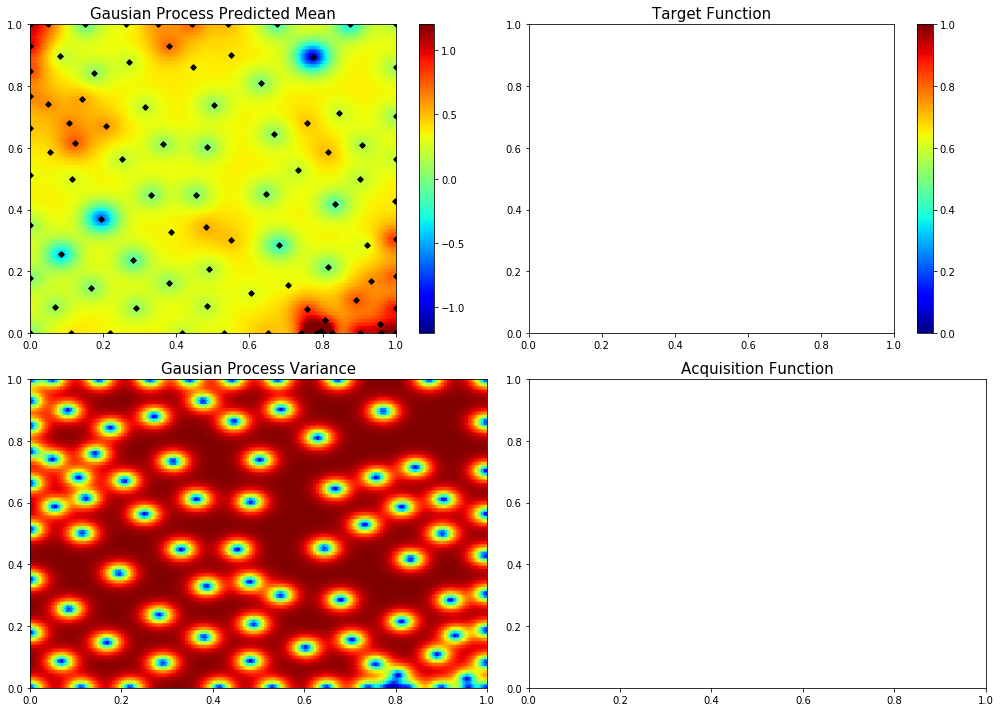

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8114563715459007, 0.8970181518348532]
13  Evaluations Remaining
|  93       | -0.03547  |  0.8115   |  0.897    |
myplot:  093


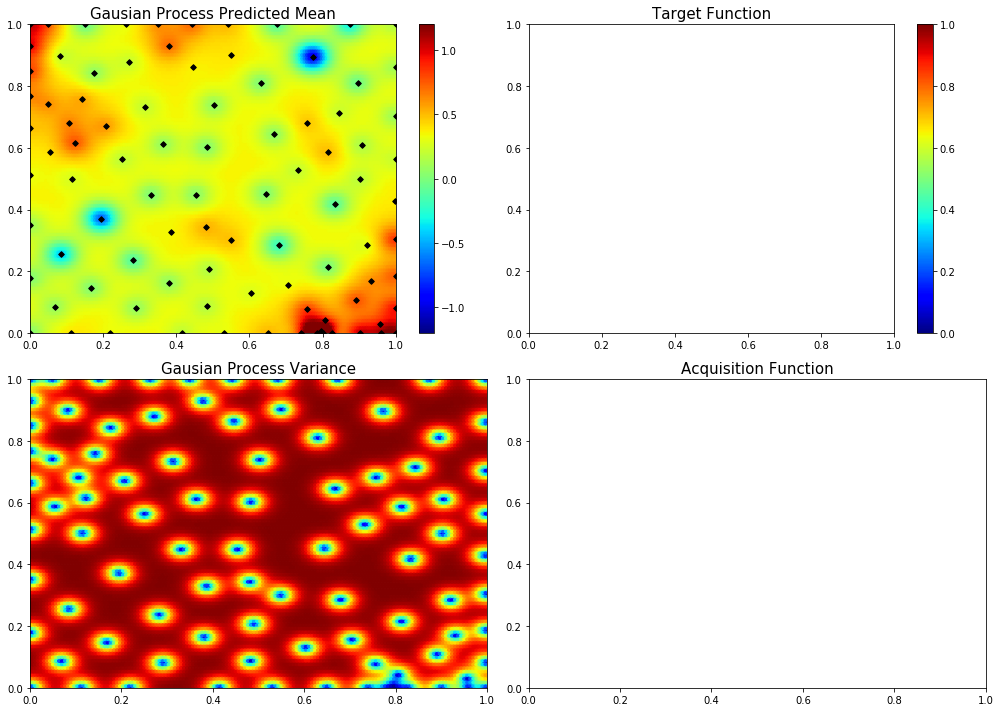

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8302490123162423, 0.35975744519837377]
12  Evaluations Remaining
|  94       |  0.2515   |  0.8302   |  0.3598   |
myplot:  094


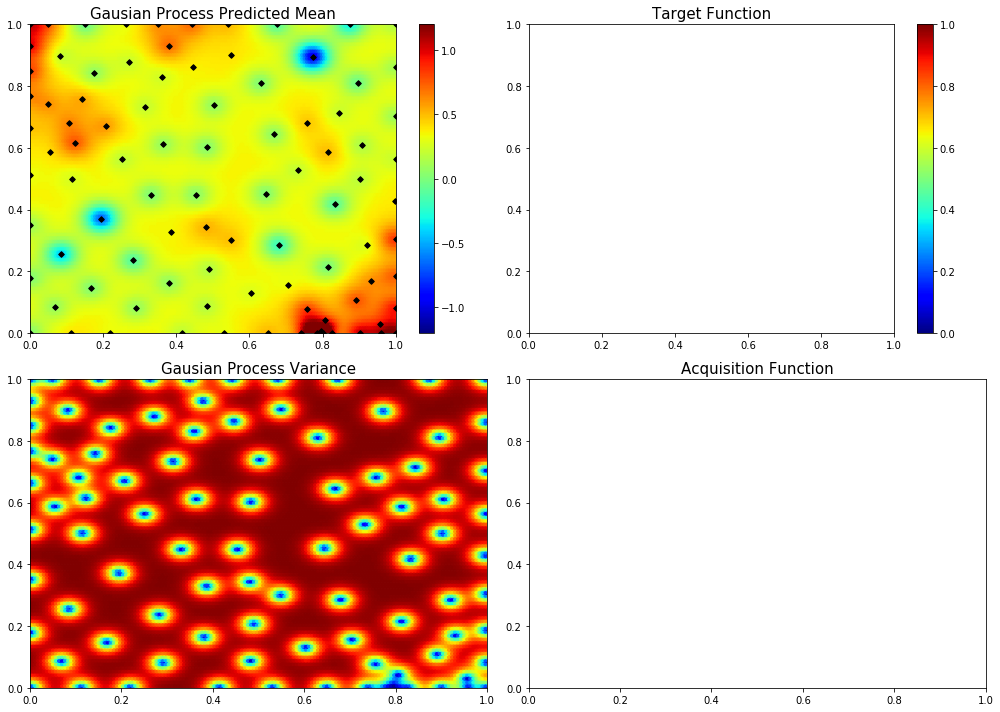

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5520876629773402, 0.5863713007169519]
11  Evaluations Remaining
|  95       |  0.01916  |  0.5521   |  0.5864   |
myplot:  095


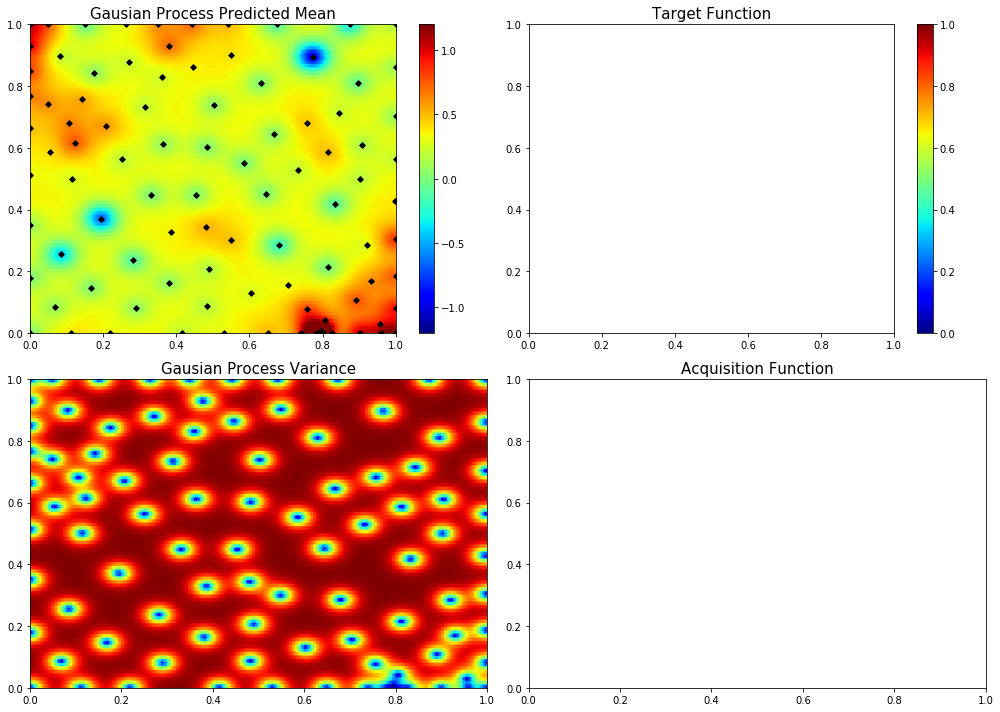

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3931783211550994, 0.557610914966773]
10  Evaluations Remaining
|  96       |  0.1636   |  0.3932   |  0.5576   |
myplot:  096


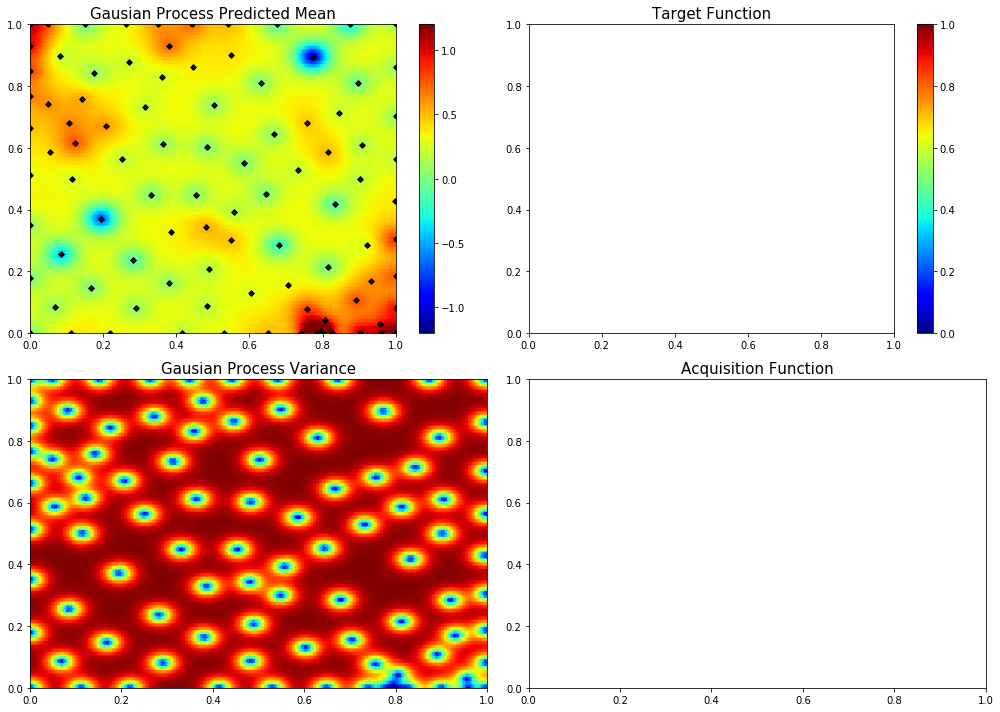

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.12387389637615392, 0.8171411836548946]
9  Evaluations Remaining
|  97       |  0.6741   |  0.1239   |  0.8171   |
myplot:  097


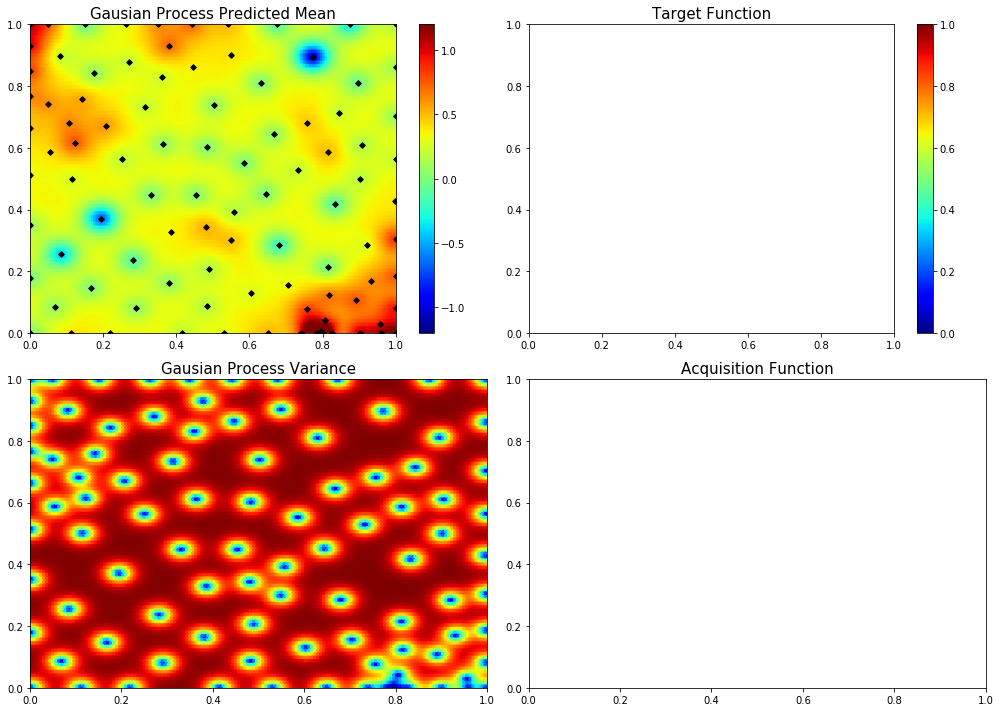

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7688346701099068, 0.7355556657806053]
8  Evaluations Remaining
|  98       |  0.04266  |  0.7688   |  0.7356   |
myplot:  098


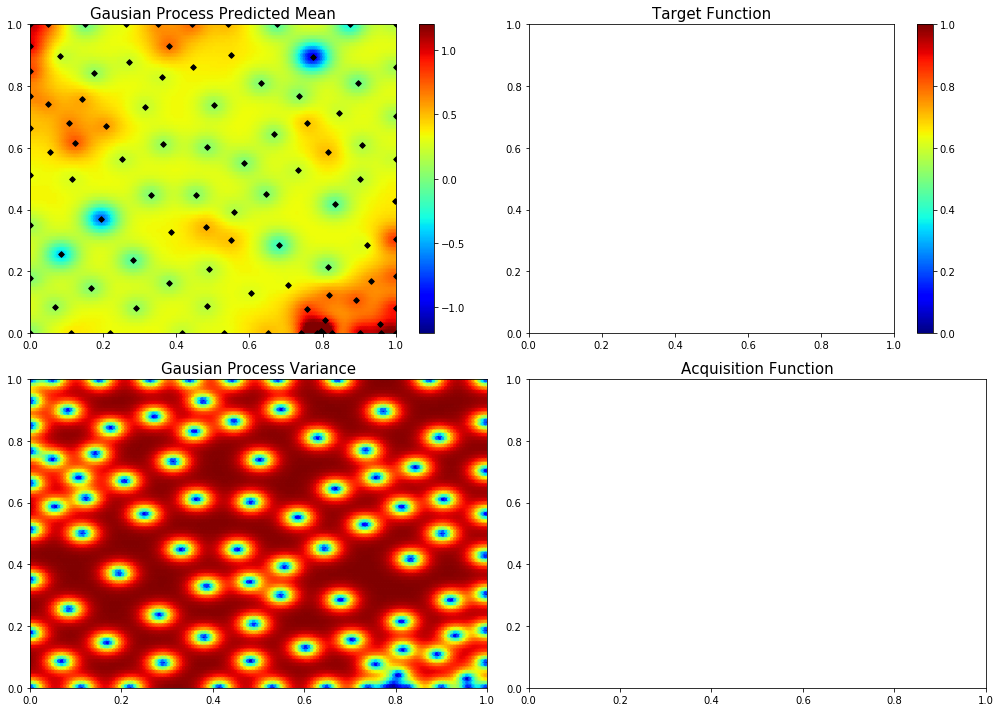

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3667682341190541, 0.9417902687632537]
7  Evaluations Remaining
|  99       |  0.3475   |  0.3668   |  0.9418   |
myplot:  099


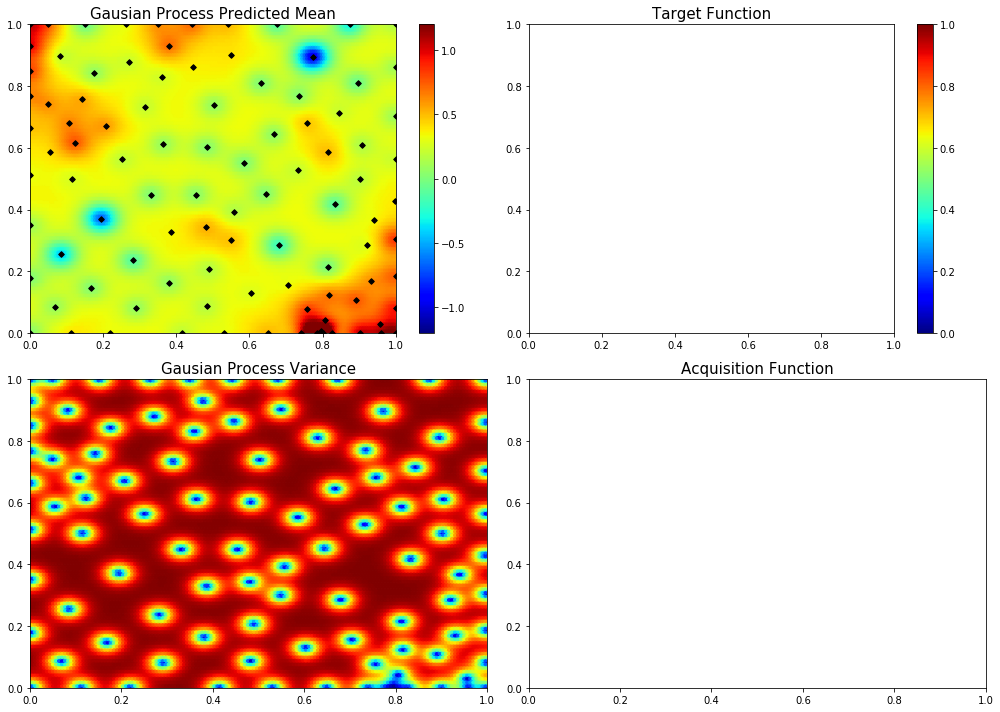

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8131384951629296, 0.07172438715889583]
6  Evaluations Remaining
|  100      |  0.4805   |  0.8131   |  0.07172  |
myplot:  100


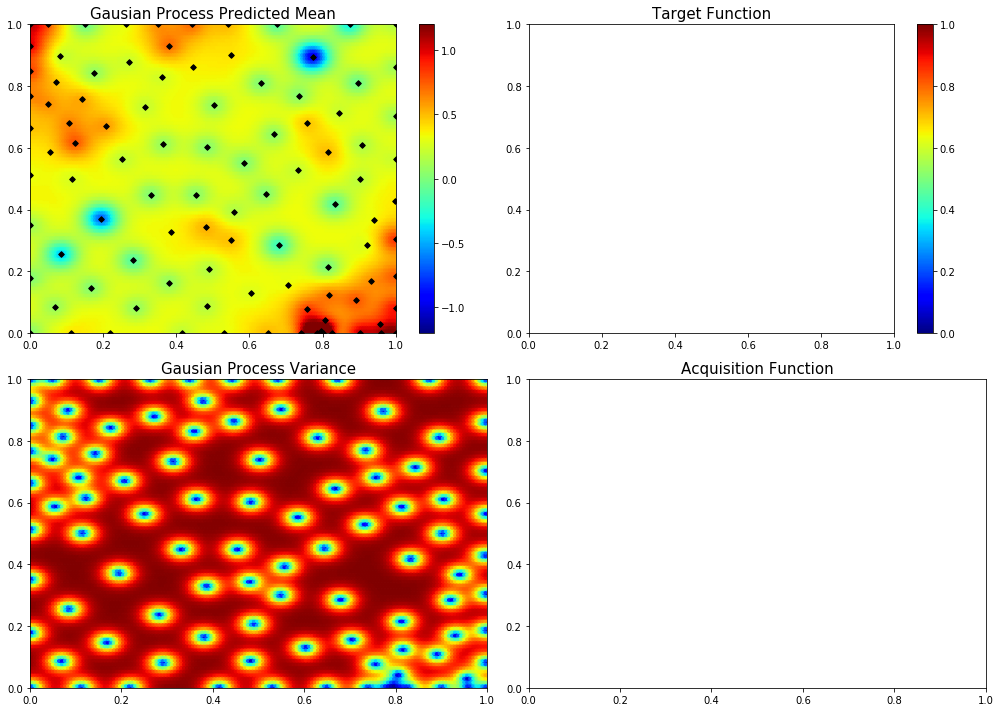

In [7]:
# Turn interactive plotting off
plt.ioff()

for i in range(95):
    bo.maximize(init_points=0, n_iter=1, acq='ucb', kappa=used_kappa)
    print("myplot: ", "{:03}".format(len(bo.space)) )
    plot_2d("{:03}".format(len(bo.space)))